# **Data Preparation**

In [3]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [4]:
#@title **Load Dataset**
line_a = "../Final Project/dataset-1"
location_reference = pd.read_csv(f'{line_a}/location_reference.csv')
product_reference = pd.read_csv(f'{line_a}/product_reference.csv', sep=";")
a3 = pd.read_csv(f'{line_a}/user.csv')

In [5]:
#@title **Dataset Configuration - Location Dataset**
location_reference

,nama provinsi,kode provinsi,nama kabupaten,kode kabupaten,nama kecamatan,kode kecamatan
0,GORONTALO,75,BOALEMO,7502,BOTUMOITO,750206
1,GORONTALO,75,BOALEMO,7502,DULUPI,750203
2,GORONTALO,75,BOALEMO,7502,MANANGGU,750205
3,GORONTALO,75,BOALEMO,7502,PAGUYAMAN,750201
4,GORONTALO,75,BOALEMO,7502,PAGUYAMAN PANTAI,750207
...,...,...,...,...,...,...
7402,SUMATERA UTARA,12,TOBA,1212,SIANTAR NARUMONDA,121220
7403,SUMATERA UTARA,12,TOBA,1212,SIGUMPAR,121219
7404,SUMATERA UTARA,12,TOBA,1212,SILAEN,121203
7405,SUMATERA UTARA,12,TOBA,1212,TAMPAHAN,121222


In [6]:
# nilai yang akan digunakan sebagai kriteria pemfilteran
daftar_nilai = [31, 32, 33, 34, 35, 36]

# Memfilter location_reference berdasarkan nilai yang ada di kolom 'kode provinsi',
# hanya menyertakan baris-baris yang memiliki nilai di dalam daftar nilai
location_reference = location_reference[location_reference['kode provinsi'].isin(daftar_nilai)]

# Menghapus kolom 'kode kabupaten' dan 'kode provinsi' dari DataFrame
location_reference.drop(columns=['kode kabupaten','kode provinsi'], inplace=True)
location_reference

,nama provinsi,nama kabupaten,nama kecamatan,kode kecamatan
77,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,BAMBANGLIPURO,340205
78,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,BANGUNTAPAN,340212
79,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,BANTUL,340208
80,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,DLINGO,340211
81,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,IMOGIRI,340210
...,...,...,...,...
6947,JAWA TIMUR,TULUNGAGUNG,REJOTANGAN,350413
6948,JAWA TIMUR,TULUNGAGUNG,SENDANG,350407
6949,JAWA TIMUR,TULUNGAGUNG,SUMBERGEMPOL,350410
6950,JAWA TIMUR,TULUNGAGUNG,TANGGUNGGUNUNG,350419


In [7]:
# DataFrame yang akan diubah nama kolomnya
location_reference.rename(columns = {'kode kecamatan':'loc_id'}, inplace = True)
location_reference

,nama provinsi,nama kabupaten,nama kecamatan,loc_id
77,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,BAMBANGLIPURO,340205
78,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,BANGUNTAPAN,340212
79,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,BANTUL,340208
80,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,DLINGO,340211
81,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,IMOGIRI,340210
...,...,...,...,...
6947,JAWA TIMUR,TULUNGAGUNG,REJOTANGAN,350413
6948,JAWA TIMUR,TULUNGAGUNG,SENDANG,350407
6949,JAWA TIMUR,TULUNGAGUNG,SUMBERGEMPOL,350410
6950,JAWA TIMUR,TULUNGAGUNG,TANGGUNGGUNUNG,350419


In [8]:
# untuk mengetahui informasi ringkas tentang DataFrame
location_reference.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2146 entries, 77 to 6951
Data columns (total 4 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   nama provinsi   2146 non-null   object
 1   nama kabupaten  2146 non-null   object
 2   nama kecamatan  2146 non-null   object
 3   loc_id          2146 non-null   object
dtypes: object(4)
memory usage: 83.8+ KB


In [9]:
#@title **Dataset Configuration - Product Dataset**

# memanggil dataframe product_reference
product_reference

,id,product name
0,1,Man Fashion
1,2,Woman Fashion
2,3,Food & Drink
3,4,Ride Hailing
4,5,Keperluan Rumah Tangga
5,6,Travel
6,7,Keperluan Anak
7,8,Elektronik
8,9,Other
9,10,"Transportasi (Kereta, Pesawat, Kapal)"


In [10]:
# mengubah kolom 'id' menjadi 'product_id'.
product_reference.rename(columns = {'id':'product_id'}, inplace = True)

In [11]:
#@title **Dataset Configuration - Transaction History Dataset**
line_b = f"{line_a}/trx"

# Membuat sebuah list kosong yang akan digunakan untuk menyimpan DataFrame
data_list_a = []

#  Melakukan iterasi melalui setiap file di direktori yang ditentukan oleh variabel line_b.
for filename in os.listdir(line_b):
    data_frame = pd.read_csv(os.path.join(line_b, filename))
    data_list_a.append(data_frame)

# Menggabungkan semua DataFrame
combined_data_a = pd.concat(data_list_a)
combined_data_a

,id,user_id,product_id,gross_amount,discounts,transaction_date
0,TRX653289,SC3402052002003,1,15100.0,NaN,2024-06-09
1,TRX653290,SC3402052002003,1,17900.0,NaN,2024-06-03
2,TRX653291,SC3402052002003,1,10100.0,2000.0,2024-10-08
3,TRX653292,SC3402052002003,1,16900.0,8000.0,2024-10-09
4,TRX653293,SC3402052002003,2,10500.0,NaN,2024-01-08
...,...,...,...,...,...,...
431520,TRX902168,SC3603031001042,15,26700.0,20000.0,2024-06-12
431521,TRX902169,SC3603031001042,16,10900.0,NaN,2024-09-28
431522,TRX902170,SC3603031001042,16,9100.0,NaN,2024-07-08
431523,TRX902171,SC3603031001042,17,15200.0,NaN,2024-08-07


In [12]:
# Membuat variabel string bernama line_c yang berisi path ke sebuah direktori
line_c = f"{line_a}/un-trx"

# Membuat list kosong bernama data_list_b untuk menyimpan dataframe dari file CSV dari direktori tersebut
data_list_b = []

# Membuat fungsi untuk menambahkan dataframe yang dipanggil oleh line_c ke variabel  data_list_b
for filename in os.listdir(line_c):
    data_frame = pd.read_csv(os.path.join(line_c, filename))
    data_list_b.append(data_frame)

# Menggabungkan semua dataframe pada variabel data_list_b menjadi satu df tunggal dengan nama combined_data_b
combined_data_b = pd.concat(data_list_b)

# Mencetak df combined_data_b
combined_data_b

,user_id,product_id,transactions,discounts,transaction_date
0,3101021003002,1,13.79,0.0,2024-08-17
1,3101021003002,1,15.21,7.0,2024-12-25
2,3101021003002,2,16.26,0.0,2024-08-08
3,3101021003002,2,12.74,7.0,2024-05-17
4,3101021003002,3,5.73,0.0,2024-06-17
...,...,...,...,...,...
2261191,3504011002014,16,0.00,0.0,2024-09-11
2261192,3504011002014,17,1.24,0.0,2024-08-26
2261193,3504011002014,17,0.48,0.0,2024-02-25
2261194,3504011002014,17,4.43,0.0,2024-10-19


**Dari Dataset Riwayat Transaksi yang diberikan ditemukan anomali **

In [13]:
# Menghapus kolom id dari df combined_data_a
combined_data_a.drop(columns='id', inplace=True)

In [14]:
# Mengonversi tipe data dari kolom 'user_id' di df combined_data_b menjadi string
combined_data_b['user_id'] = combined_data_b['user_id'].astype(str)

In [15]:
# Menambahkan prefiks "SC" ke setiap nilai di kolom 'user_id'
combined_data_b['user_id'] = "SC" + combined_data_b['user_id']

# Mengonversi nilai pada kolom transaksi ke satuan rupiah (kurs: 15.000 rupiah/...)
combined_data_b['transactions'] = combined_data_b['transactions']*15000

# Mengonversi nilai pada kolom diskon ke satuan rupiah (kurs: 15.000 rupiah/...)
combined_data_b['discounts'] = combined_data_b['discounts']*15000

In [16]:
# Mengganti nama kolom transactions menjadi gross_amount
combined_data_b.rename(columns = {'transactions':'gross_amount'}, inplace = True)

In [17]:
# Mencetak df combined_data_b
combined_data_b

,user_id,product_id,gross_amount,discounts,transaction_date
0,SC3101021003002,1,206850.0,0.0,2024-08-17
1,SC3101021003002,1,228150.0,105000.0,2024-12-25
2,SC3101021003002,2,243900.0,0.0,2024-08-08
3,SC3101021003002,2,191100.0,105000.0,2024-05-17
4,SC3101021003002,3,85950.0,0.0,2024-06-17
...,...,...,...,...,...
2261191,SC3504011002014,16,0.0,0.0,2024-09-11
2261192,SC3504011002014,17,18600.0,0.0,2024-08-26
2261193,SC3504011002014,17,7200.0,0.0,2024-02-25
2261194,SC3504011002014,17,66450.0,0.0,2024-10-19


In [18]:
# Melakukan outer join pada df combined_data_a dan combined_data_b menjadi df history
history = combined_data_a.merge(combined_data_b, how='outer')

# Mencetak df history
history

,user_id,product_id,gross_amount,discounts,transaction_date
0,SC3101011001001,1,300.0,0.0,2024-09-01
1,SC3101011001001,1,14700.0,0.0,2024-02-16
2,SC3101011001001,2,268800.0,15000.0,2024-10-14
3,SC3101011001001,2,297450.0,0.0,2024-02-15
4,SC3101011001001,2,333750.0,0.0,2024-04-08
...,...,...,...,...,...
7184269,SC3674071006051,16,1300.0,NaN,2024-08-09
7184270,SC3674071006051,16,8100.0,NaN,2024-01-01
7184271,SC3674071006051,16,10100.0,NaN,2024-01-09
7184272,SC3674071006051,18,4200.0,NaN,2024-05-02


In [19]:
# Melakukan left join pada df history dan df product_reference
history = history.merge(product_reference,how='left', on='product_id')

# Mencetak df history
history

,user_id,product_id,gross_amount,discounts,transaction_date,product name
0,SC3101011001001,1,300.0,0.0,2024-09-01,Man Fashion
1,SC3101011001001,1,14700.0,0.0,2024-02-16,Man Fashion
2,SC3101011001001,2,268800.0,15000.0,2024-10-14,Woman Fashion
3,SC3101011001001,2,297450.0,0.0,2024-02-15,Woman Fashion
4,SC3101011001001,2,333750.0,0.0,2024-04-08,Woman Fashion
...,...,...,...,...,...,...
7184269,SC3674071006051,16,1300.0,NaN,2024-08-09,Sewa Motor/Mobil
7184270,SC3674071006051,16,8100.0,NaN,2024-01-01,Sewa Motor/Mobil
7184271,SC3674071006051,16,10100.0,NaN,2024-01-09,Sewa Motor/Mobil
7184272,SC3674071006051,18,4200.0,NaN,2024-05-02,"Tagihan (WIFI, PLN)"


In [20]:
# Mengisi missing values pada kolom discounts dengan 0
history['discounts'] = history['discounts'].fillna(0)
# Mencetak kolom history
history

,user_id,product_id,gross_amount,discounts,transaction_date,product name
0,SC3101011001001,1,300.0,0.0,2024-09-01,Man Fashion
1,SC3101011001001,1,14700.0,0.0,2024-02-16,Man Fashion
2,SC3101011001001,2,268800.0,15000.0,2024-10-14,Woman Fashion
3,SC3101011001001,2,297450.0,0.0,2024-02-15,Woman Fashion
4,SC3101011001001,2,333750.0,0.0,2024-04-08,Woman Fashion
...,...,...,...,...,...,...
7184269,SC3674071006051,16,1300.0,0.0,2024-08-09,Sewa Motor/Mobil
7184270,SC3674071006051,16,8100.0,0.0,2024-01-01,Sewa Motor/Mobil
7184271,SC3674071006051,16,10100.0,0.0,2024-01-09,Sewa Motor/Mobil
7184272,SC3674071006051,18,4200.0,0.0,2024-05-02,"Tagihan (WIFI, PLN)"


In [21]:
history.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7184274 entries, 0 to 7184273
Data columns (total 6 columns):
 #   Column            Dtype  
---  ------            -----  
 0   user_id           object 
 1   product_id        int64  
 2   gross_amount      float64
 3   discounts         float64
 4   transaction_date  object 
 5   product name      object 
dtypes: float64(2), int64(1), object(3)
memory usage: 328.9+ MB


In [22]:
#@title **Dataset Configuration - User Dataset**
a3

,id,full_name,gender,money_spent,refund,wallet_balance,join_date,birth
0,SC7502062007001,PRIYANTI FIORI,perempuan,2270000.0,130000.0,480000.0,2023-11-05,1984-07-25
1,SC7502062007002,KURNIA MUHAMAD WANIMBO,laki-laki,2370000.0,140000.0,500000.0,2023-12-27,1991-02-12
2,SC7502062007003,AJENG LESTARI,perempuan,0.0,0.0,0.0,2024-07-19,1982-06-18
3,SC7502062007004,TIA IRIANI S.E.,perempuan,0.0,0.0,0.0,2024-05-24,1972-09-27
4,SC7502062006001,ANCE,perempuan,0.0,0.0,0.0,2024-11-25,1992-06-11
...,...,...,...,...,...,...,...,...
427481,SC1212102018001,ACHMAD,laki-laki,1040000.0,60000.0,360000.0,2023-10-14,1982-10-20
427482,SC1212102018004,AJIE AHMAD Masykur,laki-laki,1510000.0,60000.0,550000.0,2023-12-04,1997-08-03
427483,SC1212102008001,WIWIN WAHYUNI,perempuan,2120000.0,100000.0,800000.0,2023-12-10,1978-12-17
427484,SC1212102010001,NYIMAS,perempuan,1700000.0,50000.0,490000.0,2023-10-18,1993-04-04


In [23]:
a3.rename(columns = {'id':'user_id'}, inplace = True)

In [24]:
user = a3.copy()
user['loc_id'] = user['user_id'].str.slice(2,8)
user = pd.merge(user, location_reference, on='loc_id',how='inner')
user.drop(columns='loc_id', inplace=True)
user

,user_id,full_name,gender,money_spent,refund,wallet_balance,join_date,birth,nama provinsi,nama kabupaten,nama kecamatan
0,SC3402052002003,ISDANIAR KHAFIYAH,perempuan,1790000.0,200000.0,450000.0,2023-10-30,2003-09-20,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,BAMBANGLIPURO
1,SC3402052002005,DEBBY ORINBAO,perempuan,1510000.0,300000.0,470000.0,2023-11-03,2005-02-28,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,BAMBANGLIPURO
2,SC3402052002007,MUHAMMAD WENEHEN WIRATA,laki-laki,2360000.0,130000.0,430000.0,2023-11-28,1996-07-21,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,BAMBANGLIPURO
3,SC3402052002009,GANINDA,perempuan,1770000.0,30000.0,190000.0,2023-11-01,1977-10-07,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,BAMBANGLIPURO
4,SC3402052002010,HARJOKO IHSAN S.Sos.,laki-laki,1630000.0,80000.0,190000.0,2023-12-08,2006-06-18,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,BAMBANGLIPURO
...,...,...,...,...,...,...,...,...,...,...,...
241644,SC3504011002009,dr. MEIVA SETIYANINGSIH,perempuan,2040000.0,270000.0,620000.0,2023-10-14,1973-06-08,JAWA TIMUR,TULUNGAGUNG,TULUNGAGUNG
241645,SC3504011002011,DIAN S.I.Kom.,perempuan,2160000.0,130000.0,440000.0,2023-12-06,1992-08-13,JAWA TIMUR,TULUNGAGUNG,TULUNGAGUNG
241646,SC3504011002012,SUSILAWATI,perempuan,1840000.0,200000.0,460000.0,2023-11-27,1975-08-08,JAWA TIMUR,TULUNGAGUNG,TULUNGAGUNG
241647,SC3504011002013,Dr. MARYANI NINDA S.P.,perempuan,1690000.0,190000.0,580000.0,2023-12-16,1993-04-28,JAWA TIMUR,TULUNGAGUNG,TULUNGAGUNG


In [25]:
pd.options.display.float_format = '{:,}'.format
user.describe()

,money_spent,refund,wallet_balance
count,"241,649.0","241,649.0","241,649.0"
mean,"1,855,797.3755322802","309,721.2899701633","626,239.2974934719"
std,"413,876.24368278304","55,476,654.86294467","2,632,006.368633109"
min,0.0,"-7,790,000.0","-9,550,000.0"
25%,"1,680,000.0","110,000.0","460,000.0"
50%,"1,910,000.0","180,000.0","610,000.0"
75%,"2,100,000.0","270,000.0","780,000.0"
max,"9,810,000.0","27,271,120,000.000004","1,280,390,000.0"


# **Feature Creation**

In [26]:
#@title **Usia**
import datetime
current_year = datetime.datetime.now().year
user['age'] = current_year - pd.to_datetime(user['birth']).dt.year

In [27]:
#@title **Kategori Usia**
bins = [0, 17, 25, 35, 45, 65, float('inf')]
labels = ['Anak-anak', 'Remaja', 'Dewasa Awal', 'Dewasa Tengah', 'Dewasa Akhir', 'Lansia']
user['age_group'] = pd.cut(user['age'], bins=bins, labels=labels, right=False)

In [28]:
#@title **Total user Membeli Macam-macam Kategori Barang**
user_product_counts = (
    history.groupby('user_id')['product name'].value_counts().unstack(fill_value=0)
)
new_column_names = product_reference['product name'].unique()
user = user.merge(user_product_counts, how='left', on='user_id')
# Just in case kalau ternyata beberapa user tidak melakukan transaksi di tahun ini untuk beberapa kategori barang
# user[new_column_names] = user[new_column_names].fillna(0)
user

,user_id,full_name,gender,money_spent,refund,wallet_balance,join_date,birth,nama provinsi,nama kabupaten,...,Other,Otomotif,Pulsa,Ride Hailing,Sewa Motor/Mobil,"Tagihan (WIFI, PLN)",Top Up Game,"Transportasi (Kereta, Pesawat, Kapal)",Travel,Woman Fashion
0,SC3402052002003,ISDANIAR KHAFIYAH,perempuan,"1,790,000.0","200,000.0","450,000.0",2023-10-30,2003-09-20,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,...,0.0,4.0,4.0,2.0,0.0,0.0,0.0,0.0,4.0,3.0
1,SC3402052002005,DEBBY ORINBAO,perempuan,"1,510,000.0","300,000.0","470,000.0",2023-11-03,2005-02-28,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,...,0.0,2.0,0.0,4.0,0.0,3.0,0.0,0.0,2.0,3.0
2,SC3402052002007,MUHAMMAD WENEHEN WIRATA,laki-laki,"2,360,000.0","130,000.0","430,000.0",2023-11-28,1996-07-21,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,...,0.0,3.0,3.0,3.0,0.0,4.0,0.0,0.0,0.0,3.0
3,SC3402052002009,GANINDA,perempuan,"1,770,000.0","30,000.0","190,000.0",2023-11-01,1977-10-07,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,...,0.0,4.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,4.0
4,SC3402052002010,HARJOKO IHSAN S.Sos.,laki-laki,"1,629,999.9999999998","80,000.0","190,000.0",2023-12-08,2006-06-18,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,...,0.0,2.0,0.0,3.0,0.0,3.0,0.0,0.0,0.0,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
241644,SC3504011002009,dr. MEIVA SETIYANINGSIH,perempuan,"2,040,000.0","270,000.0","620,000.0",2023-10-14,1973-06-08,JAWA TIMUR,TULUNGAGUNG,...,0.0,4.0,0.0,4.0,0.0,4.0,4.0,0.0,0.0,4.0
241645,SC3504011002011,DIAN S.I.Kom.,perempuan,"2,160,000.0","130,000.0","440,000.0",2023-12-06,1992-08-13,JAWA TIMUR,TULUNGAGUNG,...,3.0,2.0,0.0,3.0,3.0,0.0,0.0,4.0,0.0,2.0
241646,SC3504011002012,SUSILAWATI,perempuan,"1,840,000.0","200,000.0","460,000.0",2023-11-27,1975-08-08,JAWA TIMUR,TULUNGAGUNG,...,0.0,2.0,0.0,2.0,3.0,0.0,0.0,0.0,2.0,3.0
241647,SC3504011002013,Dr. MARYANI NINDA S.P.,perempuan,"1,689,999.9999999998","190,000.0","580,000.0",2023-12-16,1993-04-28,JAWA TIMUR,TULUNGAGUNG,...,0.0,4.0,0.0,3.0,3.0,3.0,0.0,0.0,4.0,4.0


In [29]:
#@title **Total user Membeli seluruh Kategori Barang**
columns_to_total = user.columns[13:30]
user['total transactions'] = user[columns_to_total].sum(axis=1)
user

,user_id,full_name,gender,money_spent,refund,wallet_balance,join_date,birth,nama provinsi,nama kabupaten,...,Otomotif,Pulsa,Ride Hailing,Sewa Motor/Mobil,"Tagihan (WIFI, PLN)",Top Up Game,"Transportasi (Kereta, Pesawat, Kapal)",Travel,Woman Fashion,total transactions
0,SC3402052002003,ISDANIAR KHAFIYAH,perempuan,"1,790,000.0","200,000.0","450,000.0",2023-10-30,2003-09-20,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,...,4.0,4.0,2.0,0.0,0.0,0.0,0.0,4.0,3.0,32.0
1,SC3402052002005,DEBBY ORINBAO,perempuan,"1,510,000.0","300,000.0","470,000.0",2023-11-03,2005-02-28,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,...,2.0,0.0,4.0,0.0,3.0,0.0,0.0,2.0,3.0,28.0
2,SC3402052002007,MUHAMMAD WENEHEN WIRATA,laki-laki,"2,360,000.0","130,000.0","430,000.0",2023-11-28,1996-07-21,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,...,3.0,3.0,3.0,0.0,4.0,0.0,0.0,0.0,3.0,35.0
3,SC3402052002009,GANINDA,perempuan,"1,770,000.0","30,000.0","190,000.0",2023-11-01,1977-10-07,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,...,4.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,4.0,25.0
4,SC3402052002010,HARJOKO IHSAN S.Sos.,laki-laki,"1,629,999.9999999998","80,000.0","190,000.0",2023-12-08,2006-06-18,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,...,2.0,0.0,3.0,0.0,3.0,0.0,0.0,0.0,3.0,20.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
241644,SC3504011002009,dr. MEIVA SETIYANINGSIH,perempuan,"2,040,000.0","270,000.0","620,000.0",2023-10-14,1973-06-08,JAWA TIMUR,TULUNGAGUNG,...,4.0,0.0,4.0,0.0,4.0,4.0,0.0,0.0,4.0,40.0
241645,SC3504011002011,DIAN S.I.Kom.,perempuan,"2,160,000.0","130,000.0","440,000.0",2023-12-06,1992-08-13,JAWA TIMUR,TULUNGAGUNG,...,2.0,0.0,3.0,3.0,0.0,0.0,4.0,0.0,2.0,42.0
241646,SC3504011002012,SUSILAWATI,perempuan,"1,840,000.0","200,000.0","460,000.0",2023-11-27,1975-08-08,JAWA TIMUR,TULUNGAGUNG,...,2.0,0.0,2.0,3.0,0.0,0.0,0.0,2.0,3.0,30.0
241647,SC3504011002013,Dr. MARYANI NINDA S.P.,perempuan,"1,689,999.9999999998","190,000.0","580,000.0",2023-12-16,1993-04-28,JAWA TIMUR,TULUNGAGUNG,...,4.0,0.0,3.0,3.0,3.0,0.0,0.0,4.0,4.0,32.0


# **Exploratory Data Analysis**

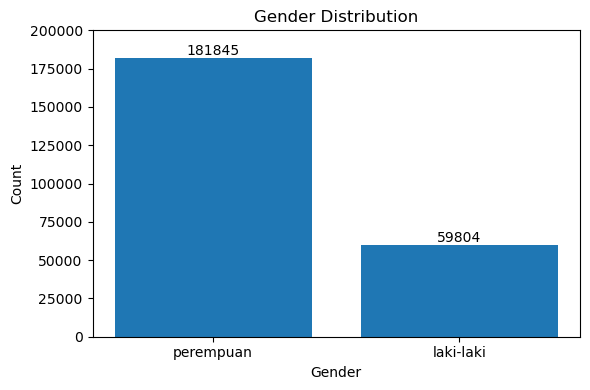

In [30]:
#@title **Gender Distribution**
plt.figure(figsize=(6, 4))

plt.bar(user['gender'].unique(), user['gender'].value_counts())
plt.ylim(0,200000)
plt.xlabel('Gender')
plt.ylabel('Count')
plt.title('Gender Distribution')

for i, count in enumerate(user['gender'].value_counts()):
    plt.text(i, count + 0.1, f'{count}', ha='center', va='bottom')

plt.tight_layout()
plt.show()


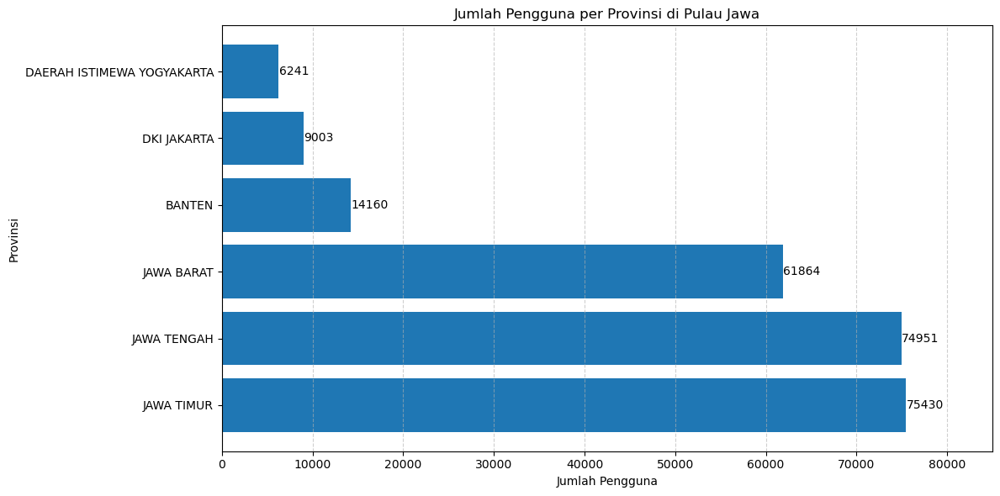

In [31]:
#@title **Jumlah Pengguna**
asprov = user.groupby('nama provinsi')['user_id'].nunique().sort_values(ascending=False)
plt.figure(figsize=(12, 6))
plt.barh(asprov.index, asprov.values)

plt.xlim(0,85000)
plt.xlabel('Jumlah Pengguna')
plt.ylabel('Provinsi')
plt.title('Jumlah Pengguna per Provinsi di Pulau Jawa')

plt.grid(axis='x', linestyle='--', alpha=0.6)


for i, v in enumerate(asprov.values):
    plt.annotate(f"{v}", xy=(v + 50, i), ha='left', va='center', fontsize=10)

plt.tight_layout()
plt.show()

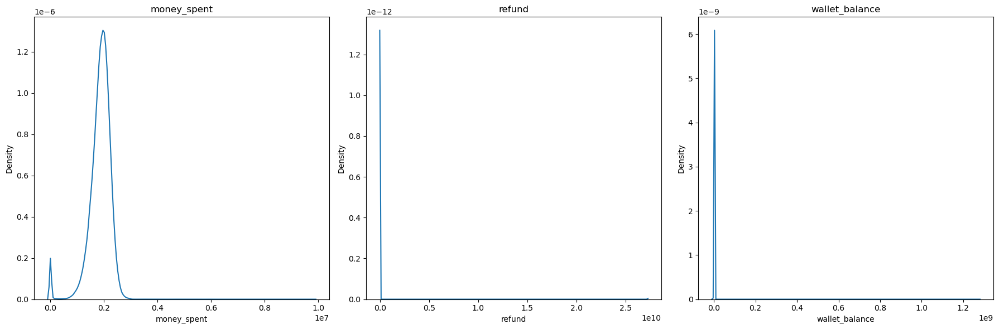

In [32]:
#@title **Numeric Columns Distribution on User Dataset**
columns = ['money_spent', 'refund', 'wallet_balance']

plt.figure(figsize=(18, 6))

for i, col in enumerate(columns):
    plt.subplot(1, 3, i + 1)
    sns.kdeplot(x=col, data=user)
    plt.title(f'{col}')
    plt.xlabel(col)

plt.tight_layout()
plt.show()

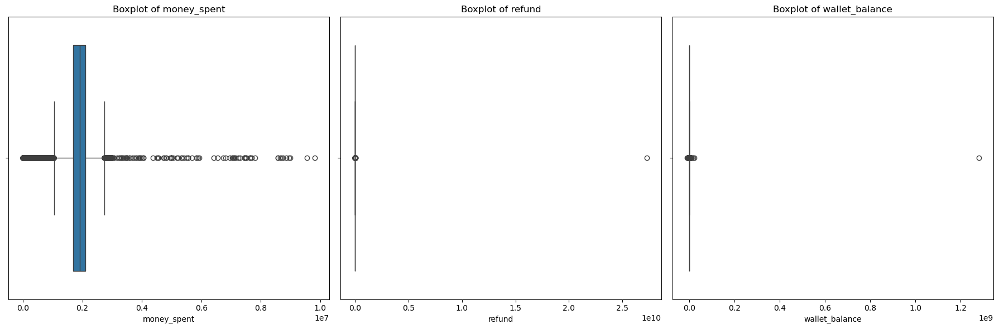

In [33]:
#@title **Boxplot**
plt.figure(figsize=(18, 6))

for i, col in enumerate(columns):
    plt.subplot(1, 3, i + 1)
    sns.boxplot(x=col, data=user)
    plt.title(f'Boxplot of {col}')
    plt.xlabel(col)

plt.tight_layout()
plt.show()

> Ditemukan outliers yang sangat tinggi pada kolom `refund` dan `wallet_balance` sehingga kita akan lakukan treatment lanjutan pada Bagian Further Inspection


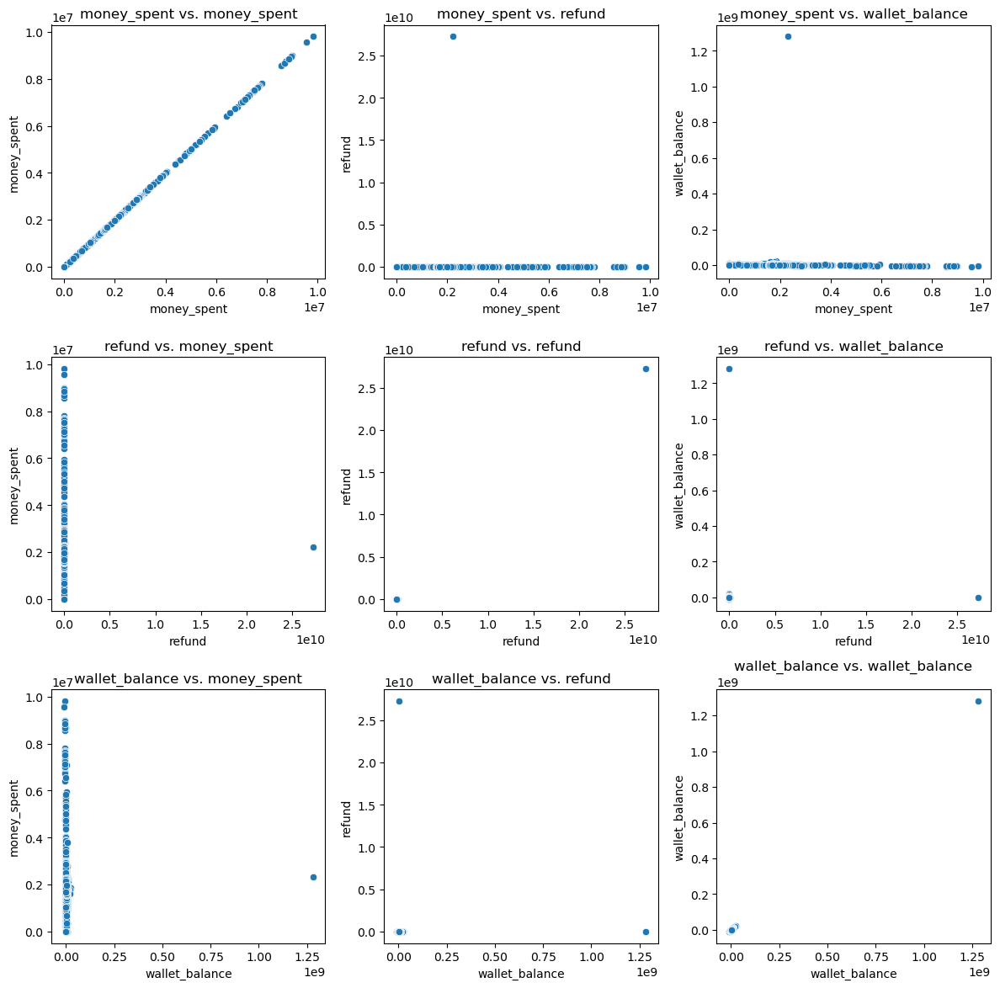

In [34]:
#@title **Scatterplot**
columns = ['money_spent', 'refund', 'wallet_balance']

# Membuat figure window baru
plt.figure(figsize=(12, 12))  # "figsize" adalah argumen untuk mengatur lebar dan panjang

# Loop through all column combinations
for i, col1 in enumerate(columns):
  for j, col2 in enumerate(columns):
      # Calculate subplot position based on loop indices
      ax = plt.subplot(len(columns), len(columns), i * len(columns) + j + 1)
      sns.scatterplot(x=col1, y=col2, data=user)
      plt.title(f'{col1} vs. {col2}')
      plt.xlabel(col1)
      plt.ylabel(col2)

plt.tight_layout()
plt.show()


> Ditemukan outliers yang sangat tinggi pada kolom `refund` dan `wallet_balance` sehingga kita akan lakukan treatment lanjutan pada Bagian Further Inspection







<Axes: >

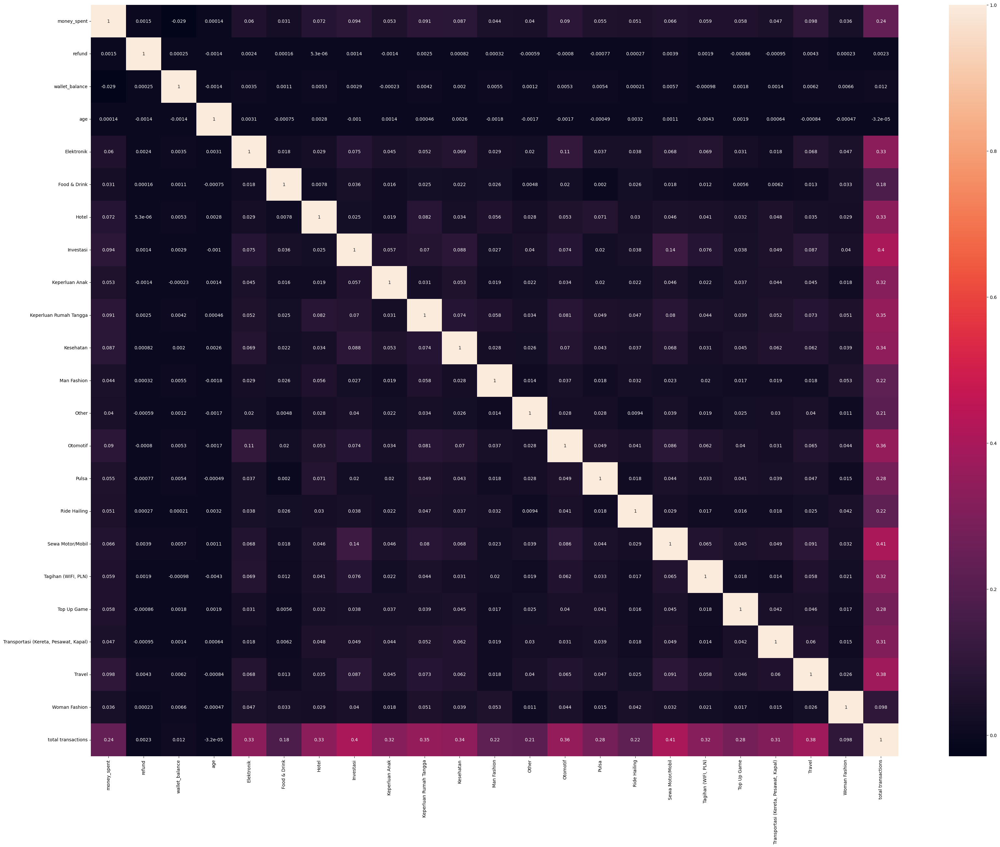

In [35]:
#@title **Heatmap - User Dataset**
plt.figure(figsize=(40,30))
sns.heatmap(user.corr(numeric_only=True), annot=True)

**Interpretasi Heatmap**
* Korelasi antara Money Spent dan Refund menunjukkan korelasi yang cenderung positif dan sangat lemah. Berdasarkan heatmap, semakin banyak jumlah uang yang dihabiskan, maka semakin banyak pula jumlah pengembalian dana, begitu juga sebaliknya.
* Korelasi antara Money Spent dan Wallet Ballance menunjukkan korelasi yang cenderung negatif dan sangat lemah. Berdasarkan heatmap, semakin banyak jumlah uang yang dihabiskan, maka semakin sedikit saldo dompet, begitu juga sebaliknya.
* Korelasi antara Refund dan Wallet Ballance menunjukkan korelasi yang cenderung positif dan sangat lemah. Berdasarkan heatmap, semakin banyak jumlah uang pengembalian dana, maka semakin sedikit saldo dompet, begitu juga sebaliknya.

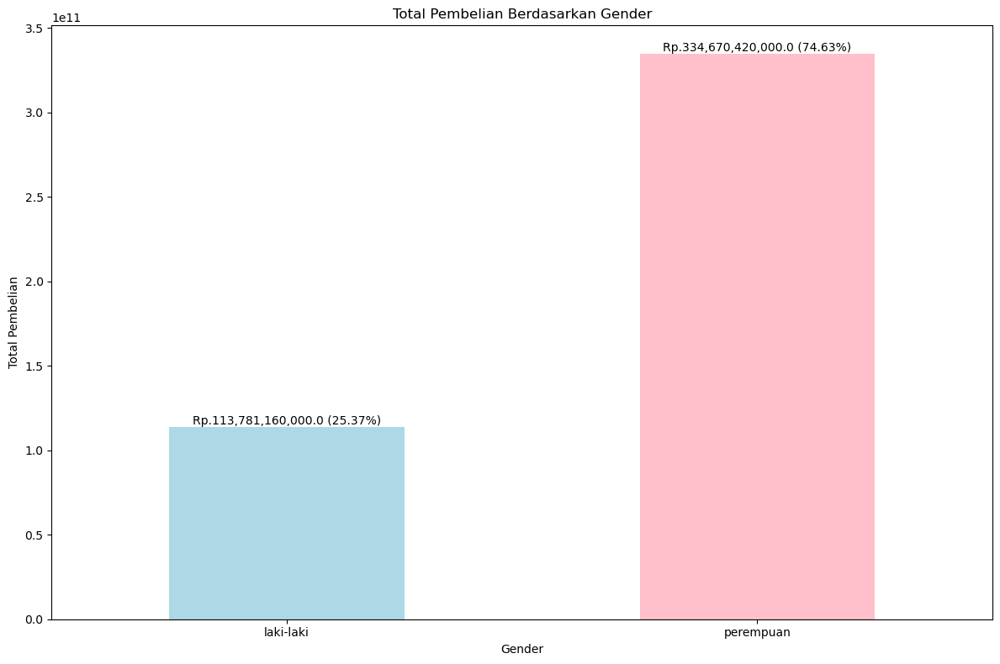

In [36]:
#@title **Kategori dengan pembelian terbanyak berdasarkan gender**
# Menghitung total pembelian berdasarkan gender
purchase_by_gender = user.groupby('gender')['money_spent'].sum()

# Plot bar chart
plt.figure(figsize=(12, 8))
purchase_by_gender.plot(kind='bar', color=['lightblue', 'pink'])
plt.title('Total Pembelian Berdasarkan Gender')
plt.xlabel('Gender')
plt.ylabel('Total Pembelian')
plt.xticks(rotation=0)

# Menambahkan persentase di atas setiap bar
total_purchase = user['money_spent'].sum()
for index, value in enumerate(purchase_by_gender):
    percentage = (value / total_purchase) * 100
    plt.text(index, value + 30, f'Rp.{value:,} ({percentage:.2f}%)', ha='center', va='bottom')

plt.tight_layout()
plt.show()

<Figure size 1600x1200 with 0 Axes>

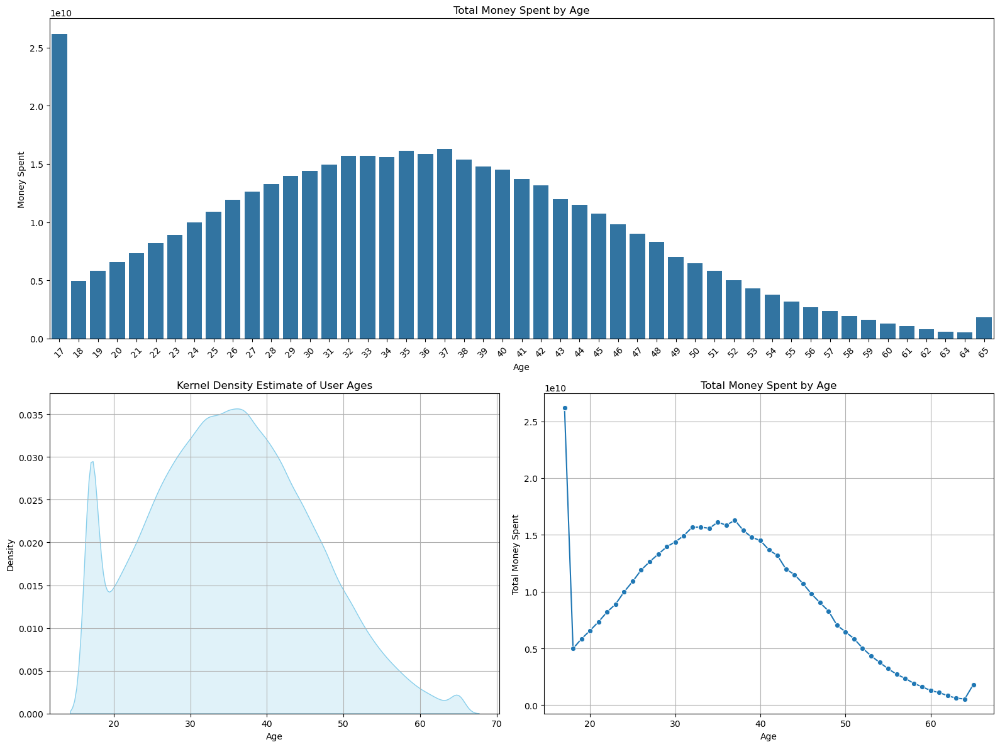

In [37]:
#@title **Total Pengeluaran Berdasarkan Usia**
plt.figure(figsize=(16, 12))

from matplotlib.gridspec import GridSpec

# Membuat figure dan grid spec
plt.figure(figsize=(16, 12))
gs = GridSpec(2, 2, width_ratios=[1, 1])

# Subplot pertama: Bar plot (mengisi baris pertama secara penuh)
plt.subplot(gs[0, :])  # 2 baris, 2 kolom, plot pertama (baris pertama secara penuh)
sns.barplot(x='age', y='money_spent', data=user, estimator=sum, ci=None)
plt.title('Total Money Spent by Age')
plt.xlabel('Age')
plt.ylabel('Money Spent')
plt.xticks(rotation=45)
plt.tight_layout()

# Subplot kedua: KDE plot
plt.subplot(gs[1, 0])  # 2 baris, 2 kolom, plot ketiga
sns.kdeplot(user['age'], shade=True, color='skyblue')
plt.title('Kernel Density Estimate of User Ages')
plt.xlabel('Age')
plt.ylabel('Density')
plt.grid(True)
plt.tight_layout()

# Menghitung total uang yang dihabiskan berdasarkan umur
total_spent_by_age = user.groupby('age')['money_spent'].sum().reset_index()

# Subplot ketiga: Line plot
plt.subplot(gs[1, 1])  # 2 baris, 2 kolom, plot keempat
sns.lineplot(x='age', y='money_spent', data=total_spent_by_age, marker='o')
plt.title('Total Money Spent by Age')
plt.xlabel('Age')
plt.ylabel('Total Money Spent')
plt.grid(True)
plt.tight_layout()

# Menampilkan plot
plt.show()

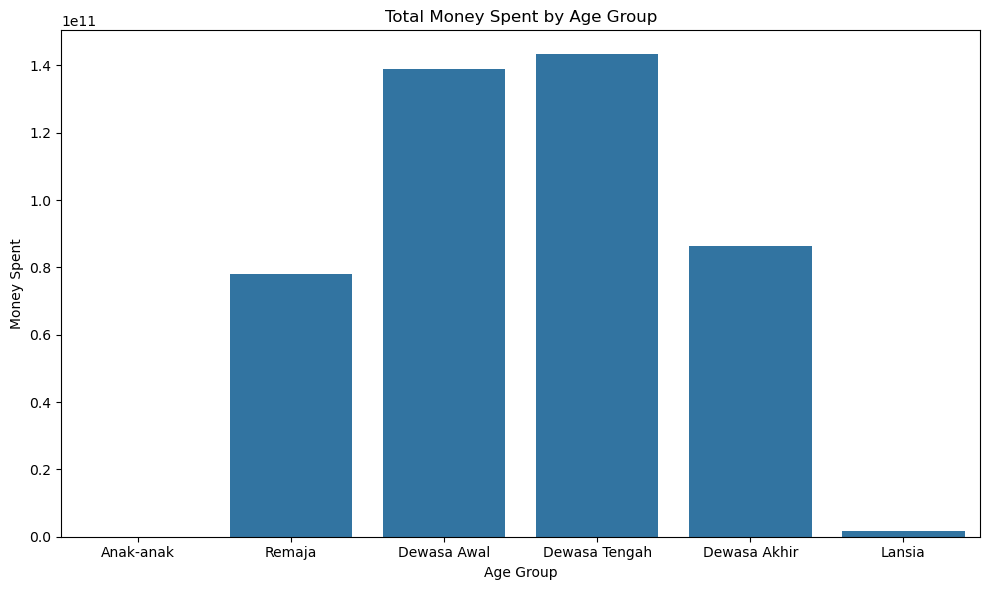

In [38]:
#@title **Plotting bar plot berdasarkan kategori usia**
plt.figure(figsize=(10, 6))
sns.barplot(x='age_group', y='money_spent', data=user, estimator=sum, ci=None)
plt.title('Total Money Spent by Age Group')
plt.xlabel('Age Group')
plt.ylabel('Money Spent')
plt.tight_layout()
plt.show()

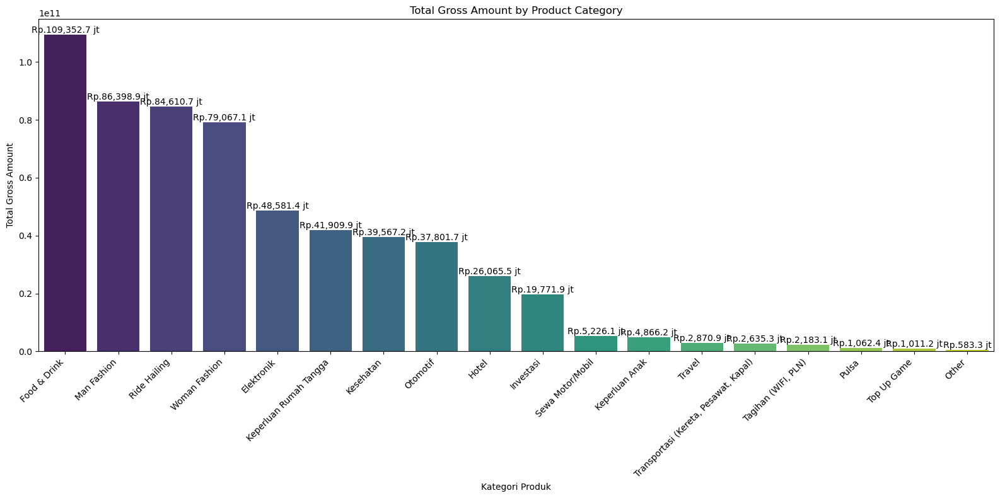

In [39]:
#@title **Gross Amount berdasarkan Kategori Produk**
total_gross_per_category = history.groupby('product name')['gross_amount'].sum()
total_gross_per_category = total_gross_per_category.sort_values(ascending=False)

plt.figure(figsize=(16, 8))
sns.barplot(x=total_gross_per_category.index, y=total_gross_per_category.values, palette='viridis', native_scale=False)
plt.xticks(rotation=45, ha='right')
plt.xlabel('Kategori Produk')
plt.ylabel('Total Gross Amount')
plt.title('Total Gross Amount by Product Category')
for index, value in enumerate(total_gross_per_category):
    juta = value / 1000000
    if value < 1000000:
      plt.text(index, value + 30, f'Rp.{juta:,.1f} ribu', ha='center', va='bottom')
    else:
      plt.text(index, value + 30, f'Rp.{juta:,.1f} jt', ha='center', va='bottom')
plt.tight_layout()
plt.show()

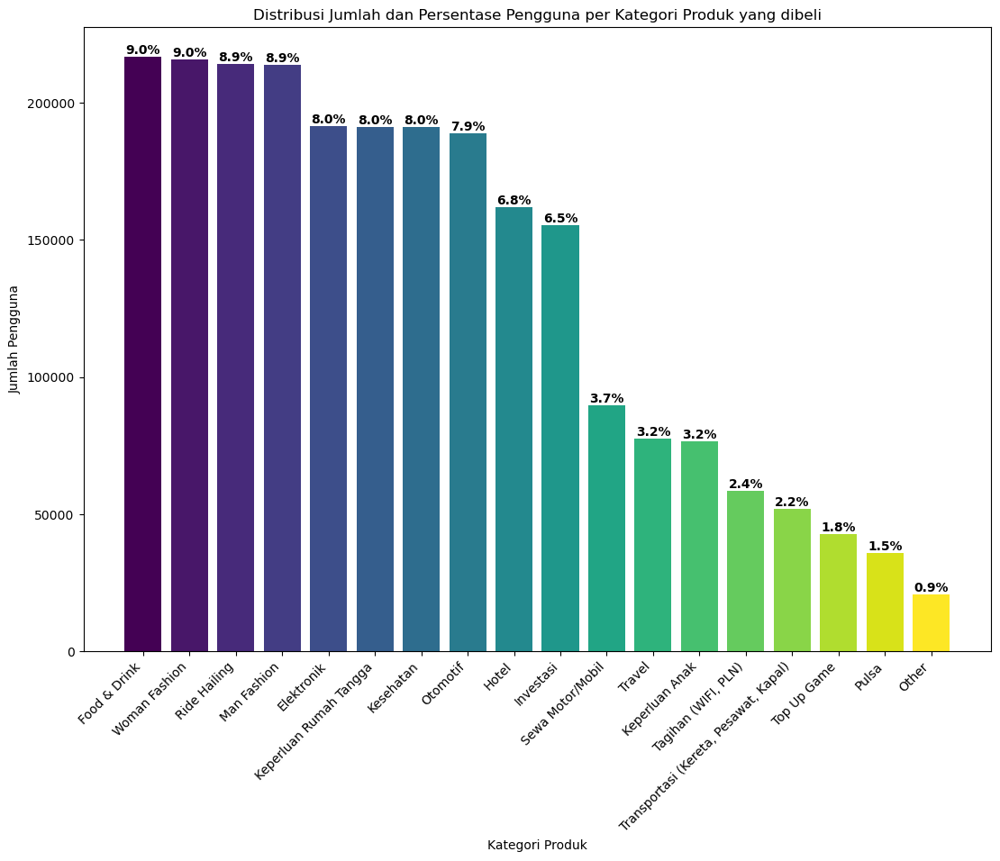

In [40]:
#@title **Jumlah User berdasarkan kategori produk/jasa yang dibeli**
user_per_category = history.groupby('product name')['user_id'].nunique()

# Mengurutkan data berdasarkan jumlah descending
user_per_category_sorted = user_per_category.sort_values(ascending=False)

# Menghitung persentase
total_users = user_per_category_sorted.sum()
percentages = (user_per_category_sorted / total_users) * 100

# Membuat bar chart
colors = plt.cm.viridis(np.linspace(0, 1, user_per_category_sorted.size))
plt.figure(figsize=(13, 9))
bars = plt.bar(user_per_category_sorted.index, user_per_category_sorted, color=colors)

# Mengatur label
for bar, percentage in zip(bars, percentages):
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, f'{percentage:.1f}%', ha='center', va='bottom', fontweight='bold')

plt.title('Distribusi Jumlah dan Persentase Pengguna per Kategori Produk yang dibeli')
plt.xlabel('Kategori Produk')
plt.ylabel('Jumlah Pengguna')
plt.xticks(rotation=45, ha='right')

# Menampilkan grafik
plt.show()


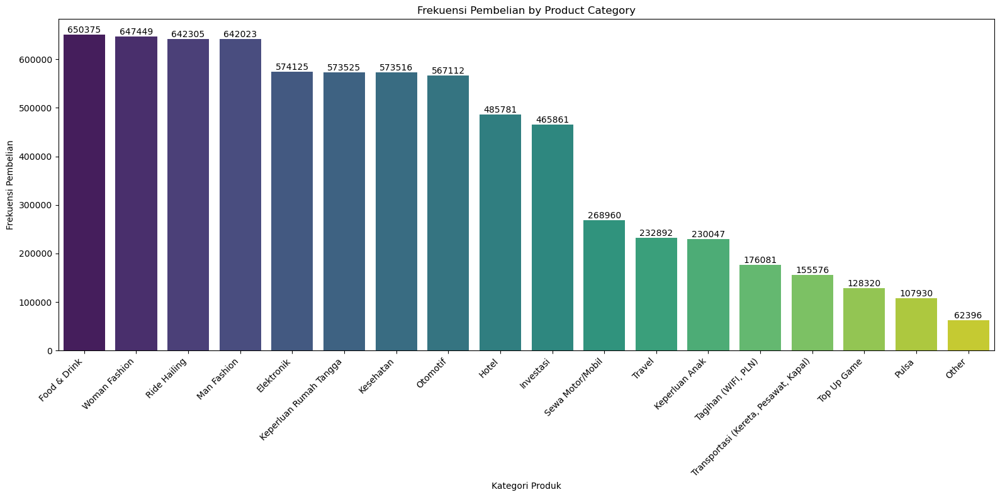

In [41]:
#@title **Frekuensi pembelian berdasarkan Kategori Produk**
frequency_per_category = history.groupby('product name')['product_id'].count()
frequency_per_category = frequency_per_category.sort_values(ascending=False)

plt.figure(figsize=(16, 8))
sns.barplot(x=frequency_per_category.index, y=frequency_per_category.values, palette='viridis', native_scale=False)
plt.xticks(rotation=45, ha='right')
plt.xlabel('Kategori Produk')
plt.ylabel('Frekuensi Pembelian')
plt.title('Frekuensi Pembelian by Product Category')
for index, value in enumerate(frequency_per_category):
  plt.text(index, value + 5, str(value), ha='center', va='bottom')
plt.tight_layout()
plt.show()

# **Feature Engineering**

##**Data Preparation - Final**

Disini kita bertujuan untuk memperbaiki beberapa kolom karena Datatype yang digunakan tidak sesuai dan menindaklanjuti hasil EDA pada bagian Scatter Plot dan Boxplot karena ada user yang terindikasi sebagai outliers


###**Handling Outliers**

In [42]:
#@markdown Pada kolom max ditemukan bahwa ada user yang jangkauan nilainya sangat jauh dibandingkan user yang lain sehingga tindakan yang akan diambil kita akan **menghapus user tersebut dari dataset**
user.describe()

,money_spent,refund,wallet_balance,age,Elektronik,Food & Drink,Hotel,Investasi,Keperluan Anak,Keperluan Rumah Tangga,...,Otomotif,Pulsa,Ride Hailing,Sewa Motor/Mobil,"Tagihan (WIFI, PLN)",Top Up Game,"Transportasi (Kereta, Pesawat, Kapal)",Travel,Woman Fashion,total transactions
count,"241,649.0","241,649.0","241,649.0","241,649.0","220,306.0","220,306.0","220,306.0","220,306.0","220,306.0","220,306.0",...,"220,306.0","220,306.0","220,306.0","220,306.0","220,306.0","220,306.0","220,306.0","220,306.0","220,306.0","241,649.0"
mean,"1,855,797.3755322802","309,721.2899701633","626,239.2974934719",35.19284582183249,2.606034334062622,2.9521438363004187,2.2050284604141512,2.1146087714360933,1.044215772607192,2.603310849454849,...,2.5742013381387707,0.4899094895282017,2.915512968325874,1.2208473668442983,0.799256488702078,0.5824625747823482,0.7061814022314418,1.057129628789048,2.938862309696513,27.050908549176697
std,"413,876.24368278304","55,476,654.86294467","2,632,006.368633109",10.606158136286828,1.265017886200787,0.8957164439251706,1.4953413649531384,1.52753450760058,1.5079407378499023,1.2673617054378958,...,1.2920181375557567,1.1569509604223724,0.942899974135029,1.5635583749361366,1.3924239340530828,1.239405802917849,1.3319466737480232,1.5123182070382208,0.9108200863009931,10.673694065175978
min,0.0,"-7,790,000.0","-9,550,000.0",17.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25%,"1,680,000.0","110,000.0","460,000.0",27.0,2.0,2.0,0.0,0.0,0.0,2.0,...,2.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,2.0,24.0
50%,"1,910,000.0","180,000.0","610,000.0",35.0,3.0,3.0,2.0,2.0,0.0,3.0,...,3.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,3.0,29.0
75%,"2,100,000.0","270,000.0","780,000.0",42.0,4.0,4.0,3.0,3.0,2.0,4.0,...,4.0,0.0,4.0,3.0,2.0,0.0,0.0,2.0,4.0,34.0
max,"9,810,000.0","27,271,120,000.000004","1,280,390,000.0",65.0,4.0,4.0,4.0,4.0,4.0,4.0,...,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,59.0


In [43]:
user[user['refund'] == 27271120000.000004]

,user_id,full_name,gender,money_spent,refund,wallet_balance,join_date,birth,nama provinsi,nama kabupaten,...,Otomotif,Pulsa,Ride Hailing,Sewa Motor/Mobil,"Tagihan (WIFI, PLN)",Top Up Game,"Transportasi (Kereta, Pesawat, Kapal)",Travel,Woman Fashion,total transactions
128554,SC3371011009009,AZ WADU ADE,perempuan,"2,210,000.0","27,271,120,000.000004","750,000.0",2023-12-09,1996-11-14,JAWA TENGAH,KOTA MAGELANG,...,2.0,0.0,3.0,4.0,2.0,0.0,0.0,4.0,3.0,37.0


In [44]:
user[user['wallet_balance'] == 1280390000]

,user_id,full_name,gender,money_spent,refund,wallet_balance,join_date,birth,nama provinsi,nama kabupaten,...,Otomotif,Pulsa,Ride Hailing,Sewa Motor/Mobil,"Tagihan (WIFI, PLN)",Top Up Game,"Transportasi (Kereta, Pesawat, Kapal)",Travel,Woman Fashion,total transactions
176961,SC3525122021001,Rinaldi FERNANDA,laki-laki,"2,330,000.0","200,000.0","1,280,390,000.0",2023-12-02,1993-08-21,JAWA TIMUR,GRESIK,...,4.0,2.0,2.0,0.0,0.0,0.0,0.0,4.0,4.0,31.0


In [45]:
user = user[user['refund'] < 27271120000.000004]
user = user[user['wallet_balance'] < 1280390000]

###**Changing Datatypes - User Dataset**

In [46]:
user['join_date'] = pd.to_datetime(user['join_date'])
user['birth'] = pd.to_datetime(user['birth'])
user['age'] = user['age'].astype('int64')

###**Changing Datatypes - History Dataset**

In [47]:
history['transaction_date'] = pd.to_datetime(history['transaction_date'])

## **Feature Creation - Final**

In [48]:
#@title **Handilng Missing Values due Feature Creation**
#@markdown Ditemukan bahwa Feature Engineering yang dihasilkan untuk beberapa user menghasilkan `NaN` Values, kita akan inspeksi kenapa ini bisa terjadi
user.isnull().sum()

user_id                                      0
full_name                                    0
gender                                       0
money_spent                                  0
refund                                       0
wallet_balance                               0
join_date                                    0
birth                                        0
nama provinsi                                0
nama kabupaten                               0
nama kecamatan                               0
age                                          0
age_group                                    0
Elektronik                               21343
Food & Drink                             21343
Hotel                                    21343
Investasi                                21343
Keperluan Anak                           21343
Keperluan Rumah Tangga                   21343
Kesehatan                                21343
Man Fashion                              21343
Other        

In [49]:
#@markdown Melihat bagaimana sebaran `NaN` values
user[user['Elektronik'].isnull()]

,user_id,full_name,gender,money_spent,refund,wallet_balance,join_date,birth,nama provinsi,nama kabupaten,...,Otomotif,Pulsa,Ride Hailing,Sewa Motor/Mobil,"Tagihan (WIFI, PLN)",Top Up Game,"Transportasi (Kereta, Pesawat, Kapal)",Travel,Woman Fashion,total transactions
6,SC3402052002013,PRAMUNINGTYAS,perempuan,"1,900,000.0","160,000.0","460,000.0",2023-10-07,1994-09-22,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
25,SC3402052001011,ANTHONY,perempuan,"1,790,000.0","120,000.0","320,000.0",2023-12-30,1987-04-02,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
38,SC3402052001043,MEGA S.Adm.,perempuan,"1,569,999.9999999998","130,000.0","220,000.0",2023-10-20,2004-05-02,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
41,SC3402052003001,KARTI,perempuan,"1,770,000.0","180,000.0","530,000.0",2023-10-28,1998-01-16,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
44,SC3402052003016,"ANTONI SIREGAR S.Si.T., M.M.",laki-laki,"1,890,000.0","230,000.0","520,000.0",2023-11-27,1995-08-23,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
241481,SC3504011006019,RACHMAN ANITA,perempuan,"370,000.0","310,000.0","2,200,000.0",2023-12-25,1979-05-18,JAWA TIMUR,TULUNGAGUNG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
241484,SC3504011006022,AMIN,perempuan,"1,820,000.0","270,000.0","740,000.0",2023-12-02,2007-10-17,JAWA TIMUR,TULUNGAGUNG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
241523,SC3504011009004,Artha DHAMAYANTI,perempuan,"1,840,000.0","230,000.0","540,000.0",2023-10-04,1979-05-22,JAWA TIMUR,TULUNGAGUNG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
241528,SC3504011009009,RISMAYANTI,perempuan,"2,180,000.0","170,000.0","590,000.0",2023-11-08,1998-05-20,JAWA TIMUR,TULUNGAGUNG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0


Muncul 2 dugaan kenapa `NaN` values ini banyak bermunculan:
1. Beberapa User tidak melakukan transaksi apapun di tahun 2024
2. Beberapa User memang melakukan transaksi di tahun 2024 namun bukti riwayat transaksi mereka tidak terekap pada dataset yang diberikan

In [50]:
#@markdown Dapat dilihat bahwa memang user yang mengalami kendala Missing Values ini, tidak ada riwayat transaksi apapun yang terekap pada dataset history, disini kita belum dapat menyimpulkan apa alasan Missing Values ini banyak bermunculan
test_mv = history[history['user_id'] == 'SC3402052001043']
test_mv

,user_id,product_id,gross_amount,discounts,transaction_date,product name


Kita coba bandingkan dengan salah satu user yang memiliki data lengkap

Lalu muncul beberapa pertanyaan:
1. Pada bagian Data Preparation apakah dengan mengalikan 15000 pada kolom `gross_amount` dan `discount` itu sudah tepat? karena pada dataset user di kolom `money_spent`, `refund`, dan `wallet_balance` sudah dalam bentuk kurs rupiah bukan dalam bentuk dolar
2. Apakah kolom `money_spent` pada dataset user merupakan hasil penjumlahan `gross_amount` dari keseluruhan transaksi yang dilakukan oleh user tersebut pada tahun 2024?

Karena dengan menjawab kedua pertanyaan ini, kita dapat mengetahui diantara kedua dugaan `NaN` values yang muncul, manakah dugaan yang benar sehingga nantinya dapat mempermudah kita dalam mengambil tindakan tepat terhadap Missing Values yang bermunculan

In [51]:
test = history[history['user_id'] == 'SC3402052002010']
test['gross_amount'].sum()

1630000.0

In [52]:
#@markdown Mengkomparasikan hasil penjumlahan `gross_amount` dengan `money_spent` pada dataset user
user[user['user_id'] == 'SC3402052002010']

,user_id,full_name,gender,money_spent,refund,wallet_balance,join_date,birth,nama provinsi,nama kabupaten,...,Otomotif,Pulsa,Ride Hailing,Sewa Motor/Mobil,"Tagihan (WIFI, PLN)",Top Up Game,"Transportasi (Kereta, Pesawat, Kapal)",Travel,Woman Fashion,total transactions
4,SC3402052002010,HARJOKO IHSAN S.Sos.,laki-laki,"1,629,999.9999999998","80,000.0","190,000.0",2023-12-08,2006-06-18,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,...,2.0,0.0,3.0,0.0,3.0,0.0,0.0,0.0,3.0,20.0


Dapat disimpulkan bahwa:
1. Mengalikan 15000 pada kolom `gross_amount` dan `discount` itu **sudah tepat**
2. Kolom `money_spent` pada dataset user **merupakan** hasil penjumlahan `gross_amount` dari keseluruhan transaksi yang dilakukan oleh user tersebut pada tahun 2024

Sehingga dugaan Missing Values yang kedua: ***User tersebut memang melakukan transaksi di tahun 2024 namun riwayat transaksi mereka tidak terekap pada dataset yang diberikan***, merupakan dugaan paling tepat mengapa `NaN` Values banyak bermunculan

In [53]:
#@markdown Lalu tindak lanjut yang dilakukan untuk mengatasi missing values ini, yaitu dengan **Menghapus user dengan riwayat transaksi mereka yang tidak terekap pada dataset yang diberikan karena jika kita isi Missing valuesnya dengan angka 0**, itu akan sangat mempengaruhi model yang kita buat nantinya
user.dropna(inplace=True)

In [54]:
user.isnull().sum()

user_id                                  0
full_name                                0
gender                                   0
money_spent                              0
refund                                   0
wallet_balance                           0
join_date                                0
birth                                    0
nama provinsi                            0
nama kabupaten                           0
nama kecamatan                           0
age                                      0
age_group                                0
Elektronik                               0
Food & Drink                             0
Hotel                                    0
Investasi                                0
Keperluan Anak                           0
Keperluan Rumah Tangga                   0
Kesehatan                                0
Man Fashion                              0
Other                                    0
Otomotif                                 0
Pulsa      

## **Exploratory Data Analysis - Final**

###**Gender Distribution**

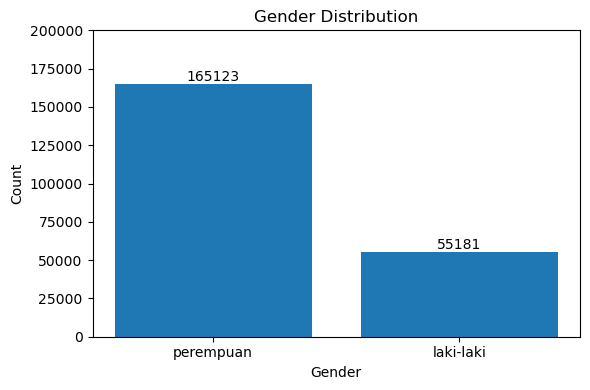

In [55]:
#@markdown
plt.figure(figsize=(6, 4))

plt.bar(user['gender'].unique(), user['gender'].value_counts())
plt.ylim(0,200000)
plt.xlabel('Gender')
plt.ylabel('Count')
plt.title('Gender Distribution')

for i, count in enumerate(user['gender'].value_counts()):
    plt.text(i, count + 0.1, f'{count}', ha='center', va='bottom')

plt.tight_layout()
plt.show()


###**Jumlah Pengguna**

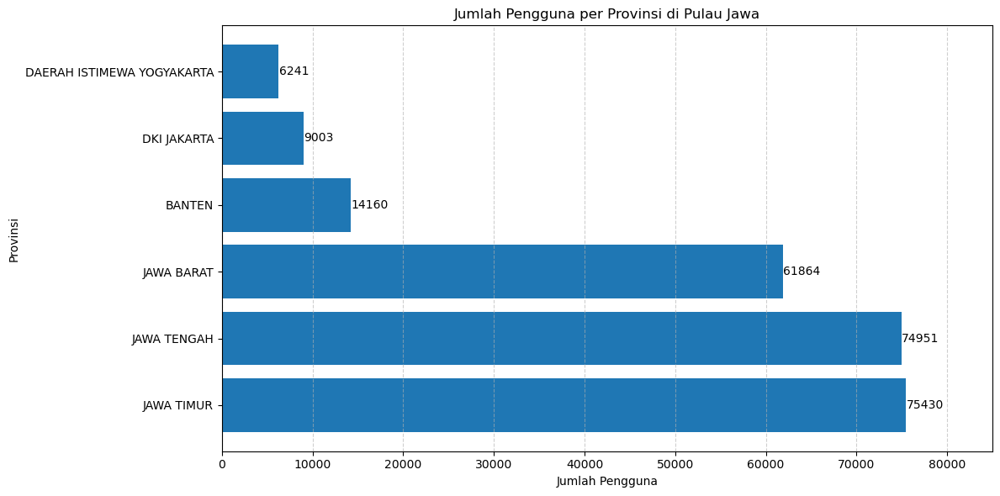

In [56]:
#@markdown
plt.figure(figsize=(12, 6))
plt.barh(asprov.index, asprov.values)

plt.xlim(0,85000)
plt.xlabel('Jumlah Pengguna')
plt.ylabel('Provinsi')
plt.title('Jumlah Pengguna per Provinsi di Pulau Jawa')

plt.grid(axis='x', linestyle='--', alpha=0.6)

for i, v in enumerate(asprov.values):
    plt.annotate(f"{v}", xy=(v + 50, i), ha='left', va='center', fontsize=10)

plt.tight_layout()
plt.show()

###**Numeric Columns Distribution on User Dataset**

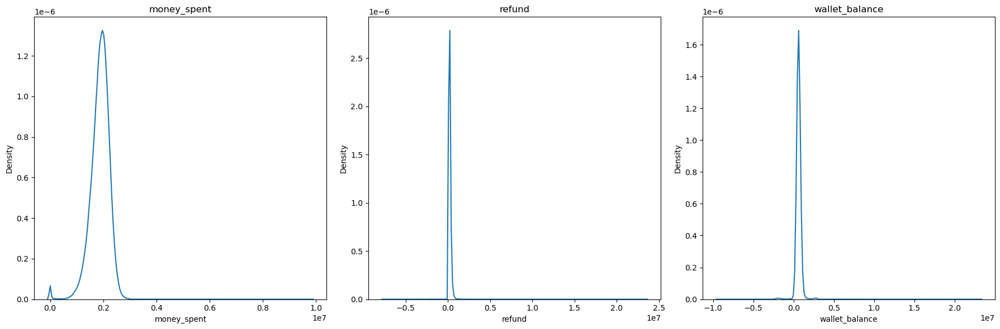

In [57]:
#@markdown
columns = ['money_spent', 'refund', 'wallet_balance']

plt.figure(figsize=(18, 6))

for i, col in enumerate(columns):
    plt.subplot(1, 3, i + 1)
    sns.kdeplot(x=col, data=user)
    plt.title(f'{col}')
    plt.xlabel(col)

plt.tight_layout()
plt.show()

### **Boxplot**

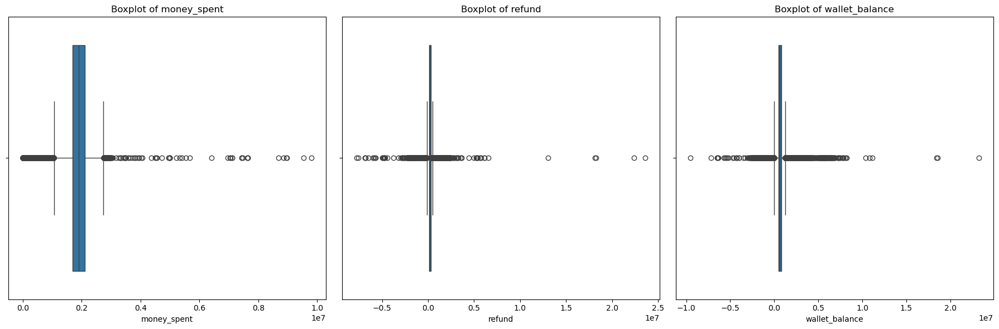

In [58]:
#@markdown
plt.figure(figsize=(18, 6))

for i, col in enumerate(columns):
    plt.subplot(1, 3, i + 1)
    sns.boxplot(x=col, data=user)
    plt.title(f'Boxplot of {col}')
    plt.xlabel(col)

plt.tight_layout()
plt.show()

**Money Spent** : Sebagian besar pengguna membelanjakan uang dalam kisaran yang relatif moderat, namun ada juga yang membelanjakan lebih banyak secara signifikan

**Refund** : refund dana umumnya rendah, namun ada satu outlier penting yang jauh lebih tinggi dibandingkan yang lain, yang mungkin mengindikasikan transaksi pengembalian dana yang tidak biasa

**wallet balance** : Beberapa nilai ekstrem terlihat sebagai outlier, yang menunjukkan bahwa beberapa pengguna memiliki saldo dompet yang sangat tinggi dibandingkan mayoritas pengguna.

### **Scatterplot**

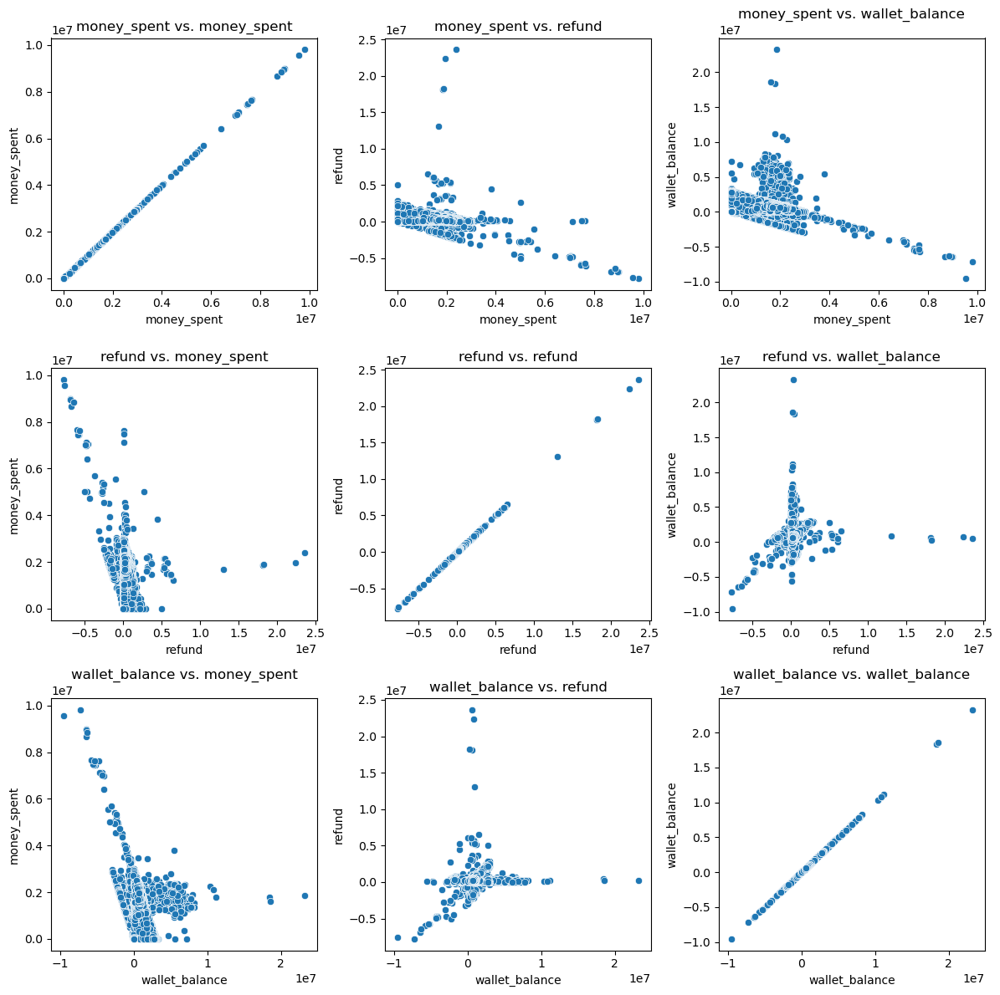

In [59]:
#@markdown
columns = ['money_spent', 'refund', 'wallet_balance']

# Membuat figure window baru
plt.figure(figsize=(12, 12))  # "figsize" adalah argumen untuk mengatur lebar dan panjang

# Loop through all column combinations
for i, col1 in enumerate(columns):
  for j, col2 in enumerate(columns):
      # Calculate subplot position based on loop indices
      ax = plt.subplot(len(columns), len(columns), i * len(columns) + j + 1)
      sns.scatterplot(x=col1, y=col2, data=user)
      plt.title(f'{col1} vs. {col2}')
      plt.xlabel(col1)
      plt.ylabel(col2)

plt.tight_layout()
plt.show()


**Interpretasi Scatter Plot**

* **Money Spent vs Refund**: Scatter plot menunjukkan tidak adanya hubungan yang linear antara keduanya. Semakin meningkatnya uang yang dihabiskan, tidak meningkatkan pengembalian dana yang diterima. Terdapat satu pencilan yang dapat diidentifikasi dalam scatter plot ini.
* **Money Spent vs Wallet Balance**: Scatter plot menunjukkan tidak adanya hubungan yang linear antara keduanya. Semakin meningkatnya uang yang dihabiskan, tidak meningkatkan pengembalian dana yang diterima. Terdapat satu pencilan yang dapat diidentifikasi dalam scatter plot ini.
* **Refund vs Wallet Balance**: Scatter plot menunjukkan adanya hubungan yang negatif antara keduanya. Terdapat 3 penyebaran data yang teridentifikasi pada scatter plot tersebut, yaitu ketika saldo dompet dan jumlah pengembalian dana nol, ketika saldo dompet tinggi sedangkan jumlah pengembalian dana rendah dan ketika saldo dompet rendah sedangkan pengembalian dana tinggi.







### **Heatmap - User Dataset**

<Axes: >

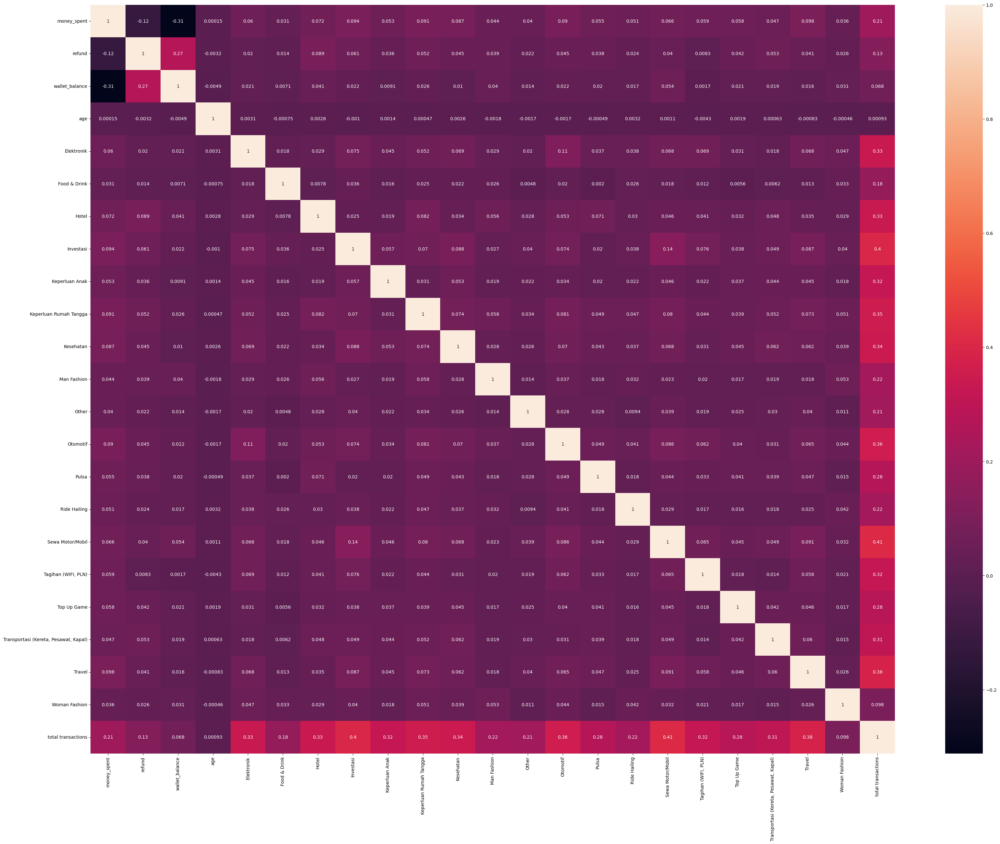

In [60]:
#@markdown
plt.figure(figsize=(40,30))
sns.heatmap(user.corr(numeric_only=True), annot=True)

**Interpretasi Heatmap**
* Korelasi antara Money Spent dan Refund menunjukkan korelasi yang cenderung positif dan sangat lemah. Berdasarkan heatmap, semakin banyak jumlah uang yang dihabiskan, maka semakin banyak pula jumlah pengembalian dana, begitu juga sebaliknya.
* Korelasi antara Money Spent dan Wallet Ballance menunjukkan korelasi yang cenderung negatif dan sangat lemah. Berdasarkan heatmap, semakin banyak jumlah uang yang dihabiskan, maka semakin sedikit saldo dompet, begitu juga sebaliknya.
* Korelasi antara Refund dan Wallet Ballance menunjukkan korelasi yang cenderung positif dan sangat lemah. Berdasarkan heatmap, semakin banyak jumlah uang pengembalian dana, maka semakin sedikit saldo dompet, begitu juga sebaliknya.

### **Kategori dengan pembelian terbanyak berdasarkan gender**

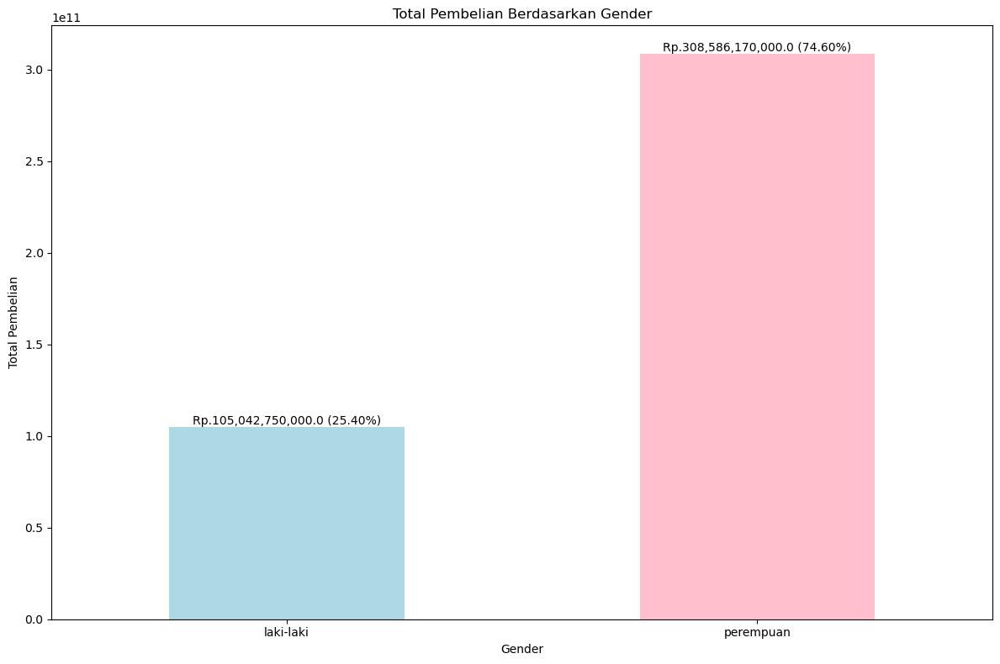

In [61]:
#@markdown
# Menghitung total pembelian berdasarkan gender
purchase_by_gender = user.groupby('gender')['money_spent'].sum()

# Plot bar chart
plt.figure(figsize=(12, 8))
purchase_by_gender.plot(kind='bar', color=['lightblue', 'pink'])
plt.title('Total Pembelian Berdasarkan Gender')
plt.xlabel('Gender')
plt.ylabel('Total Pembelian')
plt.xticks(rotation=0)

# Menambahkan persentase di atas setiap bar
total_purchase = user['money_spent'].sum()
for index, value in enumerate(purchase_by_gender):
    percentage = (value / total_purchase) * 100
    plt.text(index, value + 30, f'Rp.{value:,} ({percentage:.2f}%)', ha='center', va='bottom')

plt.tight_layout()
plt.show()

### **Total Pengeluaran Berdasarkan Usia**

<Figure size 1600x1200 with 0 Axes>

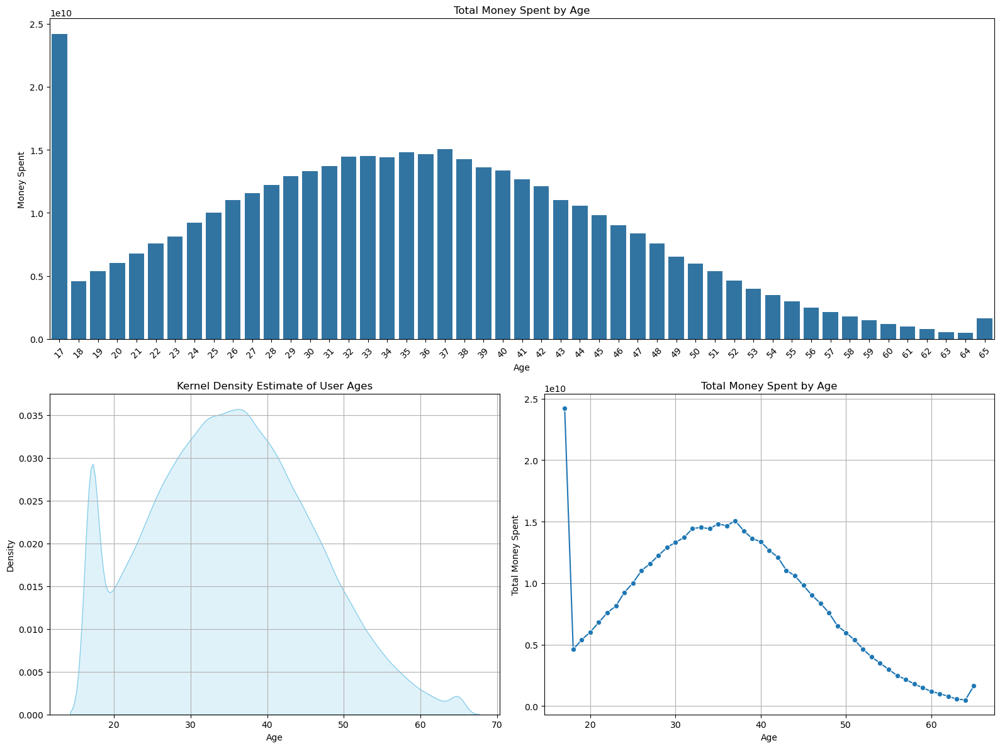

In [62]:
#@markdown
plt.figure(figsize=(16, 12))

from matplotlib.gridspec import GridSpec

# Membuat figure dan grid spec
plt.figure(figsize=(16, 12))
gs = GridSpec(2, 2, width_ratios=[1, 1])

# Subplot pertama: Bar plot (mengisi baris pertama secara penuh)
plt.subplot(gs[0, :])  # 2 baris, 2 kolom, plot pertama (baris pertama secara penuh)
sns.barplot(x='age', y='money_spent', data=user, estimator=sum, ci=None)
plt.title('Total Money Spent by Age')
plt.xlabel('Age')
plt.ylabel('Money Spent')
plt.xticks(rotation=45)
plt.tight_layout()

# Subplot kedua: KDE plot
plt.subplot(gs[1, 0])  # 2 baris, 2 kolom, plot ketiga
sns.kdeplot(user['age'], shade=True, color='skyblue')
plt.title('Kernel Density Estimate of User Ages')
plt.xlabel('Age')
plt.ylabel('Density')
plt.grid(True)
plt.tight_layout()

# Menghitung total uang yang dihabiskan berdasarkan umur
total_spent_by_age = user.groupby('age')['money_spent'].sum().reset_index()

# Subplot ketiga: Line plot
plt.subplot(gs[1, 1])  # 2 baris, 2 kolom, plot keempat
sns.lineplot(x='age', y='money_spent', data=total_spent_by_age, marker='o')
plt.title('Total Money Spent by Age')
plt.xlabel('Age')
plt.ylabel('Total Money Spent')
plt.grid(True)
plt.tight_layout()

# Menampilkan plot
plt.show()

### **Plotting bar plot berdasarkan kategori usia**

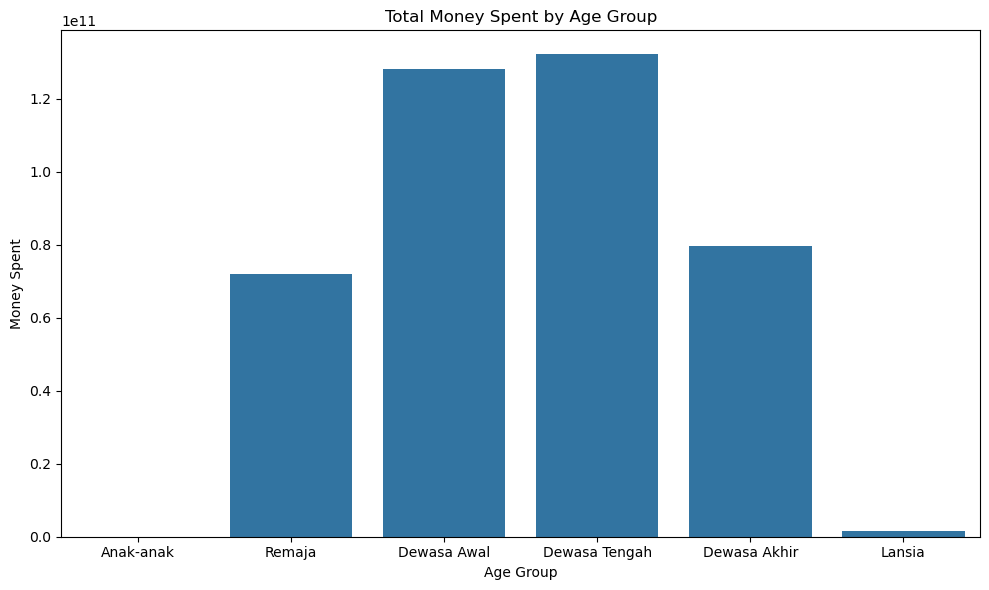

In [63]:
#@markdown
plt.figure(figsize=(10, 6))
sns.barplot(x='age_group', y='money_spent', data=user, estimator=sum, ci=None)
plt.title('Total Money Spent by Age Group')
plt.xlabel('Age Group')
plt.ylabel('Money Spent')
plt.tight_layout()
plt.show()

### **Gross Amount berdasarkan Kategori Produk**

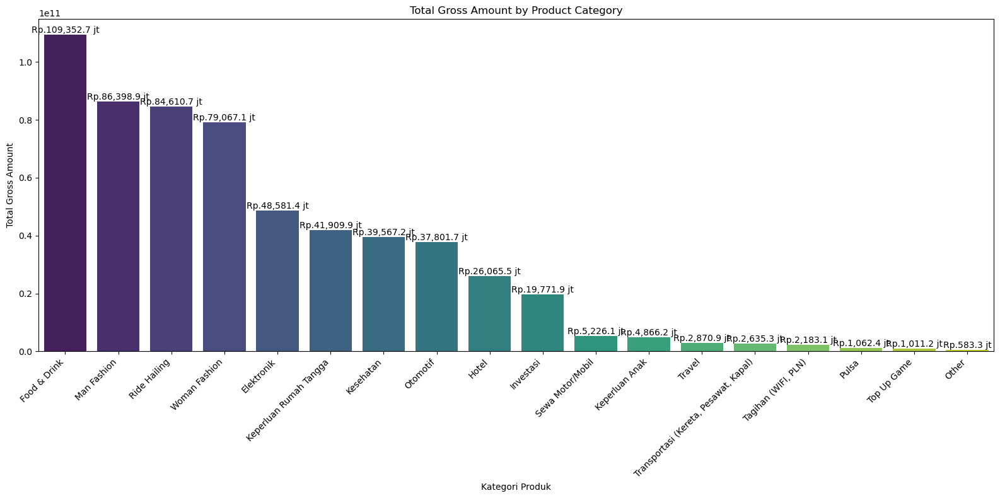

In [64]:
#@markdown
total_gross_per_category = history.groupby('product name')['gross_amount'].sum()
total_gross_per_category = total_gross_per_category.sort_values(ascending=False)

plt.figure(figsize=(16, 8))
sns.barplot(x=total_gross_per_category.index, y=total_gross_per_category.values, palette='viridis', native_scale=False)
plt.xticks(rotation=45, ha='right')
plt.xlabel('Kategori Produk')
plt.ylabel('Total Gross Amount')
plt.title('Total Gross Amount by Product Category')
for index, value in enumerate(total_gross_per_category):
    juta = value / 1000000
    if value < 1000000:
      plt.text(index, value + 30, f'Rp.{juta:,.1f} ribu', ha='center', va='bottom')
    else:
      plt.text(index, value + 30, f'Rp.{juta:,.1f} jt', ha='center', va='bottom')
plt.tight_layout()
plt.show()

### **Jumlah User berdasarkan kategori produk/jasa yang dibeli**

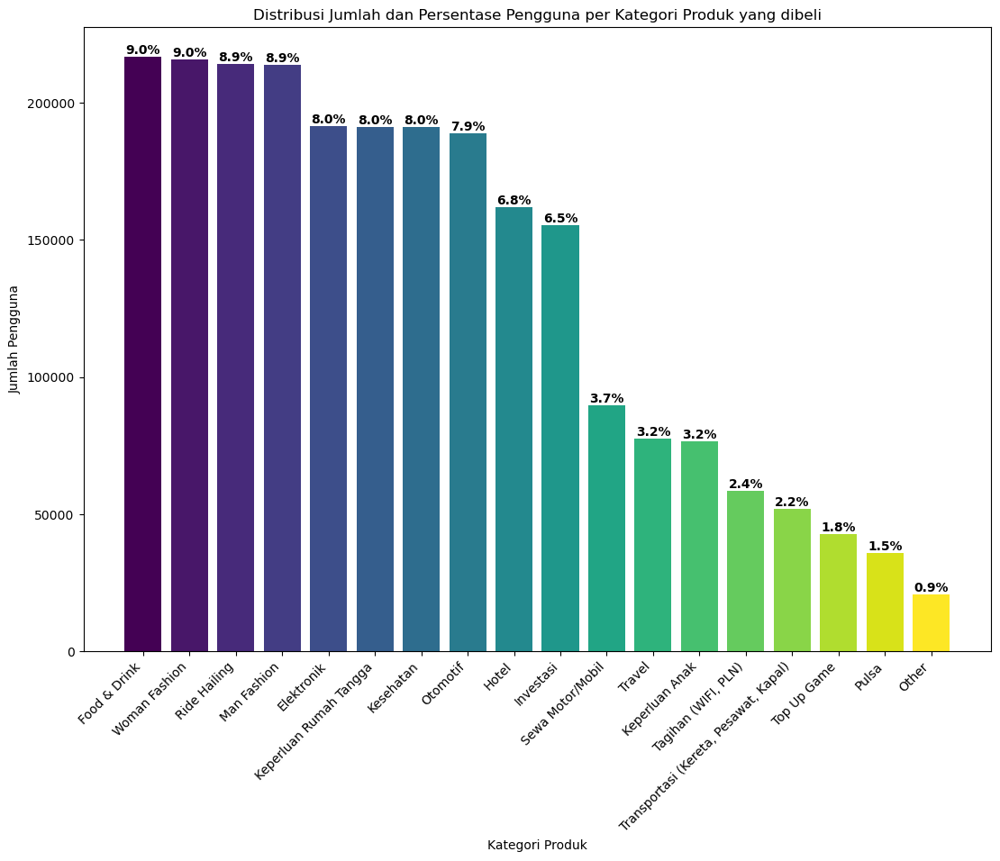

In [65]:
#@markdown
user_per_category = history.groupby('product name')['user_id'].nunique()

# Mengurutkan data berdasarkan jumlah descending
user_per_category_sorted = user_per_category.sort_values(ascending=False)

# Menghitung persentase
total_users = user_per_category_sorted.sum()
percentages = (user_per_category_sorted / total_users) * 100

# Membuat bar chart
colors = plt.cm.viridis(np.linspace(0, 1, user_per_category_sorted.size))
plt.figure(figsize=(13, 9))
bars = plt.bar(user_per_category_sorted.index, user_per_category_sorted, color=colors)

# Mengatur label
for bar, percentage in zip(bars, percentages):
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, f'{percentage:.1f}%', ha='center', va='bottom', fontweight='bold')

plt.title('Distribusi Jumlah dan Persentase Pengguna per Kategori Produk yang dibeli')
plt.xlabel('Kategori Produk')
plt.ylabel('Jumlah Pengguna')
plt.xticks(rotation=45, ha='right')

# Menampilkan grafik
plt.show()


### **Frekuensi pembelian berdasarkan Kategori Produk**

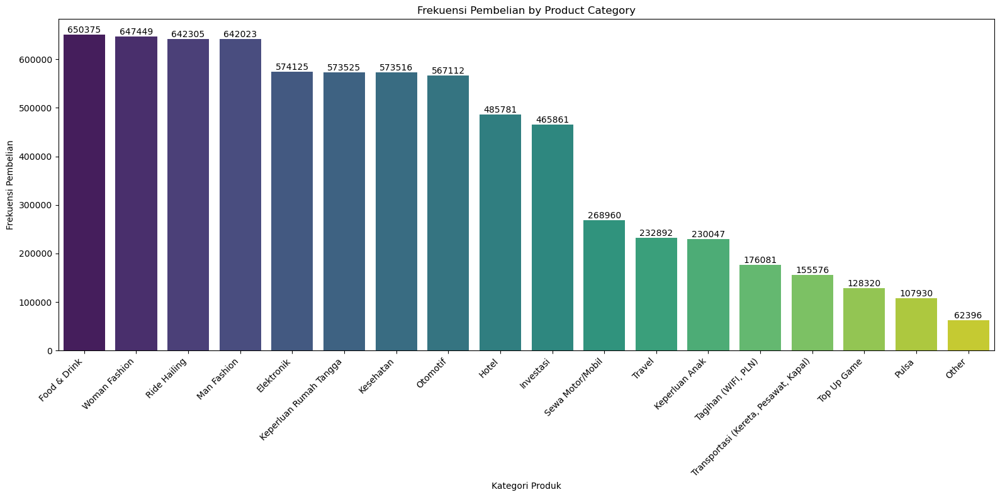

In [66]:
#@markdown
frequency_per_category = history.groupby('product name')['product_id'].count()
frequency_per_category = frequency_per_category.sort_values(ascending=False)

plt.figure(figsize=(16, 8))
sns.barplot(x=frequency_per_category.index, y=frequency_per_category.values, palette='viridis', native_scale=False)
plt.xticks(rotation=45, ha='right')
plt.xlabel('Kategori Produk')
plt.ylabel('Frekuensi Pembelian')
plt.title('Frekuensi Pembelian by Product Category')
for index, value in enumerate(frequency_per_category):
  plt.text(index, value + 5, str(value), ha='center', va='bottom')
plt.tight_layout()
plt.show()

### **Frekuensi Pembelian per Bulan**

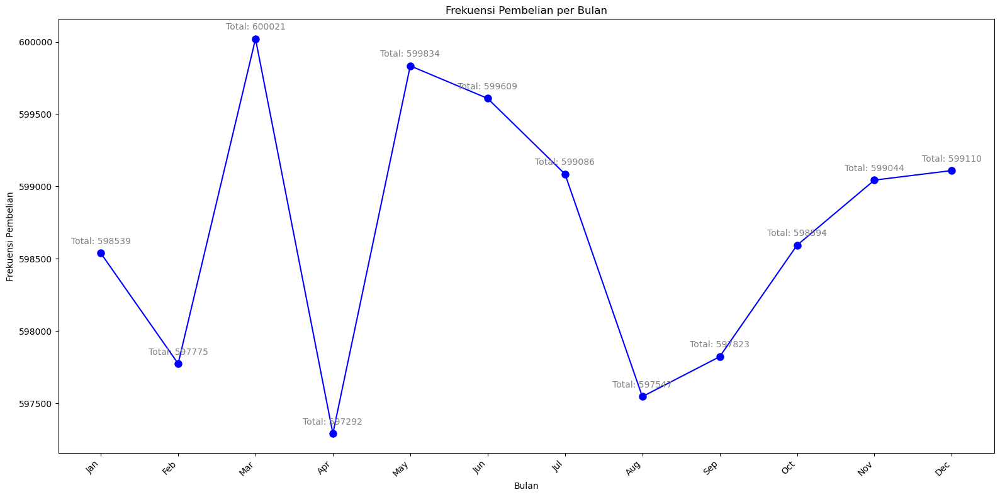

In [67]:
#@markdown
monthly = history.groupby(history['transaction_date'].dt.month)['product_id'].count()

month_names = ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]

plt.figure(figsize=(16, 8))
plt.plot(monthly.index, monthly.values, marker='o', linestyle='-', color='b', markersize=8)

plt.xticks(monthly.index, month_names if month_names else monthly.index.values, rotation=45, ha='right')
plt.xlabel('Bulan')
plt.ylabel('Frekuensi Pembelian')
plt.title('Frekuensi Pembelian per Bulan')

for index, value in enumerate(monthly):
    plt.text(index+1, value + 50, f"Total: {value}", ha='center', va='bottom', fontsize=10, color='gray')

plt.tight_layout()
plt.show()

## **Transformation**

###**Feature Encoding**

In [68]:
#@markdown
from sklearn.preprocessing import LabelEncoder

categorical_columns = user[['gender', 'nama provinsi', 'nama kabupaten', 'nama kecamatan', 'age_group']]

encoder = LabelEncoder()

# Fit the encoder to the data (learn the unique categories)
encoded_user = user.copy()  # Create a copy to avoid modifying the original DataFrame

for col in categorical_columns:
  encoder.fit(user[col])
  encoded_user[col] = encoder.transform(user[col])

encoded_user

,user_id,full_name,gender,money_spent,refund,wallet_balance,join_date,birth,nama provinsi,nama kabupaten,...,Otomotif,Pulsa,Ride Hailing,Sewa Motor/Mobil,"Tagihan (WIFI, PLN)",Top Up Game,"Transportasi (Kereta, Pesawat, Kapal)",Travel,Woman Fashion,total transactions
0,SC3402052002003,ISDANIAR KHAFIYAH,1,"1,790,000.0","200,000.0","450,000.0",2023-10-30,2003-09-20,1,5,...,4.0,4.0,2.0,0.0,0.0,0.0,0.0,4.0,3.0,32.0
1,SC3402052002005,DEBBY ORINBAO,1,"1,510,000.0","300,000.0","470,000.0",2023-11-03,2005-02-28,1,5,...,2.0,0.0,4.0,0.0,3.0,0.0,0.0,2.0,3.0,28.0
2,SC3402052002007,MUHAMMAD WENEHEN WIRATA,0,"2,360,000.0","130,000.0","430,000.0",2023-11-28,1996-07-21,1,5,...,3.0,3.0,3.0,0.0,4.0,0.0,0.0,0.0,3.0,35.0
3,SC3402052002009,GANINDA,1,"1,770,000.0","30,000.0","190,000.0",2023-11-01,1977-10-07,1,5,...,4.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,4.0,25.0
4,SC3402052002010,HARJOKO IHSAN S.Sos.,0,"1,629,999.9999999998","80,000.0","190,000.0",2023-12-08,2006-06-18,1,5,...,2.0,0.0,3.0,0.0,3.0,0.0,0.0,0.0,3.0,20.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
241644,SC3504011002009,dr. MEIVA SETIYANINGSIH,1,"2,040,000.0","270,000.0","620,000.0",2023-10-14,1973-06-08,5,116,...,4.0,0.0,4.0,0.0,4.0,4.0,0.0,0.0,4.0,40.0
241645,SC3504011002011,DIAN S.I.Kom.,1,"2,160,000.0","130,000.0","440,000.0",2023-12-06,1992-08-13,5,116,...,2.0,0.0,3.0,3.0,0.0,0.0,4.0,0.0,2.0,42.0
241646,SC3504011002012,SUSILAWATI,1,"1,840,000.0","200,000.0","460,000.0",2023-11-27,1975-08-08,5,116,...,2.0,0.0,2.0,3.0,0.0,0.0,0.0,2.0,3.0,30.0
241647,SC3504011002013,Dr. MARYANI NINDA S.P.,1,"1,689,999.9999999998","190,000.0","580,000.0",2023-12-16,1993-04-28,5,116,...,4.0,0.0,3.0,3.0,3.0,0.0,0.0,4.0,4.0,32.0


### **Feature Scaling**

In [69]:
#@markdown
from sklearn.preprocessing import StandardScaler
columns_to_scale = encoded_user.copy()
columns_to_scale.drop(columns=['user_id','full_name','join_date','birth','age_group'], inplace=True)

scaler = StandardScaler()

scaler.fit(columns_to_scale)
scaled_user = pd.DataFrame(scaler.transform(columns_to_scale),columns= columns_to_scale.columns )
scaled_user

,gender,money_spent,refund,wallet_balance,nama provinsi,nama kabupaten,nama kecamatan,age,Elektronik,Food & Drink,...,Otomotif,Pulsa,Ride Hailing,Sewa Motor/Mobil,"Tagihan (WIFI, PLN)",Top Up Game,"Transportasi (Kereta, Pesawat, Kapal)",Travel,Woman Fashion,total transactions
0,0.5780840649473785,-0.2453135055894046,0.0005659994146131013,-0.4749195831317267,-2.0565709381836856,-1.3900588028406085,-1.6298540374149733,-1.3376349047359466,0.31143754115571215,0.05342816969073978,...,1.1035478759544743,3.0339247689214304,-0.9709583872693878,-0.7808138061670914,-0.5740024854185362,-0.46995675120199115,-0.5301917302257667,1.9459800058657817,0.06712943164630505,0.3389022017100797
1,0.5780840649473785,-1.0299845634559843,0.5141242162059414,-0.421167941341672,-2.0565709381836856,-1.3900588028406085,-1.6298540374149733,-1.526160488853607,1.1019407564328971,1.169850392544647,...,-0.44441946837887714,-0.4234456405118819,1.1501571408526519,-0.7808138061670914,1.5805141272549545,-0.46995675120199115,-0.5301917302257667,0.6234872730922792,0.06712943164630505,-0.24328673798075934
2,-1.7298522146446418,1.3520525764961326,-0.35892475233931675,-0.5286712249217814,-2.0565709381836856,-1.3900588028406085,-1.6298540374149733,-0.6777953603241356,0.31143754115571215,1.169850392544647,...,0.32956420378779855,2.169582166563102,0.08959937679163206,-0.7808138061670914,2.2986863314794515,-0.46995675120199115,-0.5301917302257667,-0.6990054596812231,0.06712943164630505,0.7755439064782089
3,0.5780840649473785,-0.3013614382941603,-0.872482969130645,-1.1736909264024376,-2.0565709381836856,-1.3900588028406085,-1.6298540374149733,1.113197688793637,1.1019407564328971,1.169850392544647,...,1.1035478759544743,-0.4234456405118819,-0.9709583872693878,-0.7808138061670914,-0.5740024854185362,-0.46995675120199115,-0.5301917302257667,-0.6990054596812231,1.165042001015833,-0.6799284427488886
4,-1.7298522146446418,-0.6936969672274508,-0.615703860734981,-1.1736909264024376,-2.0565709381836856,-1.3900588028406085,-1.6298540374149733,-1.620423280912437,-0.4790656741214727,1.169850392544647,...,-0.44441946837887714,-0.4234456405118819,0.08959937679163206,-0.7808138061670914,1.5805141272549545,-0.46995675120199115,-0.5301917302257667,-0.6990054596812231,0.06712943164630505,-1.4076646173624374
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
220299,0.5780840649473785,0.45528565322004155,0.36005675116854297,-0.018030627916261893,0.9888686168726425,1.5476638553837458,1.563096030493324,1.4902488570289576,0.31143754115571215,1.169850392544647,...,1.1035478759544743,-0.4234456405118819,1.1501571408526519,-0.7808138061670914,2.2986863314794515,2.757392130244501,-0.5301917302257667,-0.6990054596812231,1.165042001015833,1.5032800810917577
220300,0.5780840649473785,0.7915732494485757,-0.35892475233931675,-0.501795404026754,0.9888686168726425,1.5476638553837458,1.563096030493324,-0.30074419208881503,0.31143754115571215,1.169850392544647,...,-0.44441946837887714,-0.4234456405118819,0.08959937679163206,1.137898601295485,-0.5740024854185362,-0.46995675120199115,2.4729285180299363,-0.6990054596812231,-1.030783137723223,1.7943745509371773
220301,0.5780840649473785,-0.10519367382751538,0.0005659994146131013,-0.44804376223669934,0.9888686168726425,1.5476638553837458,1.563096030493324,1.3017232729112973,-0.4790656741214727,0.05342816969073978,...,-0.44441946837887714,-0.4234456405118819,-0.9709583872693878,1.137898601295485,-0.5740024854185362,-0.46995675120199115,-0.5301917302257667,0.6234872730922792,0.06712943164630505,0.04780773186466016
220302,0.5780840649473785,-0.5255531691131837,-0.05078982226451973,-0.12553391149637125,0.9888686168726425,1.5476638553837458,1.563096030493324,-0.3950069841476451,0.31143754115571215,0.05342816969073978,...,1.1035478759544743,-0.4234456405118819,0.08959937679163206,1.137898601295485,1.5805141272549545,-0.46995675120199115,-0.5301917302257667,1.9459800058657817,1.165042001015833,0.3389022017100797


### **Dimensionality Reduction**

In [70]:
#@markdown
from sklearn.decomposition import PCA

pca = PCA(n_components=3)

pca.fit(scaled_user)

PCA(n_components=3)

#### **Transform to 3D**

In [71]:
#@markdown
pca_df = pd.DataFrame(pca.transform(scaled_user), columns=['kolom1', 'kolom2', 'kolom3'])

#### **Tampilkan deskripsi hasil transformasi PCA**

In [72]:
#@markdown
desc_pca = (pca_df.describe().T)
desc_pca

,count,mean,std,min,25%,50%,75%,max
kolom1,"220,304.0",-3.7155259622868194e-17,1.6935384175569737,-8.046666238651484,-1.0601165976540208,0.07281845025167438,1.1496392281148844,12.867392554598156
kolom2,"220,304.0",2.8898535262230816e-17,1.2227277582465828,-49.112573544708745,-0.6331254254305244,-0.016609388277534567,0.5924061494721826,60.74972196873607
kolom3,"220,304.0",1.6513448721274753e-17,1.0883499525056217,-7.986042860446429,-0.7696015326256597,0.002659022158830975,0.7800281748764732,15.464277737379003


#### **3D Plot**

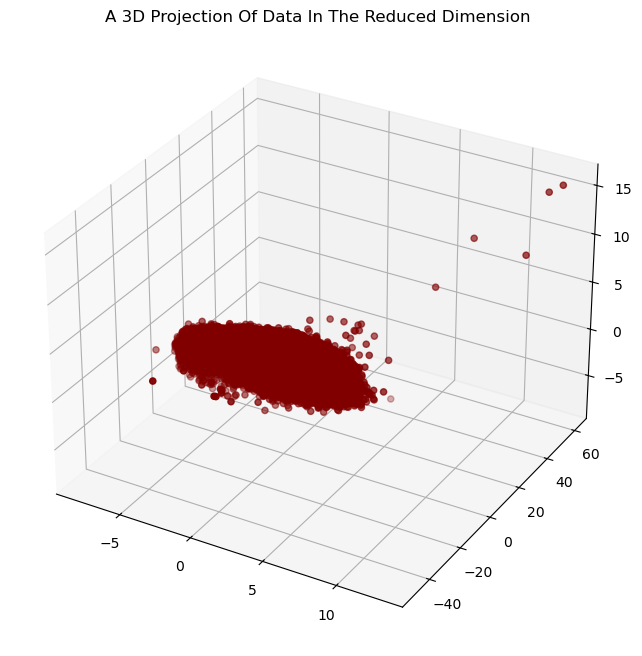

In [73]:
#@markdown
x =pca_df['kolom1']
y =pca_df['kolom2']
z =pca_df['kolom3']

# To plot
fig = plt.figure(figsize=(10,8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x,y,z, c="maroon", marker="o" )
ax.set_title("A 3D Projection Of Data In The Reduced Dimension")
plt.show()

# **Modeling**

In [74]:
#@markdown
from sklearn.cluster import KMeans, DBSCAN, MeanShift, estimate_bandwidth
from sklearn.metrics import silhouette_score

## **K-Means Clustering**

###**Elbow Method**

Elbow Method to determine the number of clusters to be formed:


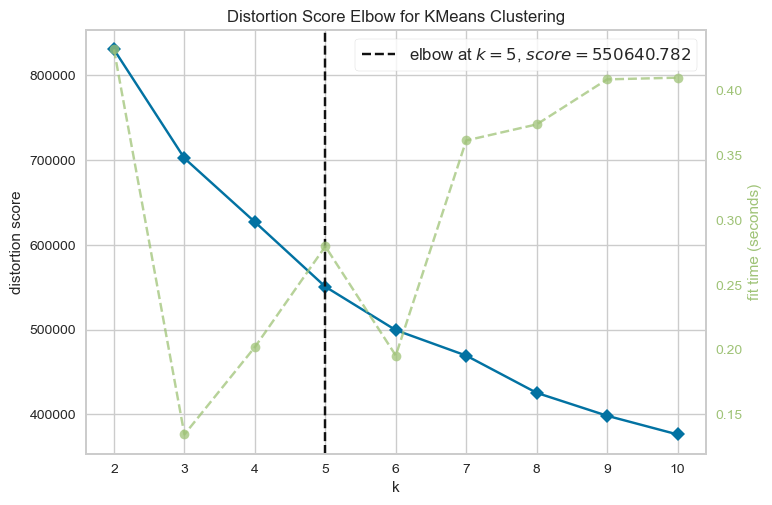

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [75]:
#@markdown
from yellowbrick.cluster import KElbowVisualizer

# Quick examination of elbow method to find numbers of clusters to make.
print('Elbow Method to determine the number of clusters to be formed:')
Elbow_M = KElbowVisualizer(KMeans(random_state=42), k=10)
Elbow_M.fit(pca_df.copy())
Elbow_M.show()

###**Penambahkan Label Klaster**

In [76]:
#@markdown
#Terapkan KMeans clustering
pca_df_1 = pca_df.copy()
num_clusters = 5  # Tentukan jumlah kluster
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
kmeans.fit(pca_df_1)

KMeans(n_clusters=5, random_state=42)

### **Evaluation**

In [77]:
# import matplotlib.cm as cm
# from sklearn.metrics import silhouette_samples, silhouette_score

# plt.figure(figsize=(12, 7))
# plt.xlim([-0.1, 1])
# plt.ylim([0, len(scaled_user) + (num_clusters + 1) * 10])

# cluster_labels = kmeans.labels_

# silhouette_avg = silhouette_score(scaled_user, cluster_labels)
# print("For n_clusters =", num_clusters, "The average silhouette_score is :", silhouette_avg)

# # Compute the silhouette scores for each sample
# sample_silhouette_values = silhouette_samples(scaled_user, cluster_labels)

# y_lower = 10
# for i in range(num_clusters):
#     ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
#     ith_cluster_silhouette_values.sort()

#     size_cluster_i = ith_cluster_silhouette_values.shape[0]
#     y_upper = y_lower + size_cluster_i

#     color = cm.nipy_spectral(float(i) / num_clusters)
#     plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor=color, edgecolor=color, alpha=0.7)

#     # Label the silhouette plots with their cluster numbers at the middle
#     plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

#     # Compute the new y_lower for next plot
#     y_lower = y_upper + 10  # 10 for the 0 samples

# plt.title("The silhouette plot for the various clusters.")
# plt.xlabel("The silhouette coefficient values")
# plt.ylabel("Cluster label")

# plt.axvline(x=silhouette_avg, color="red", linestyle="--")

# plt.yticks([])
# plt.xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

### **Pusat Klaster**

In [78]:
#@markdown
print("Cluster Centers:")
kmeans.cluster_centers_

Cluster Centers:


array([[-0.09825311,  1.52125628, -0.05710042],
       [ 2.12048554, -0.0991412 , -0.14488433],
       [ 0.06399897, -0.57226384, -0.95618446],
       [-0.07259621, -0.19062837,  1.12391831],
       [-2.49078883, -0.11776225, -0.11525553]])

### **Distribusi Klaster**

In [79]:
#@markdown
pca_df_1['Cluster'] = kmeans.labels_
print("Cluster Distribution:")
pca_df_1['Cluster'].value_counts()

Cluster Distribution:


Cluster
3    52728
1    48924
2    47766
4    40154
0    30732
Name: count, dtype: int64

### **3D Visualization**

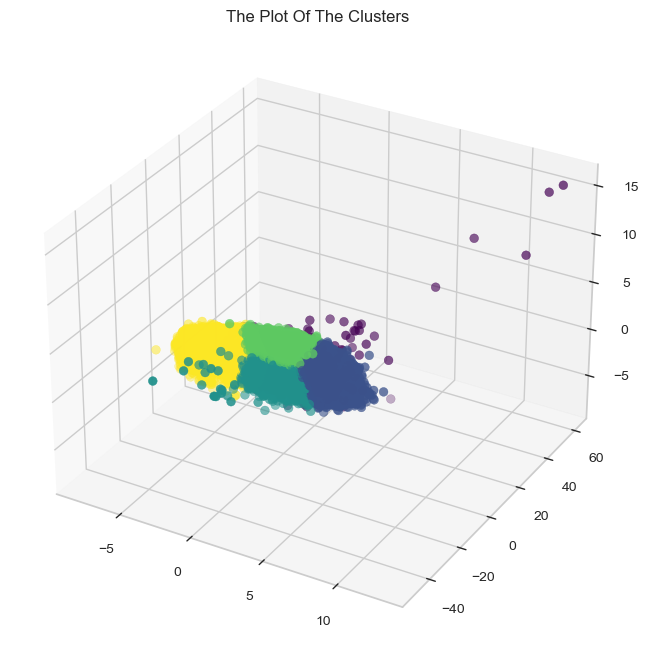

In [80]:
#@markdown
fig = plt.figure(figsize=(10,8))
ax = plt.subplot(111, projection='3d', label="bla")
ax.scatter(x, y, z, s=40, c=pca_df_1["Cluster"], marker='o', cmap = 'viridis')
ax.set_title("The Plot Of The Clusters")
plt.show()

###**2D Visualization**

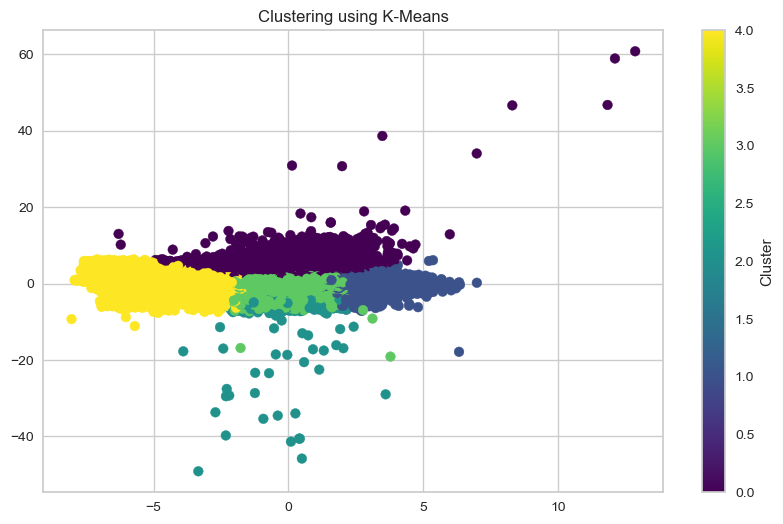

In [81]:
#@markdown
plt.figure(figsize=(10, 6))
plt.scatter(x, y, c=pca_df_1['Cluster'], cmap='viridis')
plt.title('Clustering using K-Means')
plt.colorbar(label='Cluster')
plt.show()

## **DBSCAN Clustering**

In [82]:
#@markdown
# Terapkan DBSCAN clustering
pca_df_DB = pca_df.copy()
m_DB = DBSCAN()

### **Evaluation**

In [83]:
# plt.figure(figsize=(12, 7))
# plt.xlim([-0.1, 1])
# plt.ylim([0, len(scaled_user) + (num_clusters + 1) * 10])

# cluster_labels = m_DB.fit_predict(pca_df_DB)

# silhouette_avg = silhouette_score(scaled_user, cluster_labels)
# print("For n_clusters =", num_clusters, "The average silhouette_score is :", silhouette_avg)

# # Compute the silhouette scores for each sample
# sample_silhouette_values = silhouette_samples(scaled_user, cluster_labels)

# y_lower = 10
# for i in range(num_clusters):
#     ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
#     ith_cluster_silhouette_values.sort()

#     size_cluster_i = ith_cluster_silhouette_values.shape[0]
#     y_upper = y_lower + size_cluster_i

#     color = cm.nipy_spectral(float(i) / num_clusters)
#     plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor=color, edgecolor=color, alpha=0.7)

#     # Label the silhouette plots with their cluster numbers at the middle
#     plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

#     # Compute the new y_lower for next plot
#     y_lower = y_upper + 10  # 10 for the 0 samples

# plt.title("The silhouette plot for the various clusters.")
# plt.xlabel("The silhouette coefficient values")
# plt.ylabel("Cluster label")

# plt.axvline(x=silhouette_avg, color="red", linestyle="--")

# plt.yticks([])
# plt.xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

###**Penambahkan Label Klaster**

In [84]:
# Tambahkan label kluster ke DataFrame hasil PCA
pca_df_DB['Cluster'] = m_DB.fit_predict(pca_df_DB)

# Tampilkan beberapa baris pertama dari DataFrame dengan label kluster
pca_df_DB

,kolom1,kolom2,kolom3,Cluster
0,0.9558460536085074,-0.8664468497233387,-2.7994573029913177,0
1,-0.1327619466786847,-0.13556960965875467,-3.523478126709801,0
2,1.7684083623835871,-1.8811181283368545,-2.5678435419463077,0
3,-0.8264652203900203,-1.443527408996209,-2.3465451968513924,0
4,-2.0661180481352774,-1.6813055076612284,-3.201372227469928,0
...,...,...,...,...
220299,2.023731610150726,0.3214504968888326,2.6480808155274524,0
220300,2.303921695898158,-0.23739294620830195,2.6269067470337446,0
220301,-0.3304833081179246,0.2247713366820644,2.0728532073312596,0
220302,0.3627817761407026,0.25174378277984527,0.7192134410291755,0


### **Distribusi Klaster**

In [85]:
#@markdown
print("Cluster Distribution:")
pca_df_DB['Cluster'].value_counts()

Cluster Distribution:


Cluster
 0     218976
-1       1039
 2        140
 15        17
 4         11
 22         8
 13         8
 7          8
 5          8
 8          7
 20         7
 9          7
 16         6
 17         6
 1          6
 19         5
 25         5
 14         5
 10         5
 12         5
 11         4
 18         4
 21         4
 6          4
 3          3
 24         3
 23         3
Name: count, dtype: int64

### **3D Visualization**

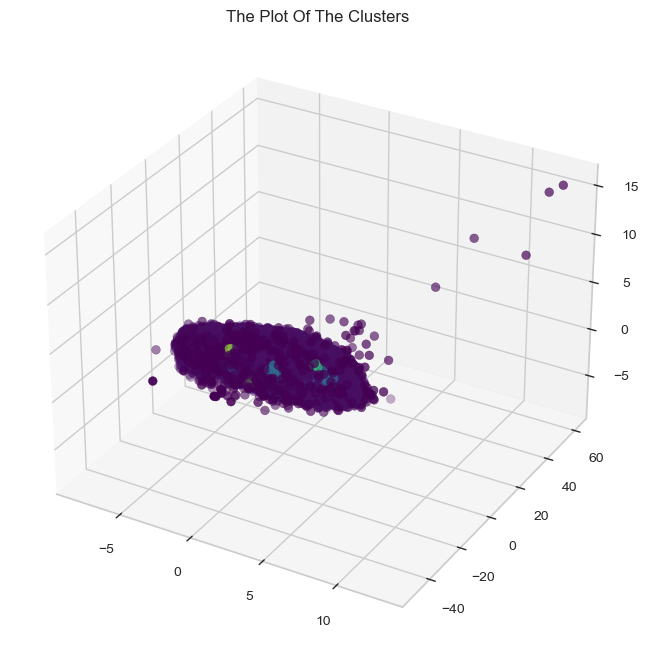

In [86]:
#@markdown
fig = plt.figure(figsize=(10,8))
ax = plt.subplot(111, projection='3d', label="bla")
ax.scatter(x, y, z, s=40, c=pca_df_DB["Cluster"], marker='o', cmap = 'viridis')
ax.set_title("The Plot Of The Clusters")
plt.show()

###**2D Visualization**

In [87]:
#@markdown
# X_db = pca_df_DB[['kolom1', 'kolom2']]

# # Terapkan DBSCAN
# m_DB = DBSCAN()

# # Tambahkan label cluster ke dalam data
# user_DB = user.copy()
# user_DB['cluster'] = m_DB.fit_predict(X_db)

# # Visualisasikan hasil clustering
# plt.figure(figsize=(10, 6))
# plt.scatter(x, y, c=user_DB['cluster'], cmap='viridis')
# plt.title('Clustering using DBSCAN')
# plt.colorbar(label='Cluster')
# plt.show()

## **Mean Shift**

###**Penambahkan Label Klaster**

In [88]:
#@markdown
# Terapkan Mean Shift clustering
pca_df_ms = pca_df.copy()

bandwidth = estimate_bandwidth(pca_df_ms, quantile=0.2, n_samples=1000)

ms = MeanShift(bandwidth=bandwidth, bin_seeding=True)
ms.fit(pca_df_ms)

MeanShift(bandwidth=1.9041635959062193, bin_seeding=True)

### **Evaluation**

In [89]:
# plt.figure(figsize=(12, 7))
# plt.xlim([-0.1, 1])
# plt.ylim([0, len(scaled_user) + (num_clusters + 1) * 10])

# cluster_labels = ms.labels_

# silhouette_avg = silhouette_score(scaled_user, cluster_labels)
# print("For n_clusters =", num_clusters, "The average silhouette_score is :", silhouette_avg)

# # Compute the silhouette scores for each sample
# sample_silhouette_values = silhouette_samples(scaled_user, cluster_labels)

# y_lower = 10
# for i in range(num_clusters):
#     ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
#     ith_cluster_silhouette_values.sort()

#     size_cluster_i = ith_cluster_silhouette_values.shape[0]
#     y_upper = y_lower + size_cluster_i

#     color = cm.nipy_spectral(float(i) / num_clusters)
#     plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor=color, edgecolor=color, alpha=0.7)

#     # Label the silhouette plots with their cluster numbers at the middle
#     plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

#     # Compute the new y_lower for next plot
#     y_lower = y_upper + 10  # 10 for the 0 samples

# plt.title("The silhouette plot for the various clusters.")
# plt.xlabel("The silhouette coefficient values")
# plt.ylabel("Cluster label")

# plt.axvline(x=silhouette_avg, color="red", linestyle="--")

# plt.yticks([])
# plt.xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

### **Pusat Klaster**

In [90]:
#@markdown
print("Cluster Centers:")
ms.cluster_centers_

Cluster Centers:


array([[ 1.15664593e-01,  3.57520180e-02,  7.27421877e-02],
       [-9.54757178e-01,  5.52511754e+00, -1.89595646e+00],
       [-6.48805970e+00,  5.16648022e+00, -2.89518360e+00],
       [ 1.10995698e+00,  9.52566856e+00, -1.91264062e+00],
       [ 3.44644741e+00,  1.44738972e+01,  3.04955015e+00],
       [ 3.71631739e+00,  9.68493177e+00,  1.36352772e+00],
       [ 1.51028443e+00, -1.69497206e+01,  9.73102906e-01],
       [-2.01026439e+00, -2.87493832e+01,  2.26467991e+00],
       [ 1.61983914e+00, -1.20764698e+01, -1.02833904e+00],
       [ 9.58440688e-01,  1.72127409e+01, -1.50648207e+00],
       [ 3.06042967e-01, -4.08316220e+01,  3.00888780e+00],
       [-2.68597916e-01, -2.31134778e+01,  3.00558616e-01],
       [-6.74291247e-02, -3.42666495e+01,  1.64583547e+00],
       [-2.53952919e-01, -1.86005126e+01,  2.57340604e+00],
       [-1.81813040e+00, -3.45358522e+01,  4.02858583e+00],
       [-3.68422283e+00,  9.70936701e+00, -2.44327492e+00],
       [ 1.28673926e+01,  6.07497220e+01

In [91]:
# Tambahkan label kluster ke DataFrame hasil PCA
pca_df_ms['Cluster'] = ms.labels_

# Tampilkan beberapa baris pertama dari DataFrame dengan label kluster
pca_df_ms

,kolom1,kolom2,kolom3,Cluster
0,0.9558460536085074,-0.8664468497233387,-2.7994573029913177,0
1,-0.1327619466786847,-0.13556960965875467,-3.523478126709801,0
2,1.7684083623835871,-1.8811181283368545,-2.5678435419463077,0
3,-0.8264652203900203,-1.443527408996209,-2.3465451968513924,0
4,-2.0661180481352774,-1.6813055076612284,-3.201372227469928,0
...,...,...,...,...
220299,2.023731610150726,0.3214504968888326,2.6480808155274524,0
220300,2.303921695898158,-0.23739294620830195,2.6269067470337446,0
220301,-0.3304833081179246,0.2247713366820644,2.0728532073312596,0
220302,0.3627817761407026,0.25174378277984527,0.7192134410291755,0


### **Distribusi Klaster**

In [92]:
#@markdown
print("Cluster Distribution:")
pca_df_ms['Cluster'].value_counts()

Cluster Distribution:


Cluster
0     216577
1       1645
2        904
43       376
3        189
45       158
29       139
25       114
35        50
23        31
5         22
15        15
8         10
36         9
4          9
9          5
6          4
7          4
48         4
11         3
10         3
40         3
12         2
13         2
14         2
21         1
34         1
39         1
38         1
17         1
46         1
32         1
42         1
47         1
41         1
19         1
22         1
37         1
31         1
20         1
24         1
16         1
28         1
33         1
26         1
27         1
18         1
30         1
44         1
Name: count, dtype: int64

### **3D Visualization**

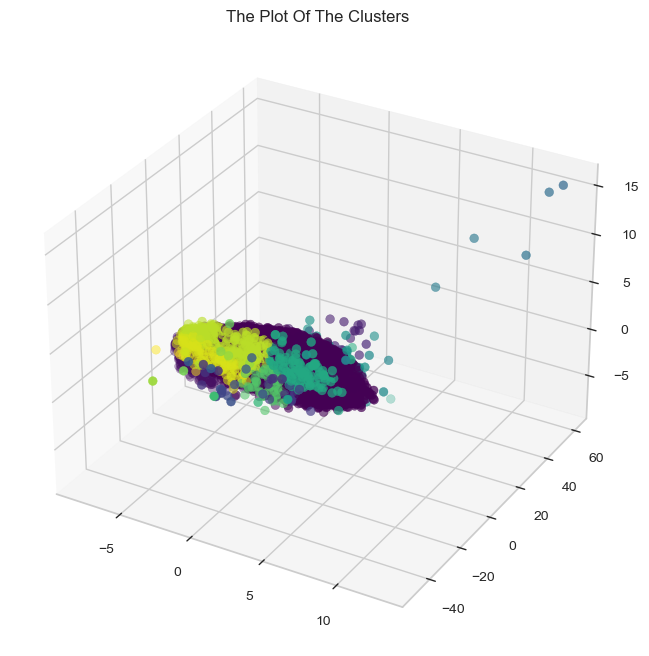

In [93]:
#@markdown
fig = plt.figure(figsize=(10,8))
ax = plt.subplot(111, projection='3d', label="bla")
ax.scatter(x, y, z, s=40, c=pca_df_ms["Cluster"], marker='o', cmap = 'viridis')
ax.set_title("The Plot Of The Clusters")
plt.show()

###**2D Visualization**

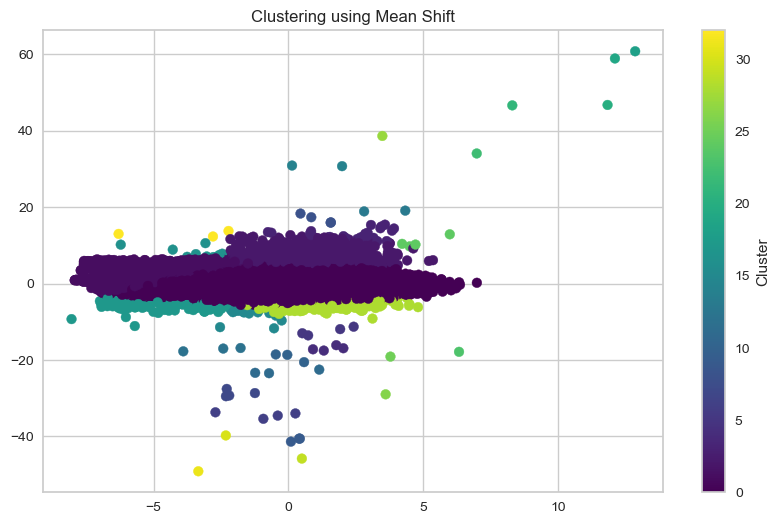

In [94]:
#@markdown
X_ms = pca_df_ms[['kolom1', 'kolom2']]
# Terapkan Mean Shift
ms = MeanShift(bandwidth=bandwidth, bin_seeding=True)
ms.fit(X_ms)

# Tambahkan label cluster ke dalam data
user_ap = user.copy()
user_ap['cluster'] = ms.labels_

# Visualisasikan hasil clustering
plt.figure(figsize=(10, 6))
plt.scatter(x, y, c=user_ap['cluster'], cmap='viridis')
plt.title('Clustering using Mean Shift')
plt.colorbar(label='Cluster')
plt.show()

In [95]:
user_1 = user.copy()
user_1['cluster'] = kmeans.labels_

#**Profiling**

##**Cluster Distribution**

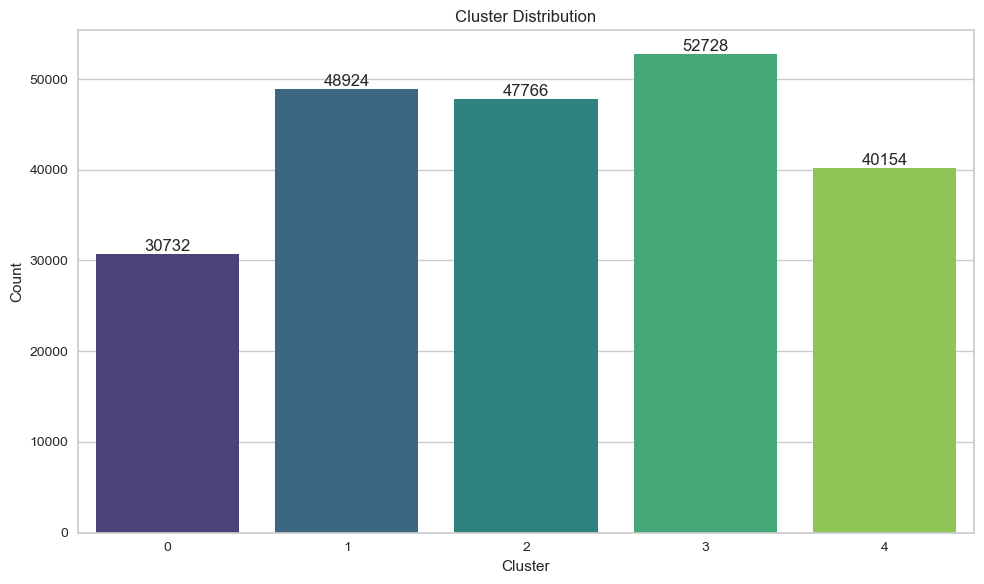

In [96]:
#@markdown
cluster_counts = user_1.groupby('cluster')['user_id'].count()

plt.figure(figsize=(10, 6))
sns.barplot(x=cluster_counts.index, y=cluster_counts.values, palette='viridis')
plt.xlabel('Cluster')
plt.ylabel('Count')
plt.title('Cluster Distribution')

for index, value in enumerate(cluster_counts):
    plt.text(index, value +1, str(value), ha='center', va='bottom')

plt.tight_layout()
plt.show()

## **Cluster Profiling by Total Transaction**

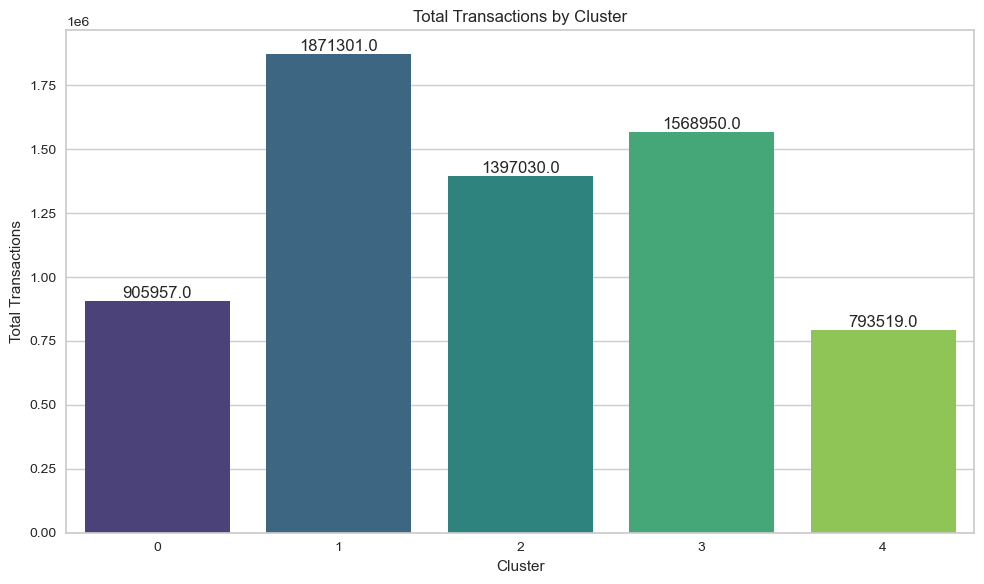

In [97]:
#@markdown
total_transactions_per_cluster = user_1.groupby('cluster')['total transactions'].sum()

plt.figure(figsize=(10, 6))
sns.barplot(x=total_transactions_per_cluster.index, y=total_transactions_per_cluster.values, palette='viridis')
plt.xlabel('Cluster')
plt.ylabel('Total Transactions')
plt.title('Total Transactions by Cluster')

for index, value in enumerate(total_transactions_per_cluster):
    plt.text(index, value + 1, str(value), ha='center', va='bottom')

plt.tight_layout()
plt.show()

###**Money Spent Statistics by Cluster**

<Figure size 1000x600 with 0 Axes>

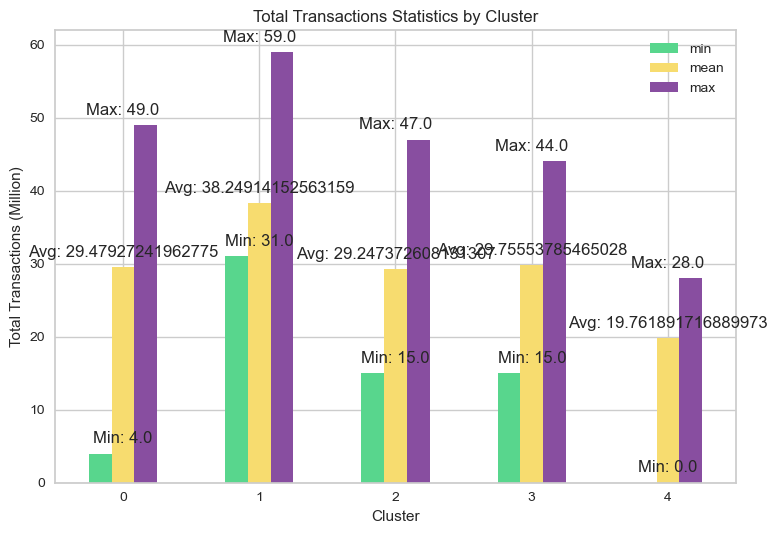

In [98]:
#@markdown
def millions_format(value):
    return value

# Calculate statistics for each cluster (assuming you still need them)
total_transactions_per_cluster = user_1.groupby('cluster')['total transactions'].agg(['min', 'mean', 'max'])

# Create a color palette for the bars
colors = ['#58D68D', '#F7DC6F', '#884EA0']

plt.figure(figsize=(10, 6))
total_transactions_per_cluster.plot(kind='bar', stacked=False, color=colors)
plt.xlabel('Cluster')
plt.ylabel('Total Transactions (Million)')  # Update label for millions
plt.title('Total Transactions Statistics by Cluster')

# Loop through index and access corresponding values
for index, row in total_transactions_per_cluster.iterrows():
    min_label = row['min']
    mean_label = row['mean']
    max_label = row['max']
    # Add labels for other statistics as needed (e.g., mean, min)
    plt.text(index, row['min'] + 1, f"Min: {min_label}", ha='center', va='bottom')
    plt.text(index, row['mean'] + 1, f"Avg: {mean_label}", ha='center', va='bottom')
    plt.text(index, row['max'] + 1, f"Max: {max_label}", ha='center', va='bottom')

plt.xticks(rotation=0)  # Rotate x-axis labels for better readability
plt.tight_layout()
plt.show()

## **Cluster Profiling by Money Spent**

###**Money Spent by Cluster**

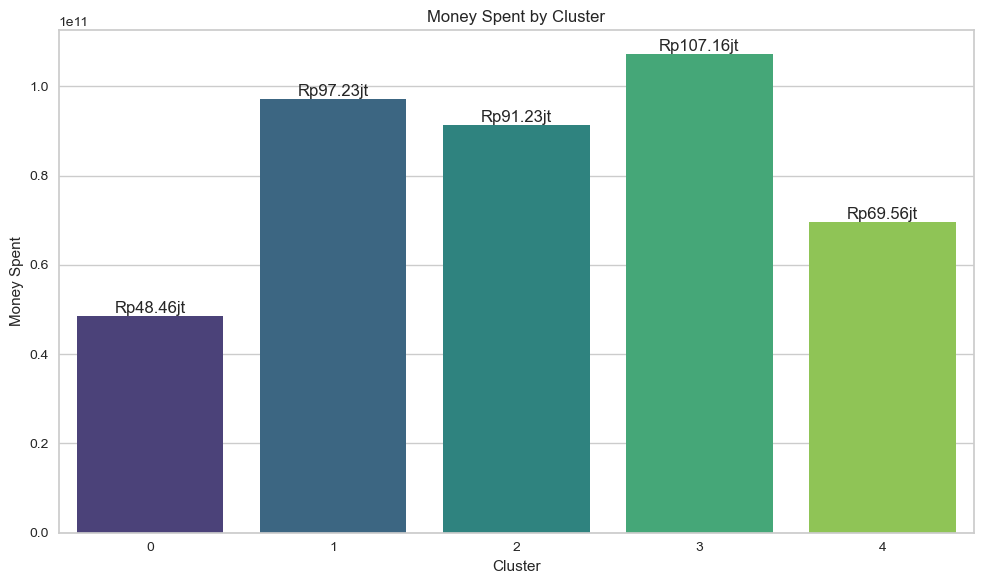

In [99]:
#@markdown
ms_per_cluster = user_1.groupby('cluster')['money_spent'].sum()

plt.figure(figsize=(10, 6))
sns.barplot(x=ms_per_cluster.index, y=ms_per_cluster.values, palette='viridis')
plt.xlabel('Cluster')
plt.ylabel('Money Spent')
plt.title('Money Spent by Cluster')

for index, value in enumerate(ms_per_cluster):
    plt.text(index, value + 1, str("Rp{:,.2f}jt".format(value / 1000000000)), ha='center', va='bottom')

plt.tight_layout()
plt.show()

###**Money Spent Statistics by Cluster**

<Figure size 1000x600 with 0 Axes>

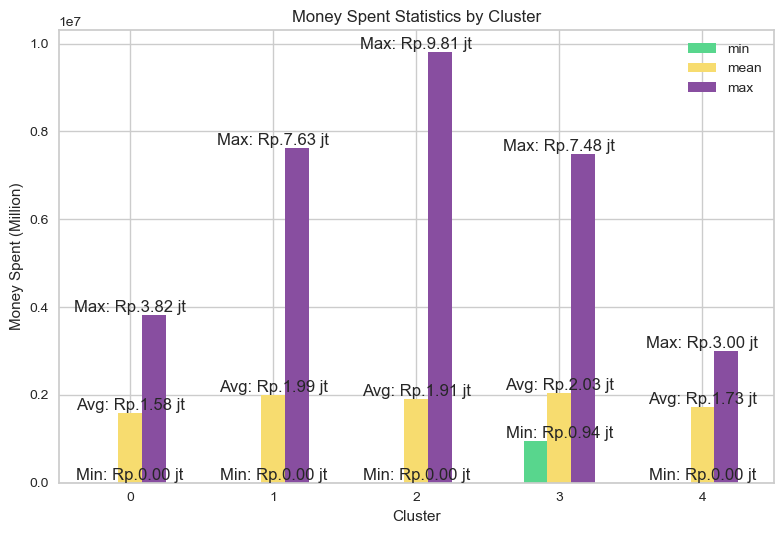

In [100]:
#@markdown
def millions_format(value):
    return "Rp.{:,.2f} jt".format(value / 1000000)

# Calculate statistics for each cluster (assuming you still need them)
money_spent_per_cluster = user_1.groupby('cluster')['money_spent'].agg(['min', 'mean', 'max'])

# Create a color palette for the bars
colors = ['#58D68D', '#F7DC6F', '#884EA0']

plt.figure(figsize=(10, 6))
money_spent_per_cluster.plot(kind='bar', stacked=False, color=colors)
plt.xlabel('Cluster')
plt.ylabel('Money Spent (Million)')  # Update label for millions
plt.title('Money Spent Statistics by Cluster')

# Loop through index and access corresponding values
for index, row in money_spent_per_cluster.iterrows():
    min_label = millions_format(row['min'])
    mean_label = millions_format(row['mean'])
    max_label = millions_format(row['max'])
    # Add labels for other statistics as needed (e.g., mean, min)
    plt.text(index, row['min'] + 1, f"Min: {min_label}", ha='center', va='bottom')
    plt.text(index, row['mean'] + 1, f"Avg: {mean_label}", ha='center', va='bottom')
    plt.text(index, row['max'] + 1, f"Max: {max_label}", ha='center', va='bottom')

plt.xticks(rotation=0)  # Rotate x-axis labels for better readability
plt.tight_layout()
plt.show()

##**Total Transactions vs Money Spent**

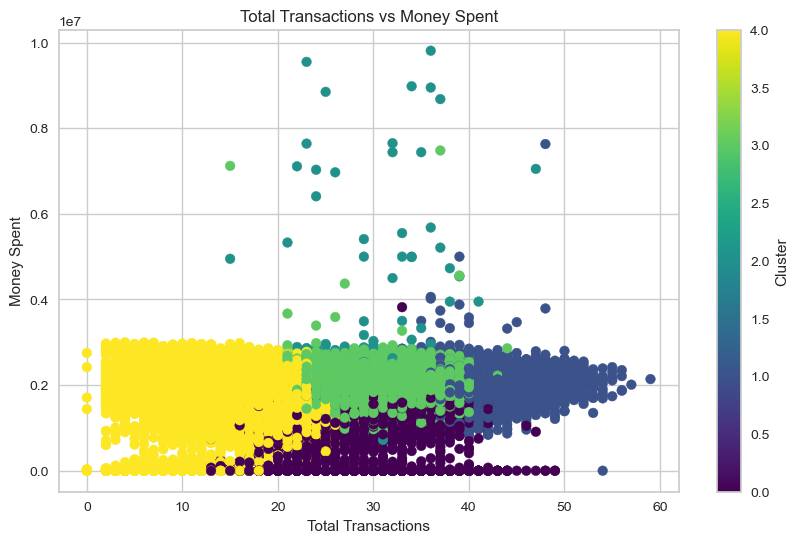

In [101]:
#@markdown
plt.figure(figsize=(10, 6))
plt.scatter(user_1['total transactions'], user_1['money_spent'], c=user_1['cluster'], cmap='viridis')
plt.xlabel('Total Transactions')
plt.ylabel('Money Spent')
plt.title('Total Transactions vs Money Spent')
plt.colorbar(label='Cluster')
plt.show()

#**Evaluation**

##**Province**

###**Cluster Counts by Province**

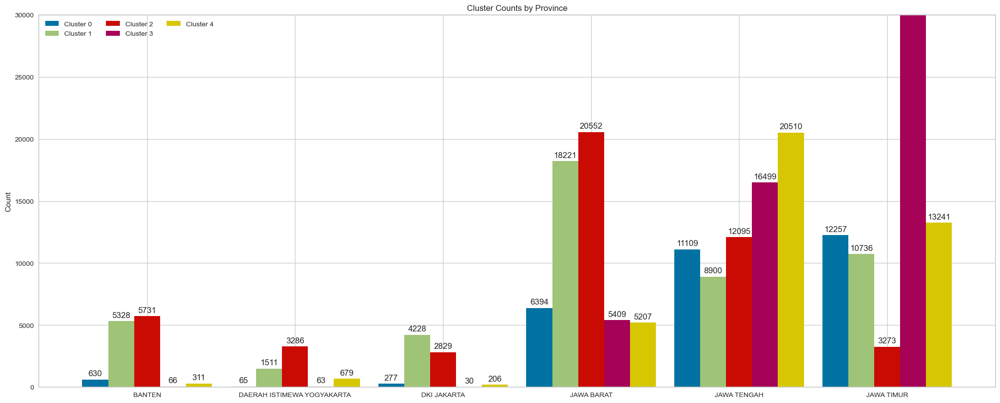

In [102]:
#@markdown
cluster_counts_prov = user_1.groupby(['nama provinsi', 'cluster'])['cluster'].value_counts().unstack(fill_value=0)

province_names = cluster_counts_prov.index.get_level_values('nama provinsi').tolist()

x = np.arange(len(province_names))  # the label locations
width = 0.175  # the width of the bars
multiplier = 0

fig, ax = plt.subplots(layout='constrained', figsize=(20,8))

for attribute, measurement in cluster_counts_prov.items():
    offset = width * multiplier
    rects = ax.bar(x + offset, measurement, width, label=f'Cluster {attribute}')
    ax.bar_label(rects, padding=3)
    multiplier += 1

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Count')
ax.set_title('Cluster Counts by Province')
ax.set_xticks(x + width * (multiplier - 1) / 2, province_names)
ax.legend(loc='upper left', ncols=3)
ax.set_ylim(0, 30000)

plt.show()

###**Total Transactions by Province for each Cluster**

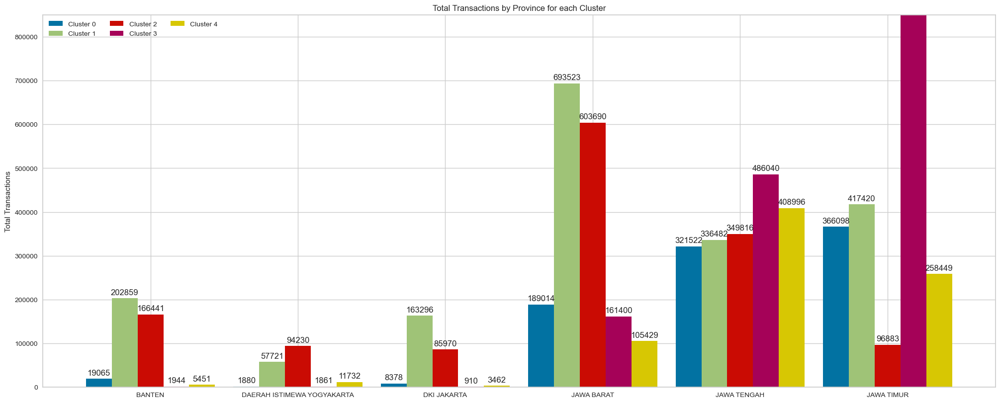

In [103]:
#@markdown
cluster_counts_prov_trans = user_1.groupby(['nama provinsi', 'cluster'])['total transactions'].sum().unstack(fill_value=0)

province_names = cluster_counts_prov_trans.index.get_level_values('nama provinsi').tolist()

x = np.arange(len(province_names))  # the label locations
width = 0.175  # the width of the bars
multiplier = 0

fig, ax = plt.subplots(layout='constrained', figsize=(20,8))

for attribute, measurement in cluster_counts_prov_trans.items():
    offset = width * multiplier
    rects = ax.bar(x + offset, measurement, width, label=f'Cluster {attribute}')
    ax.bar_label(rects, padding=3)
    multiplier += 1

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Total Transactions')
ax.set_title('Total Transactions by Province for each Cluster')
ax.set_xticks(x + width * (multiplier - 1) / 2, province_names)
ax.legend(loc='upper left', ncols=3)
ax.set_ylim(0, 850000)

plt.show()

###**Money Spent by Province for each Cluster**

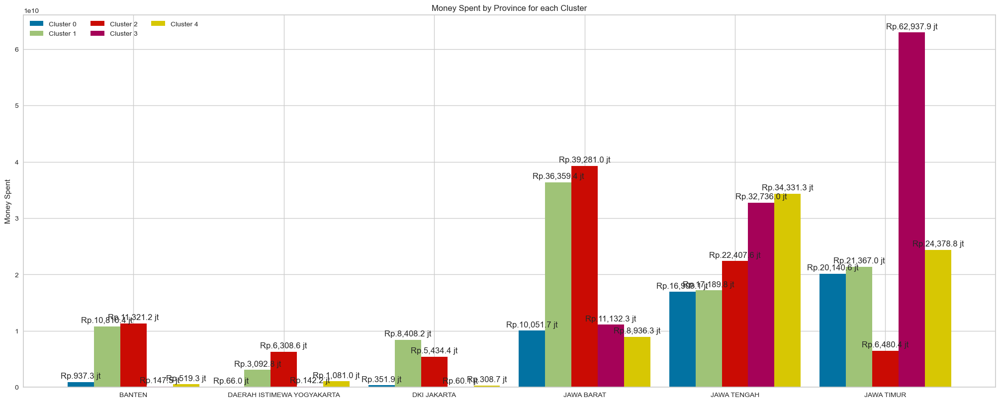

In [104]:
#@markdown
cluster_counts_prov_mon = user_1.groupby(['nama provinsi', 'cluster'])['money_spent'].sum().unstack(fill_value=0)

province_names = cluster_counts_prov_mon.index.get_level_values('nama provinsi').tolist()

x = np.arange(len(province_names))  # the label locations
width = 0.175  # the width of the bars
multiplier = 0
cluster_colors = plt.cm.tab20.colors

fig, ax = plt.subplots(layout='constrained', figsize=(20,8))

def custom_label_format(value):
    value = value/1000000
    return f"Rp.{value:,.1f} jt"

for attribute, measurement in cluster_counts_prov_mon.items():
    offset = width * multiplier
    rects = ax.bar(x + offset, measurement, width, label=f'Cluster {attribute}')
    formatted_labels = [custom_label_format(val) for val in measurement]
    ax.bar_label(rects, labels=formatted_labels, padding=3)
    multiplier += 1

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Money Spent')
ax.set_title('Money Spent by Province for each Cluster')
ax.set_xticks(x + width * (multiplier - 1) / 2, province_names)
ax.legend(loc='upper left', ncols=3)
# ax.set_ylim(0, 85000000)

plt.show()

## **Gender**

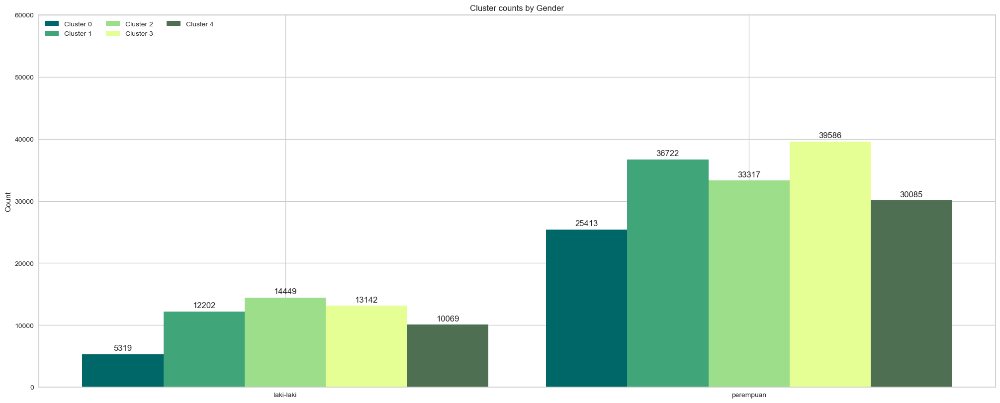

In [105]:
#@markdown
cluster_gen = user_1.groupby(['gender', 'cluster'])['cluster'].count().unstack(fill_value=0)

gender_names = cluster_gen.index.get_level_values('gender').tolist()

x = np.arange(len(gender_names))  # the label locations
width = 0.175  # the width of the bars
multiplier = 0

colors = ['#006769', '#40A578', '#9DDE8B', '#E6FF94', '#4F6F52']
fig, ax = plt.subplots(layout='constrained', figsize=(20,8))

for attribute, measurement in cluster_gen.items():
    offset = width * multiplier
    rects = ax.bar(x + offset, measurement, width, label=f'Cluster {attribute}', color=colors[multiplier])
    ax.bar_label(rects, padding=3)
    multiplier += 1

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Count')
ax.set_title('Cluster counts by Gender')
ax.set_xticks(x + width * (multiplier - 1) / 2, gender_names)
ax.legend(loc='upper left', ncols=3)
ax.set_ylim(0, 60000)

plt.show()

## **Age Group**

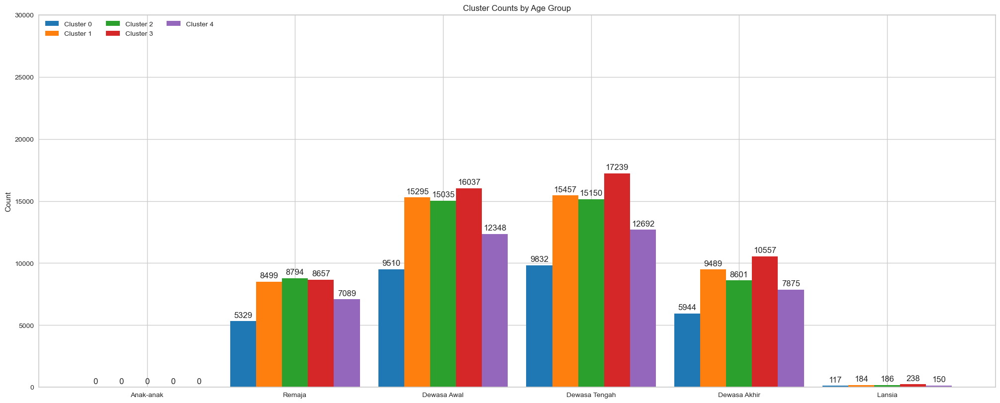

In [106]:
#@markdown
# Mengelompokkan data berdasarkan 'age_group' dan 'cluster'
cluster_counts_age = user_1.groupby(['age_group', 'cluster'])['cluster'].value_counts().unstack(fill_value=0)

ages = cluster_counts_age.index.get_level_values('age_group').tolist()

x = np.arange(len(ages))
width = 0.175
multiplier = 0

fig, ax = plt.subplots(layout='constrained', figsize=(20, 8))
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b']

# Plotting setiap cluster dalam kategori usia
for i, (attribute, measurement) in enumerate(cluster_counts_age.items()):
    offset = width * multiplier
    rects = ax.bar(x + offset, measurement, width, label=f'Cluster {attribute}', color=colors[i % len(colors)])
    ax.bar_label(rects, padding=3)
    multiplier += 1

ax.set_ylabel('Count')
ax.set_title('Cluster Counts by Age Group')
ax.set_xticks(x + width * (multiplier - 1) / 2, ages)
ax.legend(loc='upper left', ncols=3)
ax.set_ylim(0, 30000)

plt.show()

In [107]:
user_1['Fashion'] = user_1['Man Fashion'] + user_1['Woman Fashion']
user_1['Transportasi (Kereta, Pesawat, Kapal, Ride Hailing)'] = user_1['Ride Hailing'] + user_1['Transportasi (Kereta, Pesawat, Kapal)']

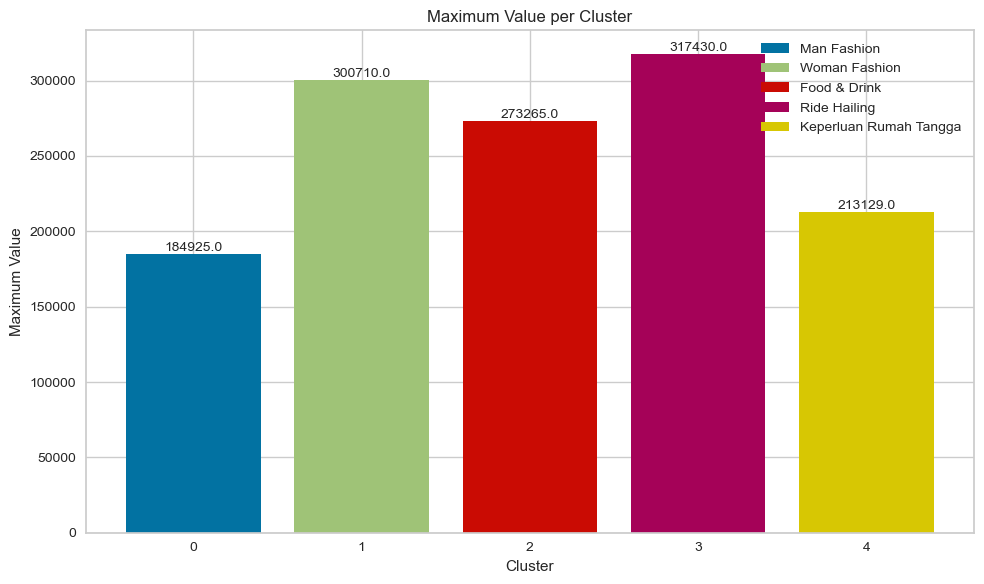

In [108]:
#@markdown
columms_cat_items = ['Man Fashion', 'Woman Fashion', 'Food & Drink', 'Ride Hailing', 'Keperluan Rumah Tangga', 'Travel', 'Keperluan Anak', 'Elektronik', 'Other', 'Transportasi (Kereta, Pesawat, Kapal)',
                     'Top Up Game', 'Otomotif', 'Pulsa', 'Kesehatan', 'Investasi', 'Sewa Motor/Mobil', 'Hotel', 'Tagihan (WIFI, PLN)', 'Fashion', 'Transportasi (Kereta, Pesawat, Kapal, Ride Hailing)']
grouped_data = user_1.groupby('cluster')[columms_cat_items].sum()
cluster_max_values, cluster_max_indices = grouped_data.max(axis=1), grouped_data.idxmax(axis=1)

plt.figure(figsize=(10,6))

bar_labels = []
for index, value in cluster_max_values.items():
  int_index = int(index)
  category_name = columms_cat_items[int_index]
  bar_labels.append(f"{category_name}")
  plt.bar(index, value, label=bar_labels[-1])  # Use the last appended label
  plt.text(index, value + 0.1, str(value), ha='center', va='bottom', fontsize=10)

# Add legend with labels
plt.legend(bar_labels)

plt.xlabel("Cluster")
plt.ylabel("Maximum Value")
plt.title("Maximum Value per Cluster")
plt.tight_layout()
plt.show()

In [109]:
import datetime as dt
today_date = dt.datetime(2025, 1, 1)

In [110]:
history = history[~history['user_id'].isin(['SC3371011009009', 'SC3525122021001'])]

In [111]:
unique_transactions_per_user = history.groupby(['user_id', pd.Grouper(key='transaction_date', freq='D')])['transaction_date'].count().unstack().fillna(0).max(axis=1)

In [112]:
recent_transactions = history.groupby('user_id')['transaction_date'].max()
recent_transactions = (today_date - recent_transactions)

In [113]:
days_since_last_transaction = recent_transactions.dt.days.fillna(0).astype(int)

In [114]:
df_rfm = pd.DataFrame({
    'recency': days_since_last_transaction.values,
    'frequency': user_1['total transactions'],
    "monetary": user_1['money_spent']
})

In [115]:
df_rfm

,recency,frequency,monetary
0,20,32.0,"1,790,000.0"
1,2,28.0,"1,510,000.0"
2,16,35.0,"2,360,000.0"
3,6,25.0,"1,770,000.0"
4,12,20.0,"1,629,999.9999999998"
...,...,...,...
241644,6,40.0,"2,040,000.0"
241645,4,42.0,"2,160,000.0"
241646,28,30.0,"1,840,000.0"
241647,10,32.0,"1,689,999.9999999998"


In [116]:
df_rfm.describe().T

,count,mean,std,min,25%,50%,75%,max
recency,"220,304.0",12.536581269518484,13.12090927397354,1.0,4.0,9.0,17.0,322.0
frequency,"220,304.0",29.671531156946763,6.870637357897668,0.0,25.0,30.0,34.0,59.0
monetary,"220,304.0","1,877,537.0397269228","356,838.23518218455",0.0,"1,689,999.9999999998","1,910,000.0","2,110,000.0","9,810,000.0"


In [117]:
percentile_percentages = [0, 0.2, 0.4, 0.6, 0.8, 1]
custom_bins = [np.array(percentile_percentages) * df_rfm[col].max() for col in ['frequency']]

for col, bin_edges in zip(['frequency'], custom_bins):
    labels = list(range(1, len(bin_edges)))

    def assign_score(value):
        # Find the index of the first bin edge that is greater than or equal to the value
        idx = np.searchsorted(bin_edges, value, side='right') - 1
        return labels[min(idx, len(labels) - 1)]  # Handle potential out-of-range values

    df_rfm[f"{col}_score"] = df_rfm[col].apply(assign_score)

In [118]:
df_rfm["recency_score"] = pd.qcut(df_rfm['recency'], 5, labels=[5, 4, 3, 2, 1])

# Calculate frequency score based on rank quantiles, assigning labels from 1 to 5 (1 being lowest frequency)
df_rfm["monetary_score"] = pd.qcut(df_rfm["monetary"].rank(method="first"), 5, labels=[1, 2, 3, 4, 5])

In [119]:
df_rfm['segment'] = (df_rfm['recency_score'].astype(str) + df_rfm['frequency_score'].astype(str) + df_rfm['monetary_score'].astype(str)).astype('int64')
df_rfm

,recency,frequency,monetary,frequency_score,recency_score,monetary_score,segment
0,20,32.0,"1,790,000.0",3,2,2,232
1,2,28.0,"1,510,000.0",3,5,1,531
2,16,35.0,"2,360,000.0",3,2,5,235
3,6,25.0,"1,770,000.0",3,4,2,432
4,12,20.0,"1,629,999.9999999998",2,2,1,221
...,...,...,...,...,...,...,...
241644,6,40.0,"2,040,000.0",4,4,4,444
241645,4,42.0,"2,160,000.0",4,4,5,445
241646,28,30.0,"1,840,000.0",3,1,3,133
241647,10,32.0,"1,689,999.9999999998",3,3,2,332


In [120]:
Champion = [555, 554, 544, 545, 454, 455, 445]
Loyal_Customer = [543, 444, 435, 355, 354, 345, 344, 335]
Potential_Loyalist = [553, 551, 552, 541, 542, 533, 532, 531, 452, 451, 442, 441, 431, 453, 433, 432, 423, 353, 352, 351, 342, 341, 333, 323]
New_Customer = [512, 511, 422, 421, 412, 411, 311]
Promising = [525, 524, 523, 522, 521, 515, 514, 513, 425,424, 413,414,415, 315, 314, 313]
Need_Attention = [535, 534, 443, 434, 343, 334, 325, 324]
Cannot_Lose_Them = [155, 154, 144, 214,215,115, 114, 113]
About_to_Sleep = [331, 321, 312, 221, 213]
At_Risk = [255, 254, 245, 244, 253, 252, 243, 242, 235, 234, 225, 224, 153, 152, 145, 143, 142, 135, 134, 133, 125, 124]
Hibernating = [332, 322, 231, 241, 251, 233, 232, 223, 222, 132, 123, 122, 212, 211]
Lost = [111, 112, 121, 131, 141, 151]

# Create a function to assign customers to various customer segments based on RFM score
def assign_cust_seg(col):
    list_col = list(col)
    segment = list()
    for score in list_col:
        if score in Champion:
            value = 'Champion'
        elif score in Loyal_Customer:
            value = 'Loyal Customer'
        elif score in Potential_Loyalist:
            value = 'Potential Loyalist'
        elif score in New_Customer:
            value = 'New Customer'
        elif score in Promising:
            value = 'Promising'
        elif score in Need_Attention:
            value = 'Need Attention'
        elif score in Cannot_Lose_Them:
            value = 'Cannot Lose Them'
        elif score in About_to_Sleep:
            value = 'About to Sleep'
        elif score in At_Risk:
            value = 'At Risk'
        elif score in Hibernating:
            value = 'Hibernating'
        elif score in Lost:
            value = 'Lost'
        else:
            value = np.NaN
        segment.append(value)
    return segment

# Assign customers to segments based on their RFM score
df_rfm['segment'] = assign_cust_seg(df_rfm['segment'])
df_rfm

,recency,frequency,monetary,frequency_score,recency_score,monetary_score,segment
0,20,32.0,"1,790,000.0",3,2,2,Hibernating
1,2,28.0,"1,510,000.0",3,5,1,Potential Loyalist
2,16,35.0,"2,360,000.0",3,2,5,At Risk
3,6,25.0,"1,770,000.0",3,4,2,Potential Loyalist
4,12,20.0,"1,629,999.9999999998",2,2,1,About to Sleep
...,...,...,...,...,...,...,...
241644,6,40.0,"2,040,000.0",4,4,4,Loyal Customer
241645,4,42.0,"2,160,000.0",4,4,5,Champion
241646,28,30.0,"1,840,000.0",3,1,3,At Risk
241647,10,32.0,"1,689,999.9999999998",3,3,2,Hibernating


In [121]:
df_rfm = df_rfm[['recency','frequency','monetary','segment']]
df_rfm

,recency,frequency,monetary,segment
0,20,32.0,"1,790,000.0",Hibernating
1,2,28.0,"1,510,000.0",Potential Loyalist
2,16,35.0,"2,360,000.0",At Risk
3,6,25.0,"1,770,000.0",Potential Loyalist
4,12,20.0,"1,629,999.9999999998",About to Sleep
...,...,...,...,...
241644,6,40.0,"2,040,000.0",Loyal Customer
241645,4,42.0,"2,160,000.0",Champion
241646,28,30.0,"1,840,000.0",At Risk
241647,10,32.0,"1,689,999.9999999998",Hibernating


In [122]:
user_1['segment'] = df_rfm['segment'].copy()

In [123]:
# rfm_segment = user_1.groupby('cluster')['segment'].value_counts().unstack(fill_value=0).idxmax(axis=1)
# segment_counts = user_1.groupby('cluster')['segment'].value_counts().unstack(fill_value=0).max(axis=1)

# plt.figure(figsize=(10, 6))  # Adjust figure size for better readability

# rfm_segment.plot(kind='bar', colormap='tab20', label='Most Frequent Segment')
# segment_counts.plot(kind='bar', secondary_y=True, color='red', label='Count')

# plt.xlabel('Cluster')
# plt.ylabel('Most Frequent Segment')
# plt.title('Dominant Segments and Counts per Cluster (user_1)')
# plt.xticks(rotation=45, ha='right')

# plt.legend()  # Add legend to identify bars
# plt.tight_layout()
# plt.show()
# rfm_segment

In [124]:
rfm_trans=df_rfm[['recency','frequency','monetary']].copy()

In [125]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(rfm_trans)

StandardScaler()

Elbow Method to determine the number of clusters to be formed:


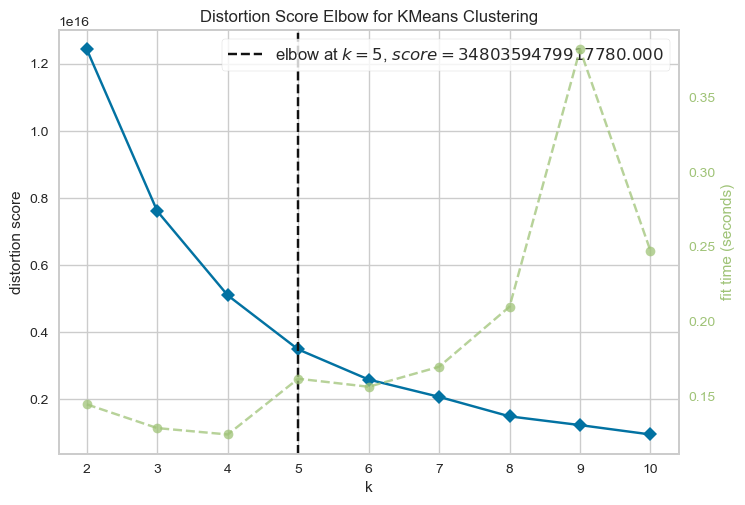

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [126]:
print('Elbow Method to determine the number of clusters to be formed:')
Elbow_M = KElbowVisualizer(KMeans(random_state=42), k=10)
Elbow_M.fit(rfm_trans)
Elbow_M.show()

In [127]:
#@markdown
#Terapkan KMeans clustering
num_clusters = 5  # Tentukan jumlah kluster
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
kmeans.fit(rfm_trans)

KMeans(n_clusters=5, random_state=42)

In [128]:
# plt.figure(figsize=(12, 7))
# plt.xlim([-0.1, 1])
# plt.ylim([0, len(scaled_user) + (num_clusters + 1) * 10])

# cluster_labels = kmeans.labels_

# silhouette_avg = silhouette_score(rfm_trans, cluster_labels)
# print("For n_clusters =", num_clusters, "The average silhouette_score is :", silhouette_avg)

# # Compute the silhouette scores for each sample
# sample_silhouette_values = silhouette_samples(rfm_trans, cluster_labels)

# y_lower = 10
# for i in range(num_clusters):
#     ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
#     ith_cluster_silhouette_values.sort()

#     size_cluster_i = ith_cluster_silhouette_values.shape[0]
#     y_upper = y_lower + size_cluster_i

#     color = cm.nipy_spectral(float(i) / num_clusters)
#     plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor=color, edgecolor=color, alpha=0.7)

#     # Label the silhouette plots with their cluster numbers at the middle
#     plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

#     # Compute the new y_lower for next plot
#     y_lower = y_upper + 10  # 10 for the 0 samples

# plt.title("The silhouette plot for the various clusters.")
# plt.xlabel("The silhouette coefficient values")
# plt.ylabel("Cluster label")

# plt.axvline(x=silhouette_avg, color="red", linestyle="--")

# plt.yticks([])
# plt.xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

In [129]:
# Tambahkan label kluster ke DataFrame hasil PCA
rfm_trans['Cluster'] = kmeans.labels_
# Tampilkan beberapa baris pertama dari DataFrame dengan label kluster
rfm_trans

,recency,frequency,monetary,Cluster
0,20,32.0,"1,790,000.0",0
1,2,28.0,"1,510,000.0",0
2,16,35.0,"2,360,000.0",1
3,6,25.0,"1,770,000.0",0
4,12,20.0,"1,629,999.9999999998",0
...,...,...,...,...
241644,6,40.0,"2,040,000.0",2
241645,4,42.0,"2,160,000.0",1
241646,28,30.0,"1,840,000.0",2
241647,10,32.0,"1,689,999.9999999998",0


In [130]:
user_1.set_index('user_id', inplace=True)

In [131]:
user_1['cluster_rfm'] = kmeans.labels_

In [132]:
user_1

,full_name,gender,money_spent,refund,wallet_balance,join_date,birth,nama provinsi,nama kabupaten,nama kecamatan,...,Top Up Game,"Transportasi (Kereta, Pesawat, Kapal)",Travel,Woman Fashion,total transactions,cluster,Fashion,"Transportasi (Kereta, Pesawat, Kapal, Ride Hailing)",segment,cluster_rfm
user_id,,,,,,,,,,,,,,,,,,,,,
SC3402052002003,ISDANIAR KHAFIYAH,perempuan,"1,790,000.0","200,000.0","450,000.0",2023-10-30,2003-09-20,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,BAMBANGLIPURO,...,0.0,0.0,4.0,3.0,32.0,2,7.0,2.0,Hibernating,0
SC3402052002005,DEBBY ORINBAO,perempuan,"1,510,000.0","300,000.0","470,000.0",2023-11-03,2005-02-28,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,BAMBANGLIPURO,...,0.0,0.0,2.0,3.0,28.0,2,5.0,4.0,Potential Loyalist,0
SC3402052002007,MUHAMMAD WENEHEN WIRATA,laki-laki,"2,360,000.0","130,000.0","430,000.0",2023-11-28,1996-07-21,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,BAMBANGLIPURO,...,0.0,0.0,0.0,3.0,35.0,2,7.0,3.0,At Risk,1
SC3402052002009,GANINDA,perempuan,"1,770,000.0","30,000.0","190,000.0",2023-11-01,1977-10-07,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,BAMBANGLIPURO,...,0.0,0.0,0.0,4.0,25.0,2,8.0,2.0,Potential Loyalist,0
SC3402052002010,HARJOKO IHSAN S.Sos.,laki-laki,"1,629,999.9999999998","80,000.0","190,000.0",2023-12-08,2006-06-18,DAERAH ISTIMEWA YOGYAKARTA,BANTUL,BAMBANGLIPURO,...,0.0,0.0,0.0,3.0,20.0,2,5.0,3.0,About to Sleep,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SC3504011002009,dr. MEIVA SETIYANINGSIH,perempuan,"2,040,000.0","270,000.0","620,000.0",2023-10-14,1973-06-08,JAWA TIMUR,TULUNGAGUNG,TULUNGAGUNG,...,4.0,0.0,0.0,4.0,40.0,3,6.0,4.0,Loyal Customer,2
SC3504011002011,DIAN S.I.Kom.,perempuan,"2,160,000.0","130,000.0","440,000.0",2023-12-06,1992-08-13,JAWA TIMUR,TULUNGAGUNG,TULUNGAGUNG,...,0.0,4.0,0.0,2.0,42.0,1,5.0,7.0,Champion,1
SC3504011002012,SUSILAWATI,perempuan,"1,840,000.0","200,000.0","460,000.0",2023-11-27,1975-08-08,JAWA TIMUR,TULUNGAGUNG,TULUNGAGUNG,...,0.0,0.0,2.0,3.0,30.0,3,6.0,2.0,At Risk,2


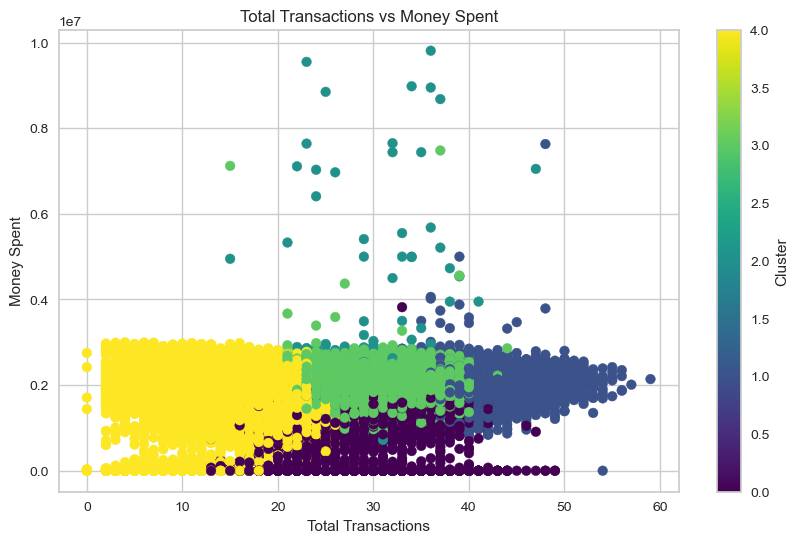

In [133]:
#@markdown
plt.figure(figsize=(10, 6))
plt.scatter(user_1['total transactions'], user_1['money_spent'], c=user_1['cluster'], cmap='viridis')
plt.xlabel('Total Transactions')
plt.ylabel('Money Spent')
plt.title('Total Transactions vs Money Spent')
plt.colorbar(label='Cluster')
plt.show()

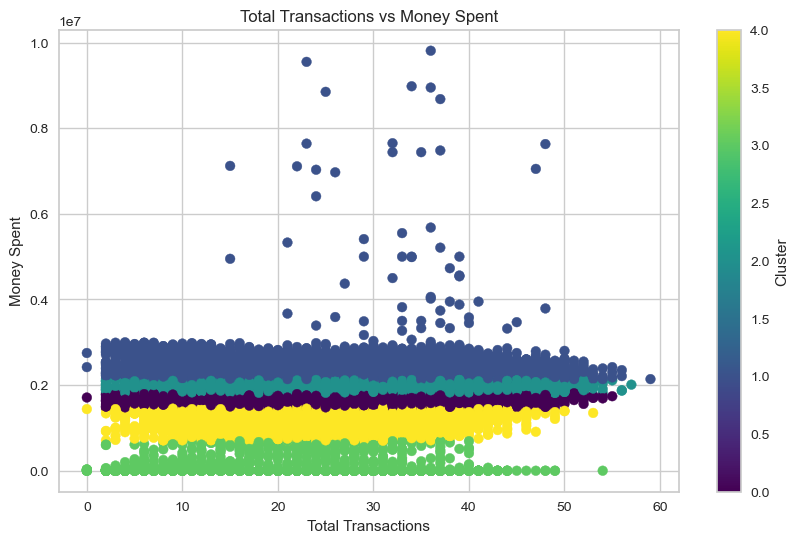

In [134]:
#@markdown
plt.figure(figsize=(10, 6))
plt.scatter(user_1['total transactions'], user_1['money_spent'], c=user_1['cluster_rfm'], cmap='viridis')
plt.xlabel('Total Transactions')
plt.ylabel('Money Spent')
plt.title('Total Transactions vs Money Spent')
plt.colorbar(label='Cluster')
plt.show()

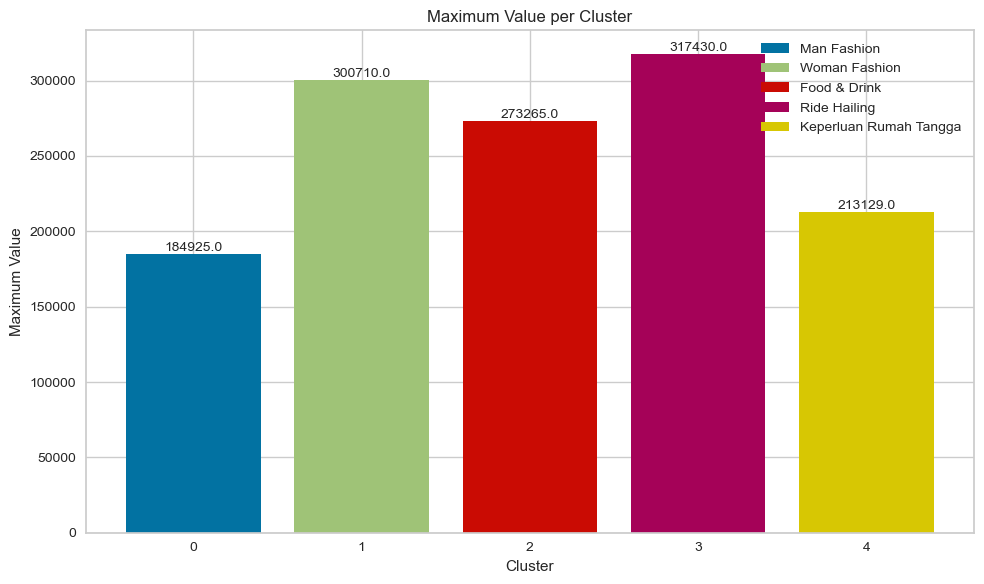

In [135]:
#@markdown
columms_cat_items = ['Man Fashion', 'Woman Fashion', 'Food & Drink', 'Ride Hailing', 'Keperluan Rumah Tangga', 'Travel', 'Keperluan Anak', 'Elektronik', 'Other', 'Transportasi (Kereta, Pesawat, Kapal)',
                     'Top Up Game', 'Otomotif', 'Pulsa', 'Kesehatan', 'Investasi', 'Sewa Motor/Mobil', 'Hotel', 'Tagihan (WIFI, PLN)', 'Fashion', 'Transportasi (Kereta, Pesawat, Kapal, Ride Hailing)']
grouped_data = user_1.groupby('cluster')[columms_cat_items].sum()
cluster_max_values, cluster_max_indices = grouped_data.max(axis=1), grouped_data.idxmax(axis=1)

plt.figure(figsize=(10,6))

bar_labels = []
for index, value in cluster_max_values.items():
  int_index = int(index)
  category_name = columms_cat_items[int_index]
  bar_labels.append(f"{category_name}")
  plt.bar(index, value, label=bar_labels[-1])  # Use the last appended label
  plt.text(index, value + 0.1, str(value), ha='center', va='bottom', fontsize=10)

# Add legend with labels
plt.legend(bar_labels)

plt.xlabel("Cluster")
plt.ylabel("Maximum Value")
plt.title("Maximum Value per Cluster")
plt.tight_layout()
plt.show()

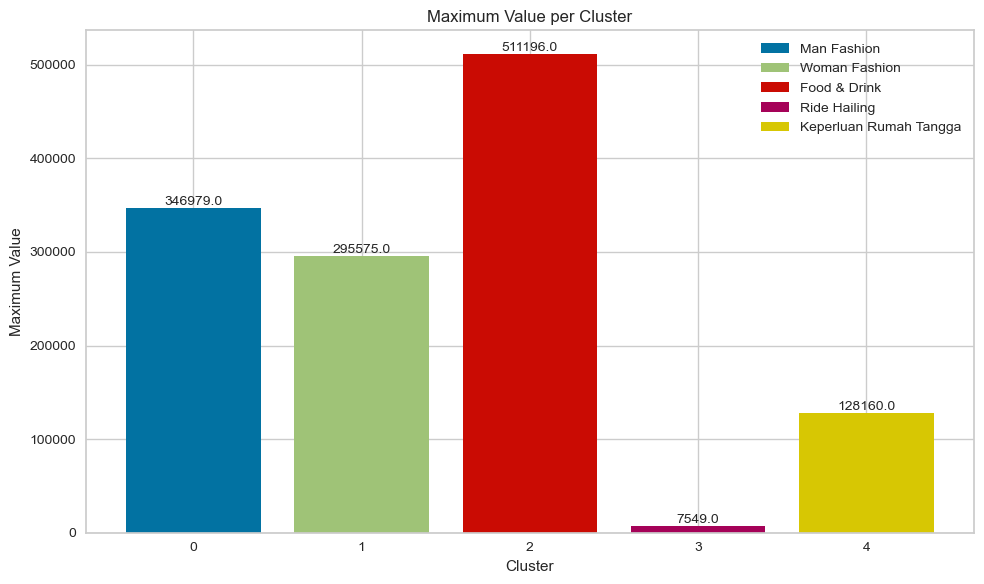

In [136]:
#@markdown
grouped_data_rfm = user_1.groupby('cluster_rfm')[columms_cat_items].sum()
cluster_max_values_rfm, cluster_max_indices_rfm = grouped_data_rfm.max(axis=1), grouped_data_rfm.idxmax(axis=1)

plt.figure(figsize=(10,6))

bar_labels = []
for index, value in cluster_max_values_rfm.items():
  int_index = int(index)
  category_name = columms_cat_items[int_index]
  bar_labels.append(f"{category_name}")
  plt.bar(index, value, label=bar_labels[-1])  # Use the last appended label
  plt.text(index, value + 0.1, str(value), ha='center', va='bottom', fontsize=10)

# Add legend with labels
plt.legend(bar_labels)

plt.xlabel("Cluster")
plt.ylabel("Maximum Value")
plt.title("Maximum Value per Cluster")
plt.tight_layout()
plt.show()

# **Prediction Perspective**

In [137]:
history

,user_id,product_id,gross_amount,discounts,transaction_date,product name
0,SC3101011001001,1,300.0,0.0,2024-09-01,Man Fashion
1,SC3101011001001,1,"14,700.0",0.0,2024-02-16,Man Fashion
2,SC3101011001001,2,"268,800.0","15,000.0",2024-10-14,Woman Fashion
3,SC3101011001001,2,"297,450.0",0.0,2024-02-15,Woman Fashion
4,SC3101011001001,2,"333,750.0",0.0,2024-04-08,Woman Fashion
...,...,...,...,...,...,...
7184269,SC3674071006051,16,"1,300.0",0.0,2024-08-09,Sewa Motor/Mobil
7184270,SC3674071006051,16,"8,100.000000000001",0.0,2024-01-01,Sewa Motor/Mobil
7184271,SC3674071006051,16,"10,100.0",0.0,2024-01-09,Sewa Motor/Mobil
7184272,SC3674071006051,18,"4,200.0",0.0,2024-05-02,"Tagihan (WIFI, PLN)"


In [138]:
user_cluster = pd.DataFrame({
    'cluster': user_1['cluster_rfm'].copy()
})

In [140]:
history_cluster = pd.merge(history.copy(), user_cluster, on='user_id',how='left')
history_cluster.drop(columns=['product_id'], inplace=True)

In [141]:
history_cluster.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7184199 entries, 0 to 7184198
Data columns (total 6 columns):
 #   Column            Dtype         
---  ------            -----         
 0   user_id           object        
 1   gross_amount      float64       
 2   discounts         float64       
 3   transaction_date  datetime64[ns]
 4   product name      object        
 5   cluster           int32         
dtypes: datetime64[ns](1), float64(2), int32(1), object(2)
memory usage: 301.5+ MB


In [142]:
history_cluster.isnull().sum()

user_id                0
gross_amount        3947
discounts              0
transaction_date       0
product name           0
cluster                0
dtype: int64

In [144]:
history_cluster['gross_amount'].fillna(history_cluster['gross_amount'].median(), inplace=True)

In [145]:
history_cluster['product name'].unique()

array(['Man Fashion', 'Woman Fashion', 'Food & Drink', 'Ride Hailing',
       'Keperluan Rumah Tangga', 'Transportasi (Kereta, Pesawat, Kapal)',
       'Otomotif', 'Kesehatan', 'Hotel', 'Tagihan (WIFI, PLN)',
       'Elektronik', 'Investasi', 'Top Up Game', 'Sewa Motor/Mobil',
       'Travel', 'Keperluan Anak', 'Pulsa', 'Other'], dtype=object)

In [146]:
history_cluster.replace({'product name': {
    'Man Fashion': 'Fashion', 
    'Woman Fashion': 'Fashion',
    'Ride Hailing': 'Transportasi',
    'Transportasi (Kereta, Pesawat, Kapal)' : 'Transportasi',
    'Food & Drink': 'FnD',
    'Keperluan Rumah Tangga': 'Keperluan_Rumah_Tangga',
    'Keperluan Anak': 'Keperluan_Anak',
    'Top Up Game': 'Top_Up_Game',
    'Sewa Motor/Mobil' : 'Sewa_Motor/Mobil',
    'Tagihan (WIFI, PLN)' : 'Tagihan'
    }
}, inplace=True)

In [147]:
history_c0 = history_cluster[history_cluster['cluster'] == 0]
history_c1 = history_cluster[history_cluster['cluster'] == 1]
history_c2 = history_cluster[history_cluster['cluster'] == 2]
history_c3 = history_cluster[history_cluster['cluster'] == 3]
history_c4 = history_cluster[history_cluster['cluster'] == 4]

In [148]:
history_dfs = [history_c0, history_c1, history_c2, history_c3, history_c4]

for df in history_dfs:
  df.drop(columns=['user_id'], inplace=True)
  df.set_index('transaction_date', drop=False, inplace=True)

### **Time Series Modeling**

In [152]:
from keras.models import load_model, Sequential
from keras.layers import Activation, Dense, Dropout, LSTM
from prophet import Prophet
from sklearn.metrics import mean_absolute_error, root_mean_squared_error
from sklearn.model_selection import GridSearchCV, TimeSeriesSplit
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.ar_model import AutoReg
from statsmodels.tsa.arima.model import ARIMA, ARIMAResults
from statsmodels.tsa.statespace.sarimax import SARIMAX
from tensorflow.keras.callbacks import EarlyStopping
from xgboost import XGBRegressor
import itertools
import lightgbm as lgb
import keras

#### **Product**

In [243]:
# Assuming 'cluster' is the column for grouping and 'history_cluster' is your DataFrame
cat_histories = {cluster: history_cluster[history_cluster['product name'] == cluster]
                     for cluster in history_cluster['product name'].unique()}


In [247]:
for name, df in cat_histories.items():
    df.drop(columns=['user_id'], inplace=True)
    df.set_index('transaction_date', drop=False, inplace=True)

In [248]:
for name, df in cat_histories.items():
    df.sort_index(inplace=True)
    df["Quarter"] = df.transaction_date.dt.quarter
    df["Month"] = df.transaction_date.dt.month
    df["Week"] = df.transaction_date.dt.isocalendar().week.astype("Int32")
    df["Weekday"] = df.transaction_date.dt.weekday
    df["Day"] = df.transaction_date.dt.day
    df["Dayofyear"] = df.transaction_date.dt.dayofyear
    df['DayMonth'] = df['Day'] + df['Month']
    df['total_transaction'] = df.groupby(df.index)['DayMonth'].count()
    df['total_discounts'] = df.groupby(df.index)['discounts'].sum()
    df['total_gross_amount'] = df.groupby(df.index)['gross_amount'].sum()
    df.drop_duplicates(subset=['transaction_date'], inplace=True)
    df.drop(columns=['discounts', 'gross_amount', 'product name','cluster', 'DayMonth'], inplace=True)

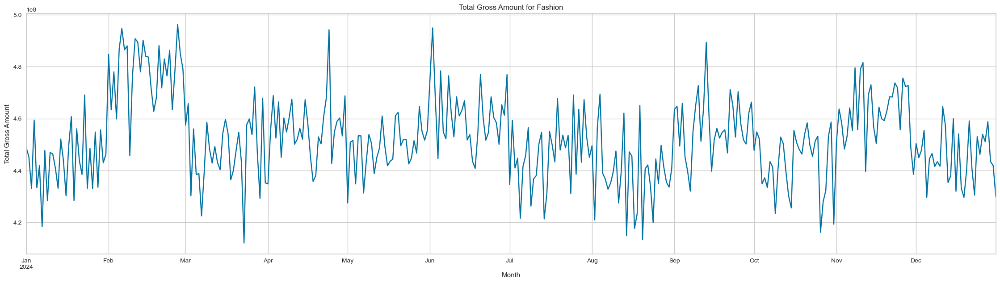

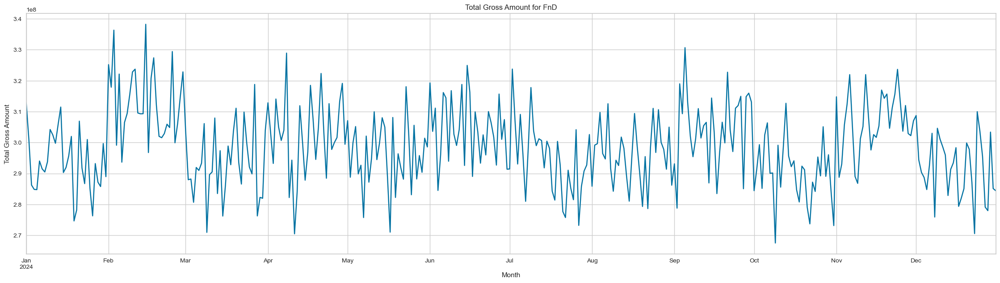

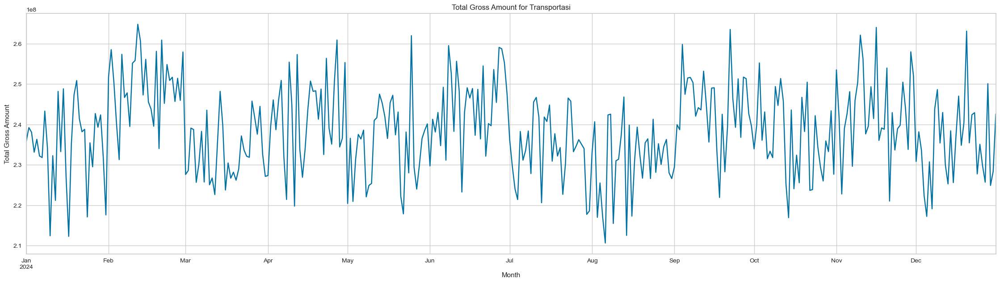

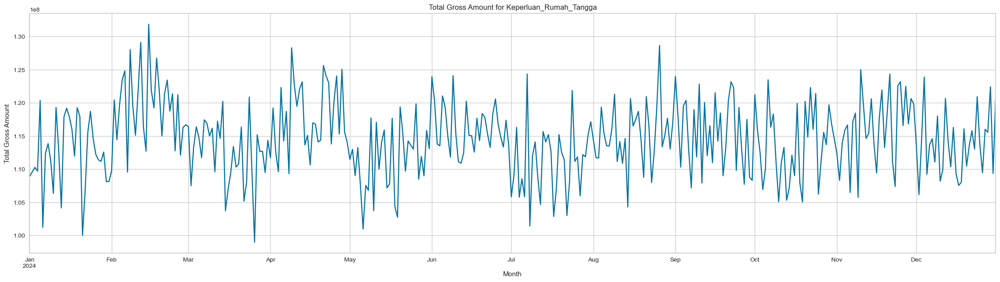

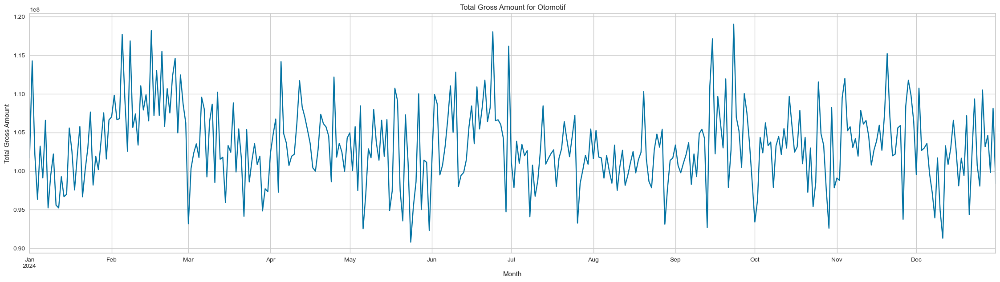

...

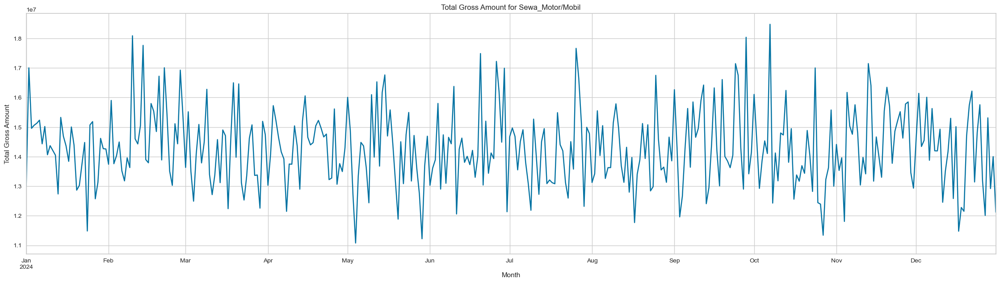

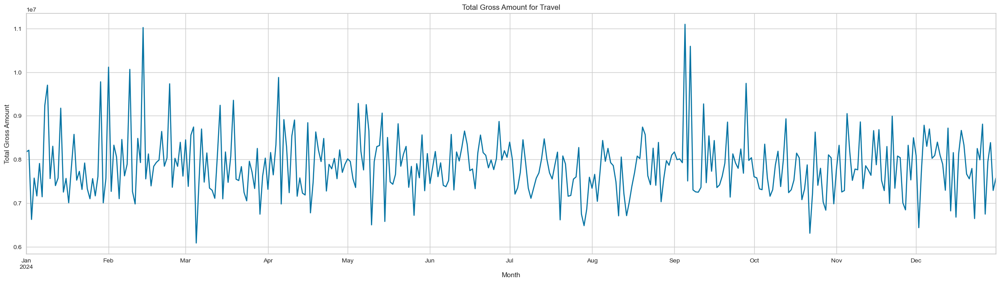

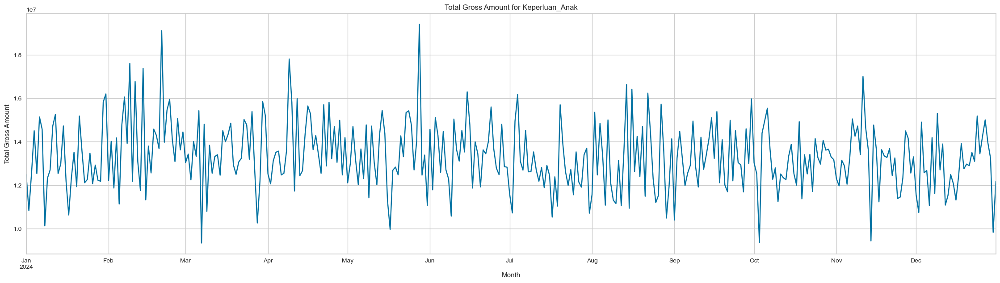

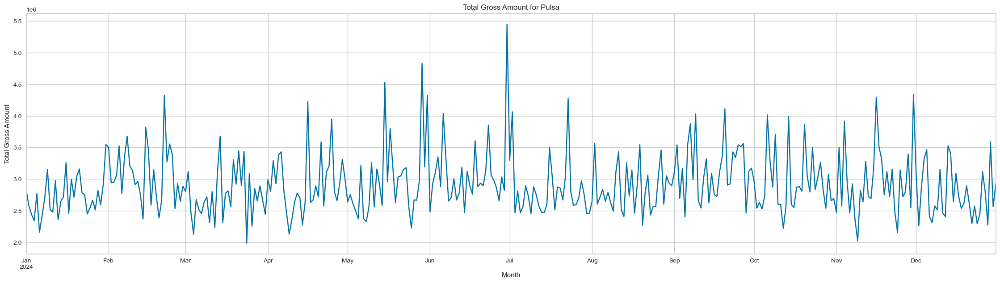

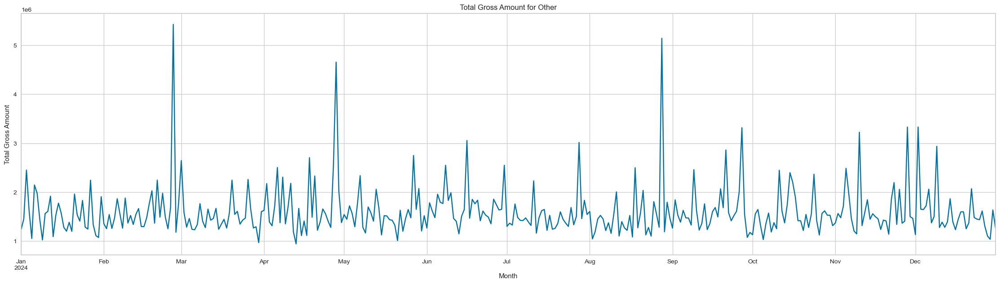

In [251]:
for name, df in cat_histories.items():
  fig, ax = plt.subplots(figsize=(28, 7))

  df['total_gross_amount'].plot(ax=ax)

  ax.set_title(f"Total Gross Amount for {name}")
  ax.set_xlabel("Month")
  ax.set_ylabel("Total Gross Amount")
  ax.grid(True)

  plt.show()

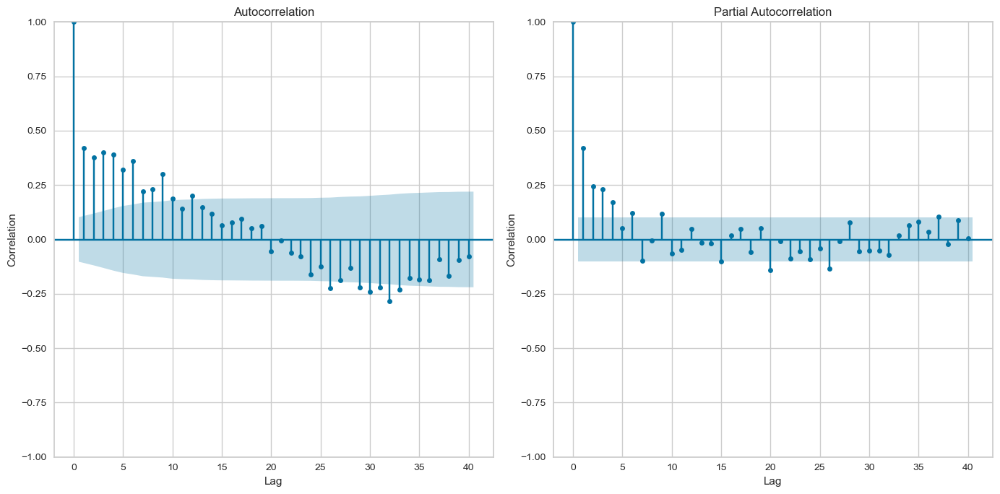

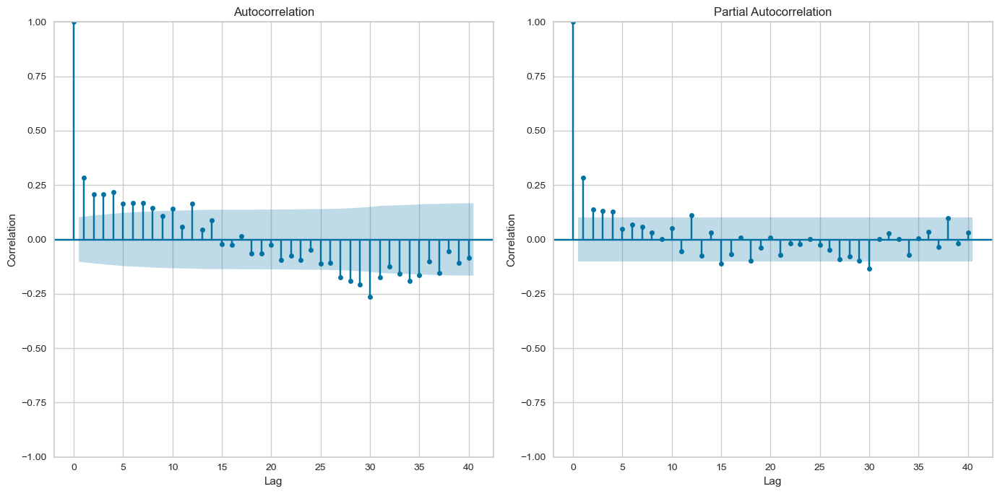

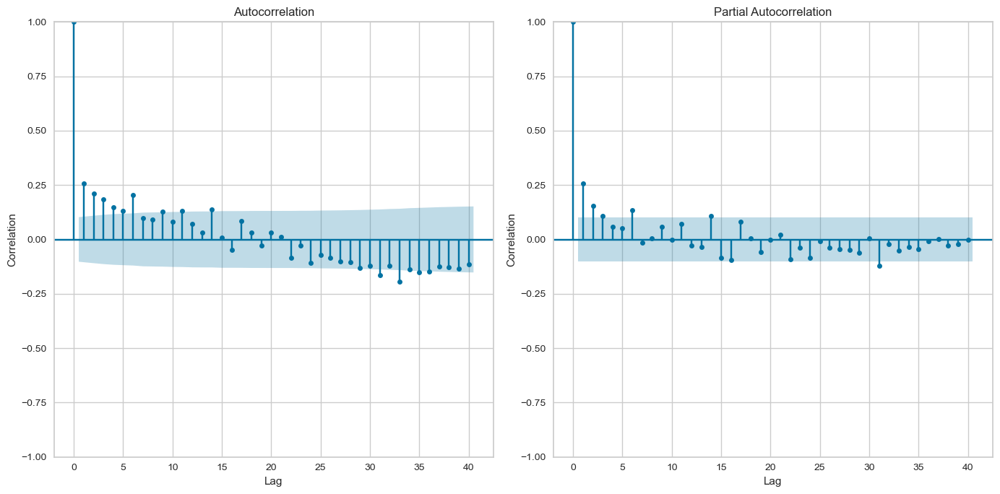

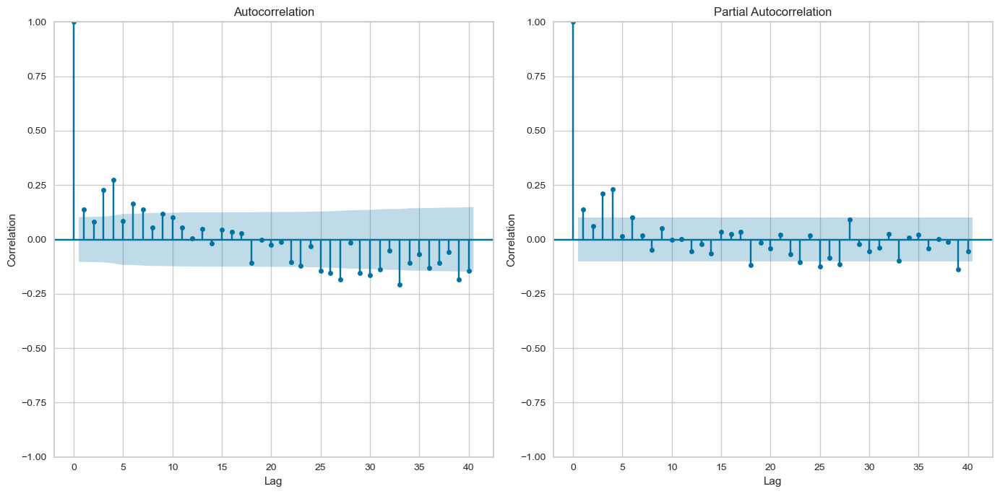

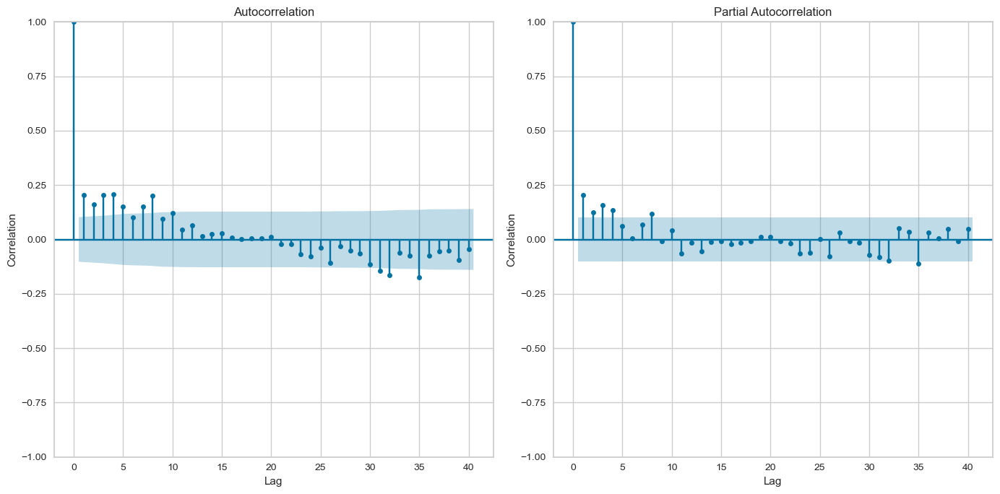

...

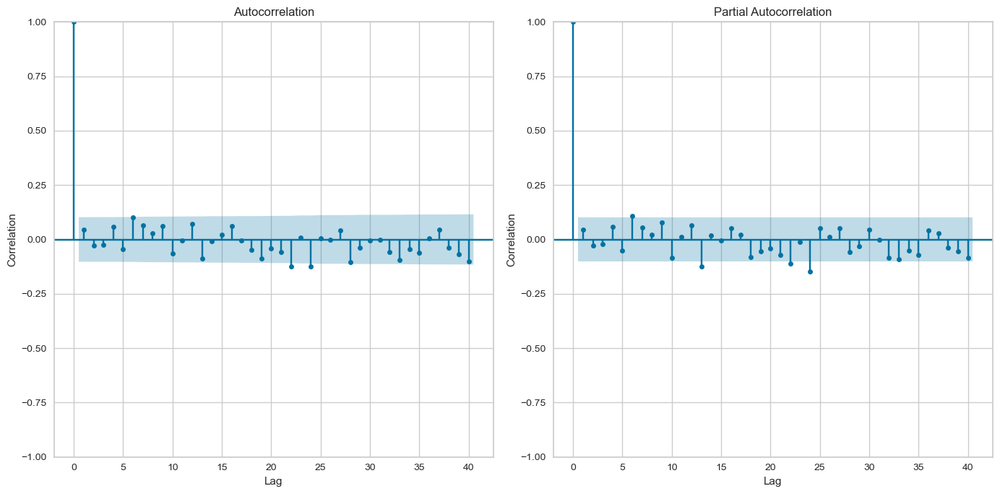

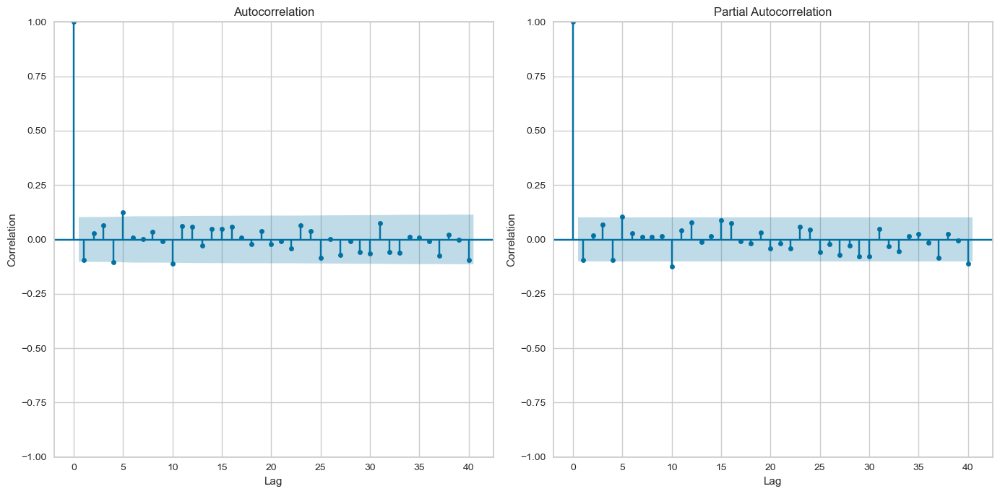

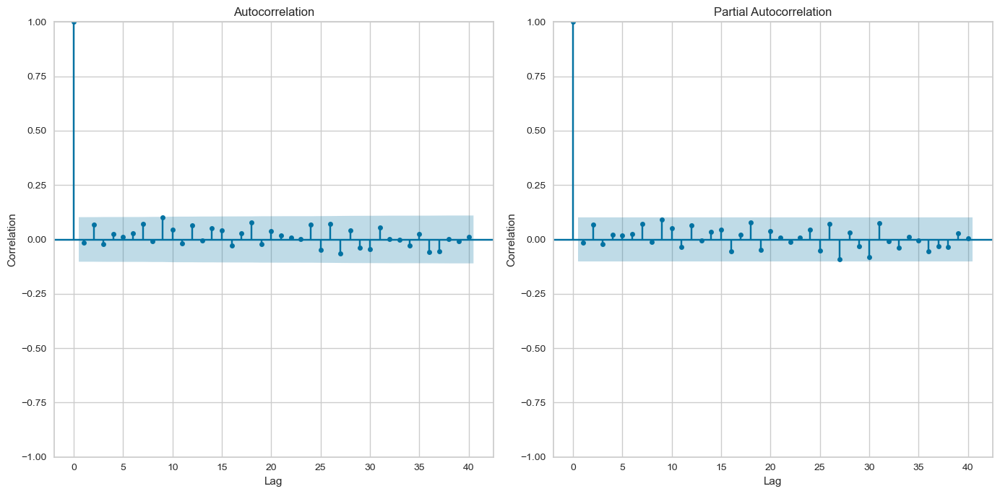

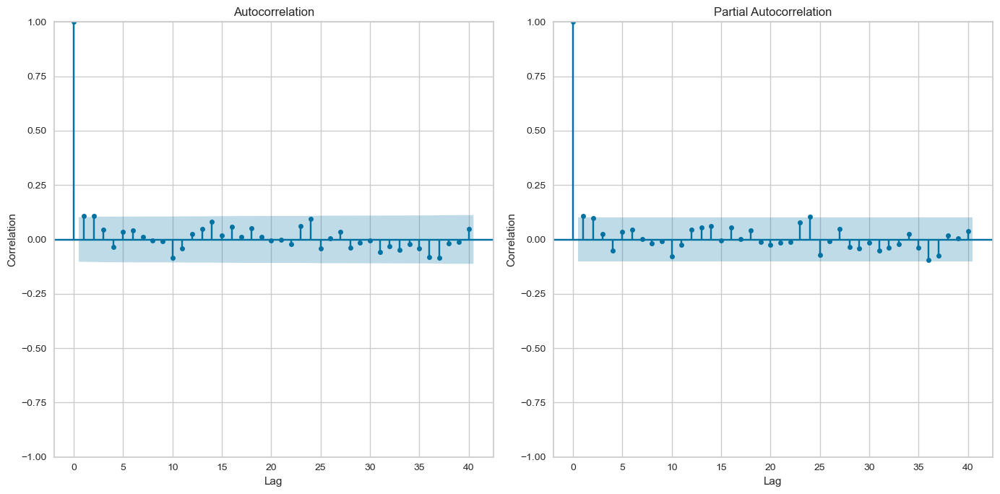

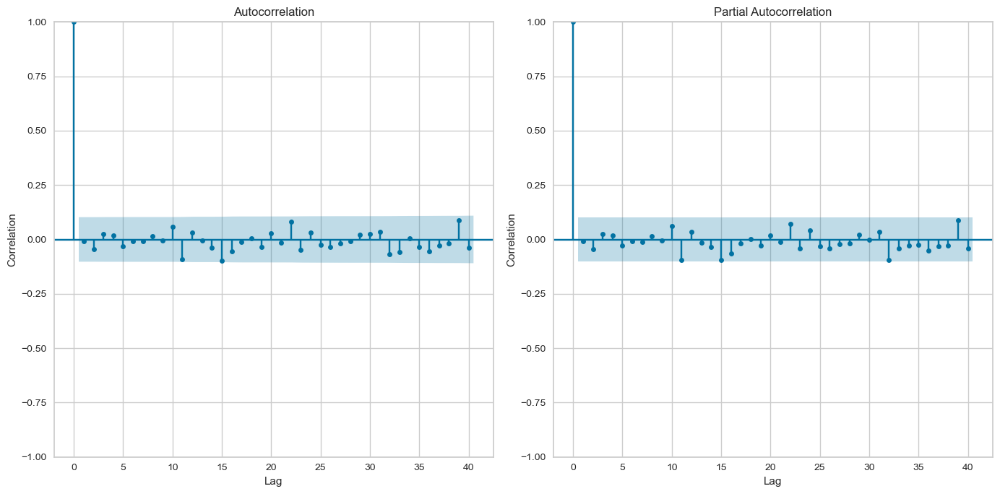

In [252]:
for name, df in cat_histories.items():
    series = df['total_gross_amount']

    highest_correlation_per_df = 0  
    highest_correlation_lag_per_df = 0

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 7))

    # Plot ACF on the first subplot
    plot_acf(series, ax=ax1, title='Autocorrelation', lags=40)
    ax1.set_xlabel('Lag')
    ax1.set_ylabel('Correlation')

    # Plot PACF on the second subplot
    plot_pacf(series, ax=ax2, title='Partial Autocorrelation', lags=40)
    ax2.set_xlabel('Lag')
    ax2.set_ylabel('Correlation')

    plt.tight_layout()
    plt.show()


Best model:  ARIMA(1,1,0)(2,1,2)[12]          
Total fit time: 16.127 seconds


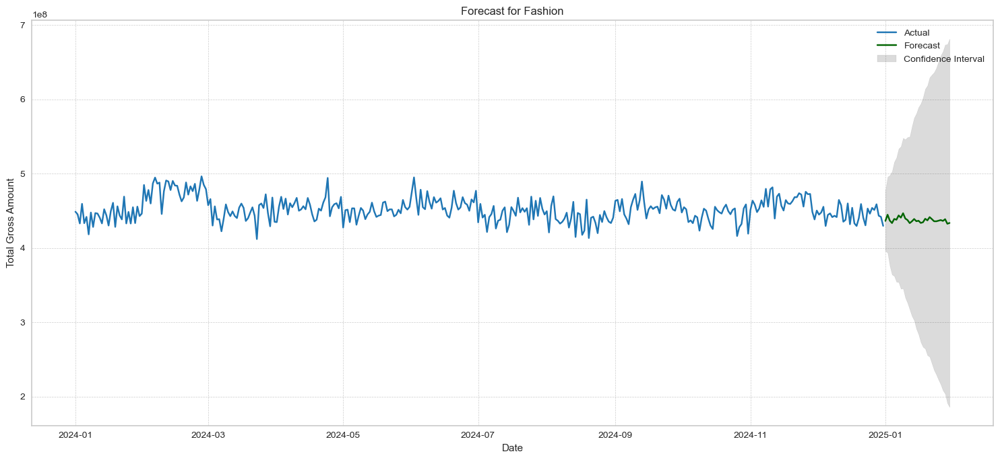


Best model:  ARIMA(0,1,1)(0,1,2)[12]          
Total fit time: 7.448 seconds


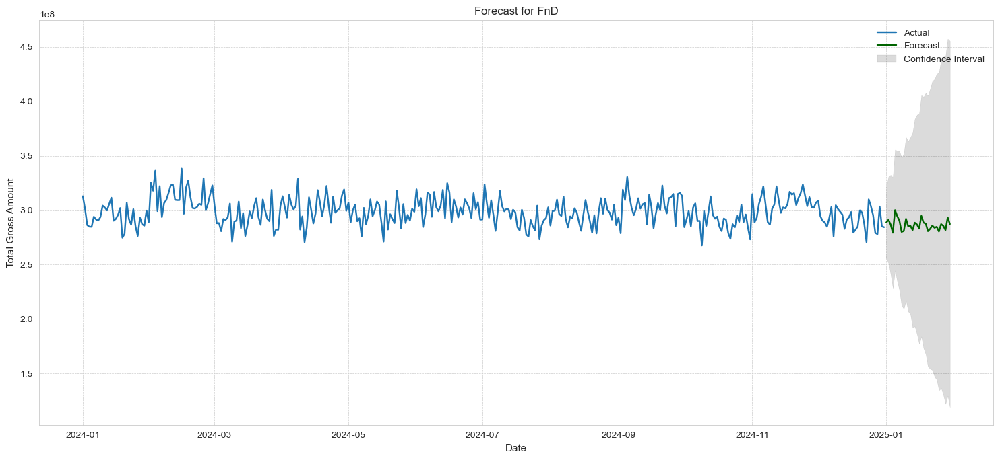


Best model:  ARIMA(0,1,1)(0,1,2)[12]          
Total fit time: 7.257 seconds


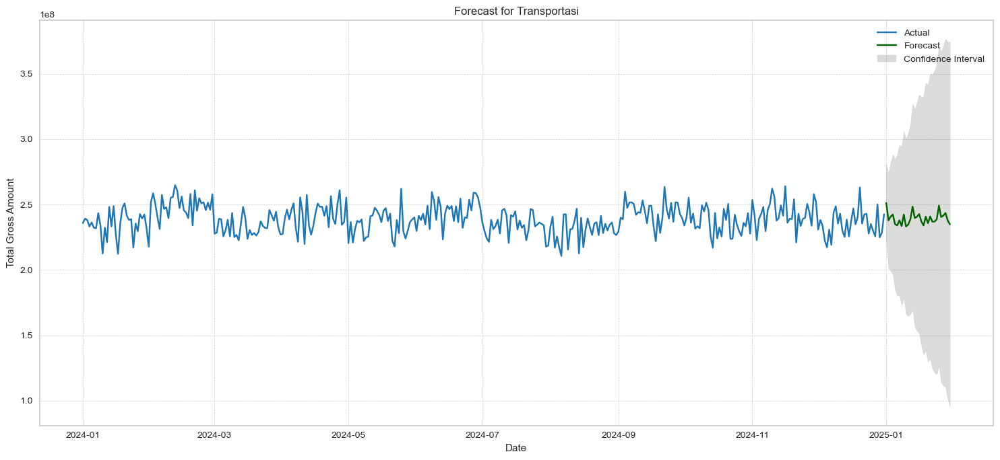


Best model:  ARIMA(3,1,0)(0,1,2)[12]          
Total fit time: 7.567 seconds


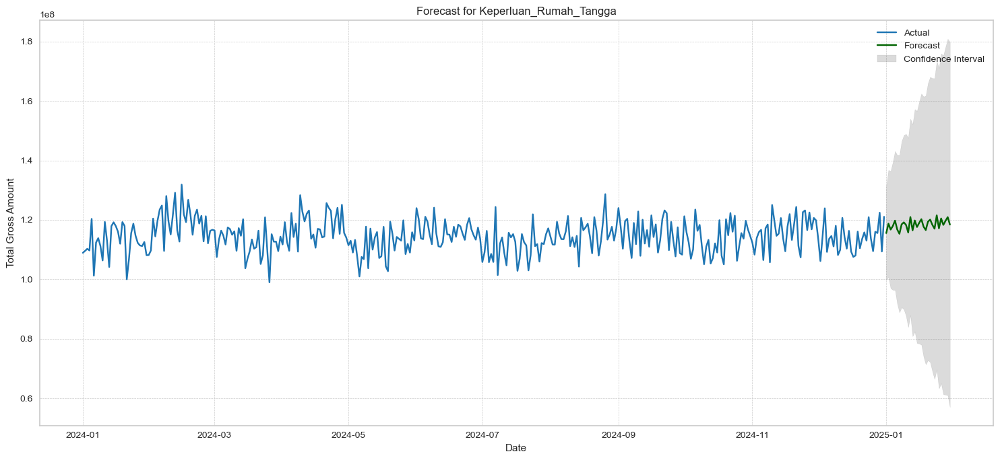


Best model:  ARIMA(0,1,1)(0,1,1)[12]          
Total fit time: 9.808 seconds


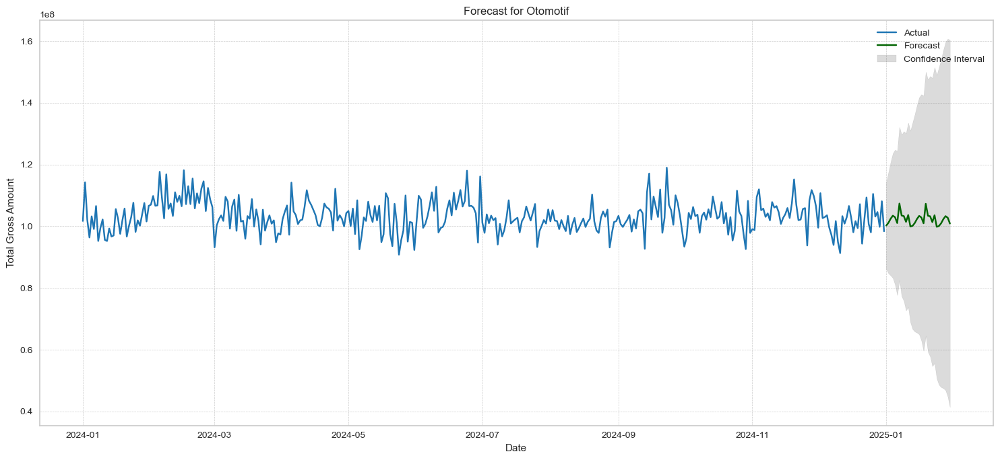


Best model:  ARIMA(2,1,2)(0,1,1)[12]          
Total fit time: 9.470 seconds


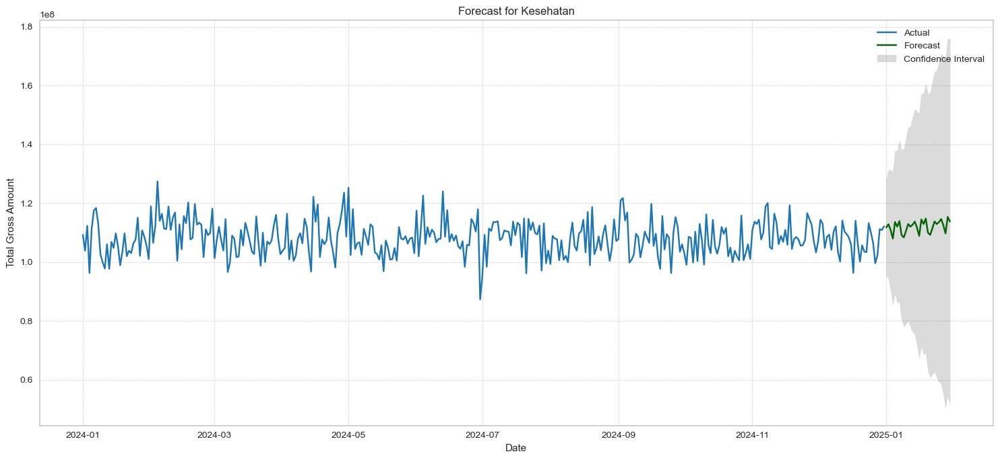


Best model:  ARIMA(2,1,2)(0,1,1)[12]          
Total fit time: 8.493 seconds


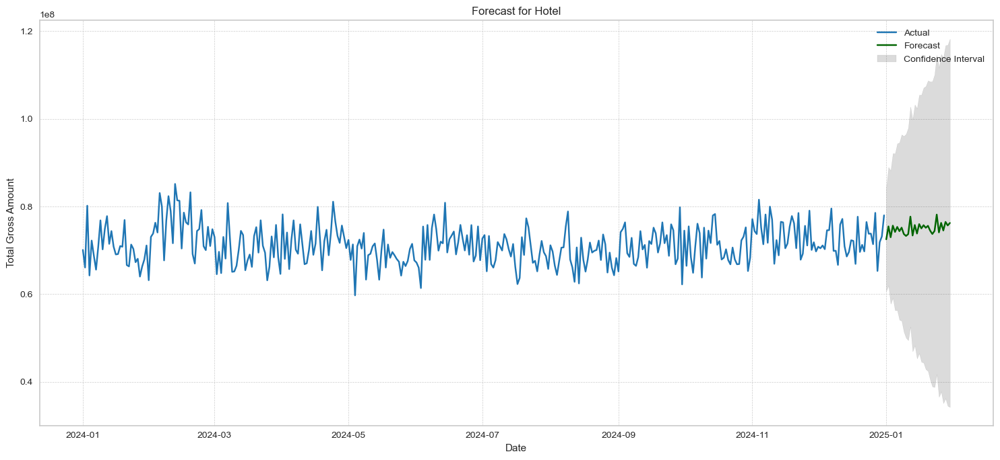


Best model:  ARIMA(1,1,2)(2,1,0)[12]          
Total fit time: 7.852 seconds


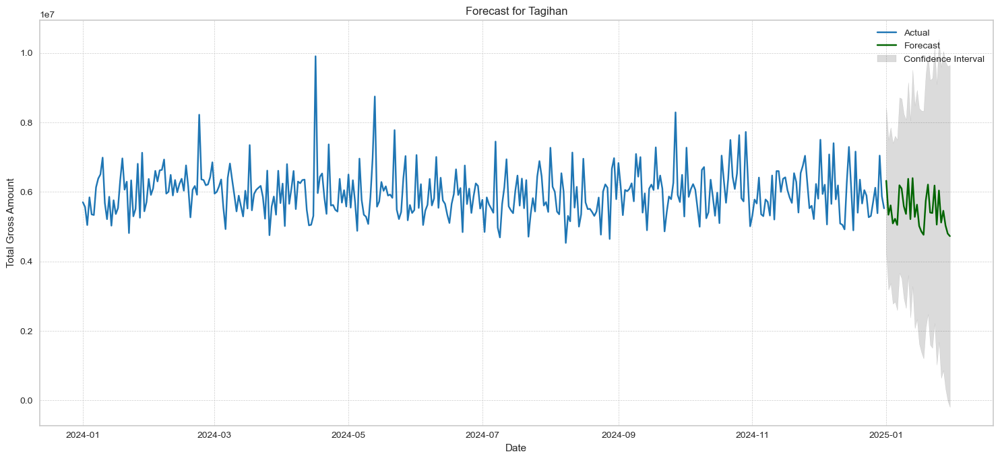


Best model:  ARIMA(0,1,1)(0,1,1)[12]          
Total fit time: 9.407 seconds


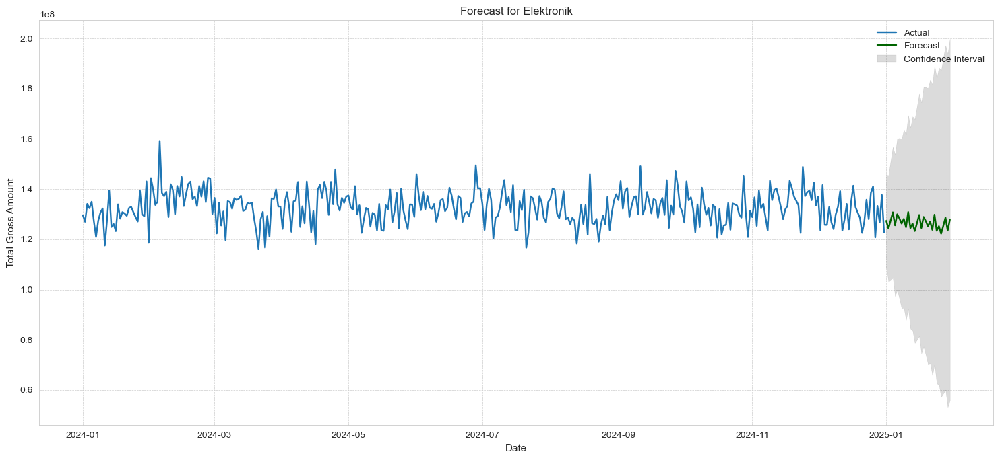


Best model:  ARIMA(0,1,3)(0,1,2)[12]          
Total fit time: 9.444 seconds


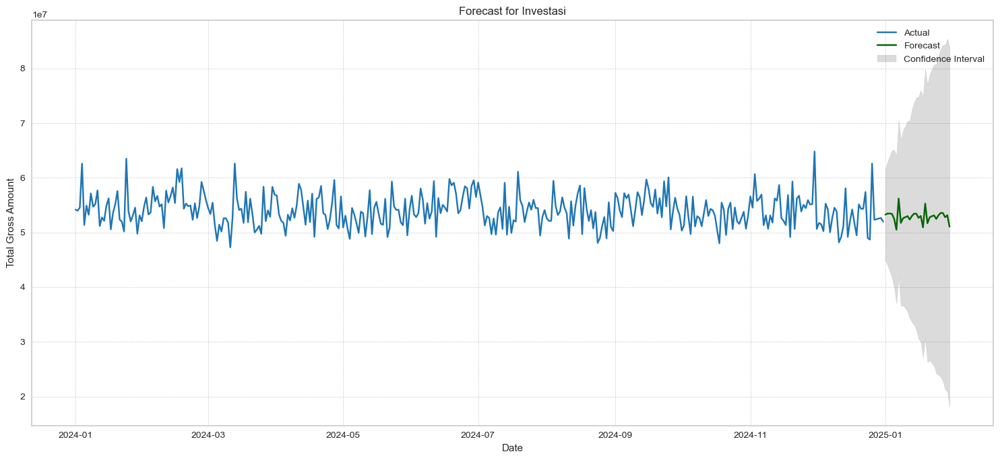


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 10.187 seconds


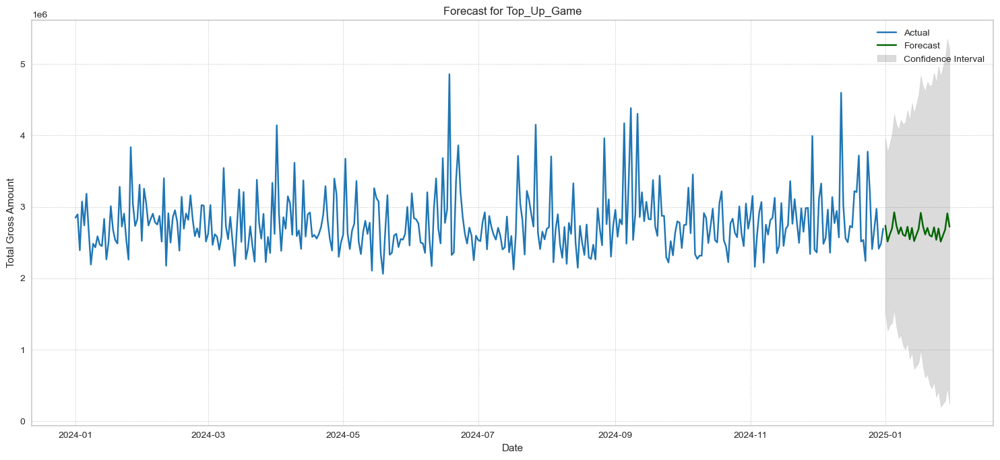


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 8.839 seconds


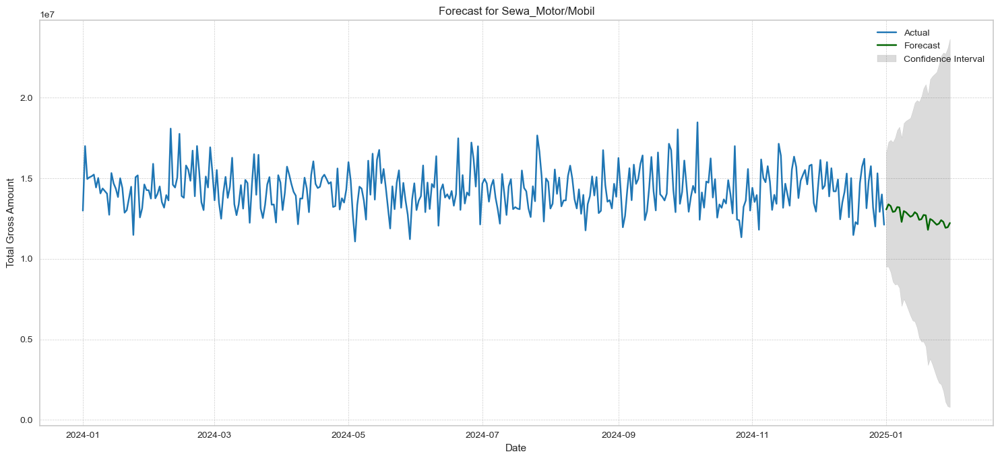


Best model:  ARIMA(1,1,2)(1,1,1)[12]          
Total fit time: 8.830 seconds


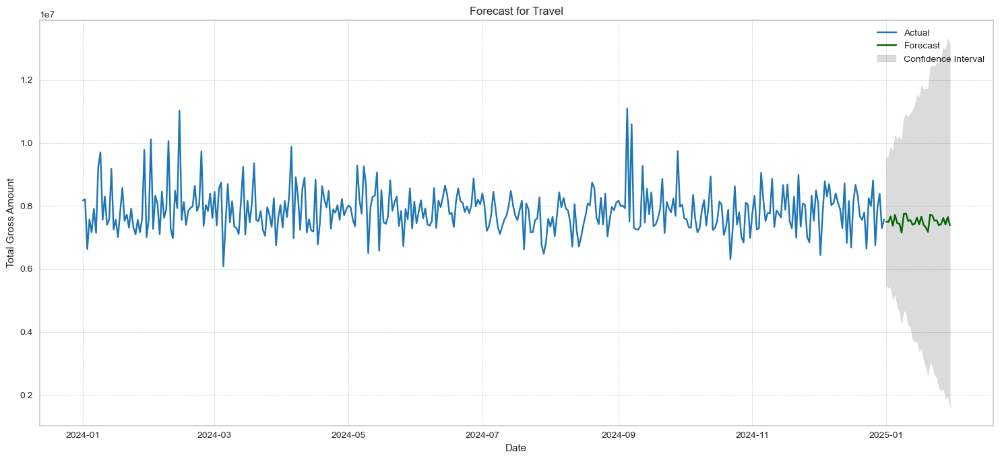


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 8.760 seconds


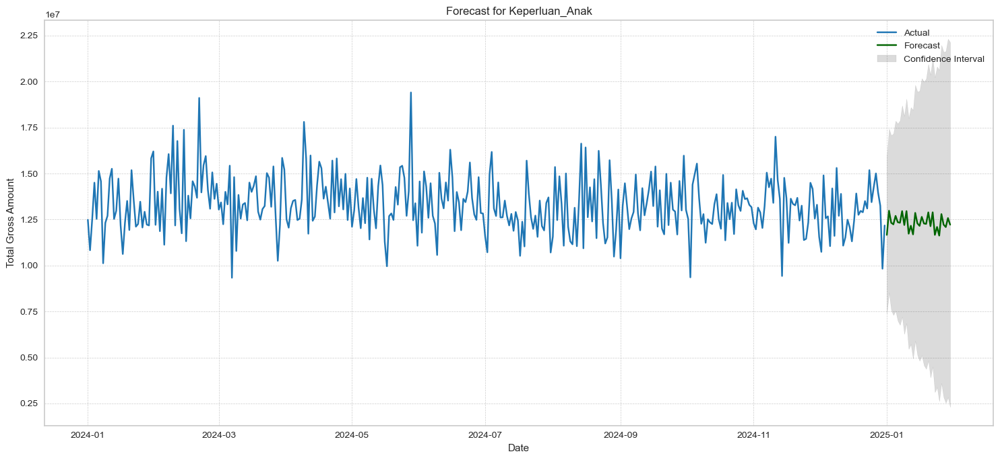


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 7.183 seconds


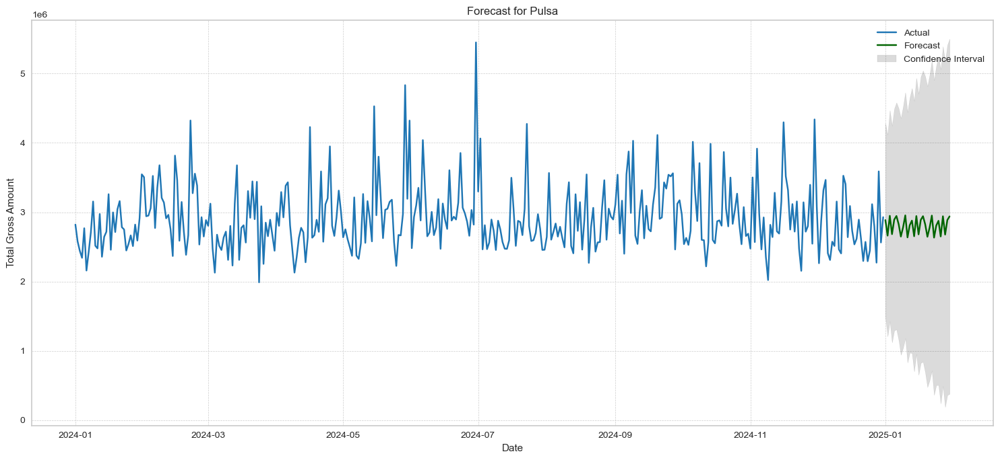


Best model:  ARIMA(1,1,2)(2,1,0)[12]          
Total fit time: 8.058 seconds


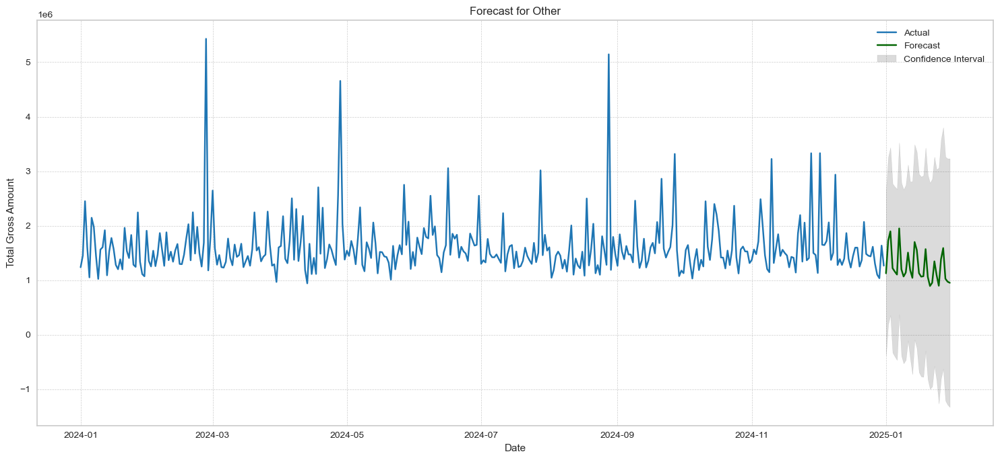

In [254]:
import pmdarima as pm

for name, df in cat_histories.items():
    ARIMA_model = pm.auto_arima(df['total_gross_amount'], start_p=1, start_q=1, max_p=3, max_q=3, m=12,
                             start_P=0, seasonal=True, d=1, D=1, trace=True,
                             n_jobs=-1,
                             error_action='ignore',  # don't want to know if an order does not work
                             suppress_warnings=True,  # don't want convergence warnings
                             stepwise=False, random=True, random_state=42, n_fits=25)
    
    fitted, confint = ARIMA_model.predict(n_periods=30, return_conf_int=True)  # Change to 30 for a month

    # Create date index for forecast (assuming daily data)
    future_dates = pd.date_range(df.index[-1] + pd.DateOffset(days=1), periods=30, freq='D')

    # Create time series for plotting
    fitted_series = pd.Series(fitted, index=future_dates)
    lower_series = pd.Series(confint[:, 0], index=future_dates)
    upper_series = pd.Series(confint[:, 1], index=future_dates)

    # Enhanced plot with clear labels and annotations
    plt.figure(figsize=(15, 7))
    plt.plot(df["total_gross_amount"], color='#1f76b4', label='Actual')
    plt.plot(fitted_series, color='darkgreen', label='Forecast')
    plt.fill_between(lower_series.index, lower_series, upper_series, color='k', alpha=0.15, label='Confidence Interval')

    plt.title(f"Forecast for {name}")
    plt.xlabel('Date')
    plt.ylabel('Total Gross Amount')
    plt.legend()  # Show labels in the plot

    # Grid lines for better readability
    plt.grid(True, linestyle='--', linewidth=0.5)

    plt.tight_layout()  # Adjust spacing for clarity
    plt.show()

#### **Overall**

In [ ]:
overall = history_dfs.copy()
for df in overall:
    df.sort_index(inplace=True)
    df["Quarter"] = df.transaction_date.dt.quarter
    df["Month"] = df.transaction_date.dt.month
    df["Week"] = df.transaction_date.dt.isocalendar().week.astype("Int32")
    df["Weekday"] = df.transaction_date.dt.weekday
    df["Day"] = df.transaction_date.dt.day
    df["Dayofyear"] = df.transaction_date.dt.dayofyear
    df['DayMonth'] = df['Day'] + df['Month']
    df['total_transaction'] = df.groupby(df.index)['DayMonth'].count()
    df['total_discounts'] = df.groupby(df.index)['discounts'].sum()
    df['total_gross_amount'] = df.groupby(df.index)['gross_amount'].sum()
    df.drop_duplicates(subset=['transaction_date'], inplace=True)
    df.drop(columns=['discounts', 'gross_amount', 'product name','cluster', 'DayMonth'], inplace=True)

In [ ]:
for df in overall:  
  fig, ax = plt.subplots(figsize=(28, 7))

  df['total_gross_amount'].plot(ax=ax)

  ax.set_title(f"Total Gross Amount for {variable_name}")
  ax.set_xlabel("Month")
  ax.set_ylabel("Total Gross Amount")
  ax.grid(True)

  plt.show()

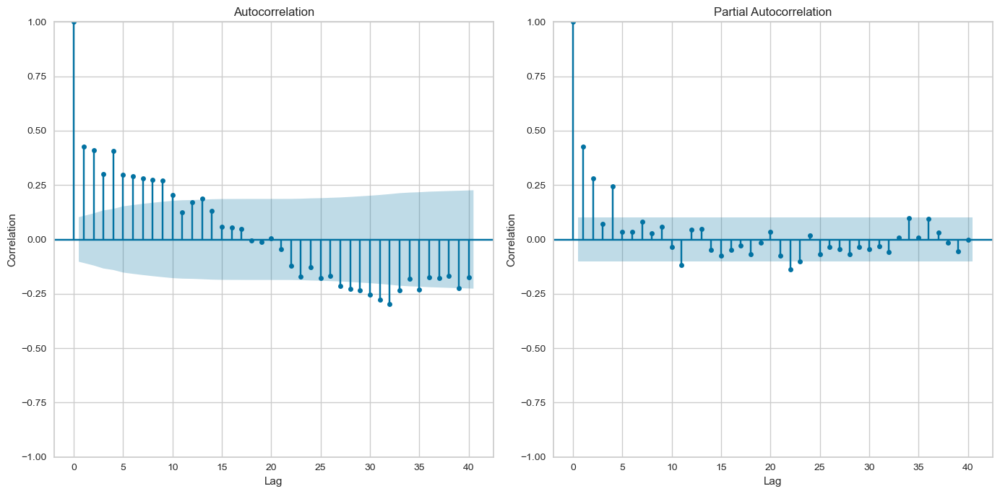

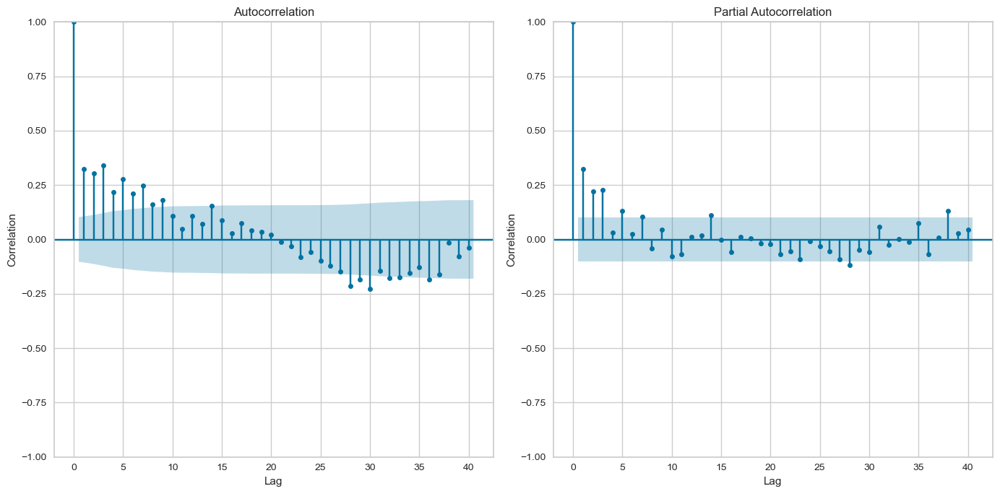

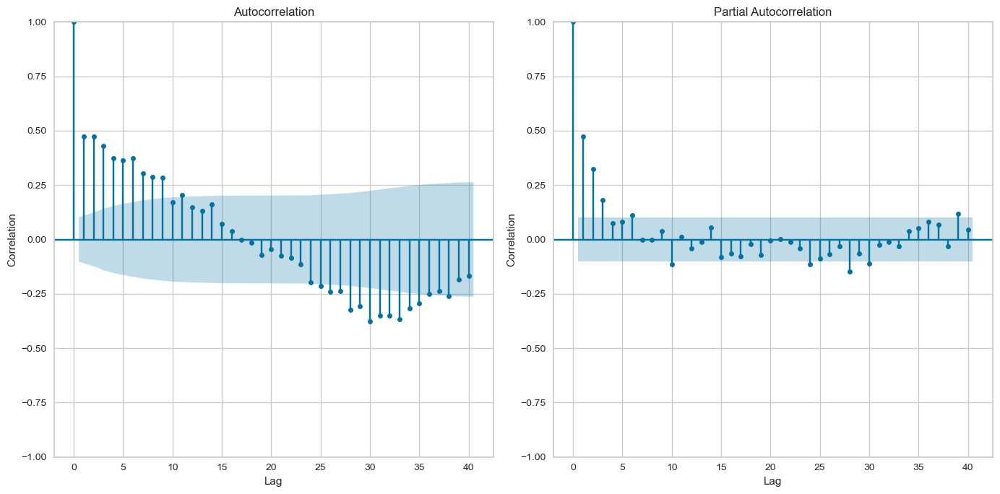

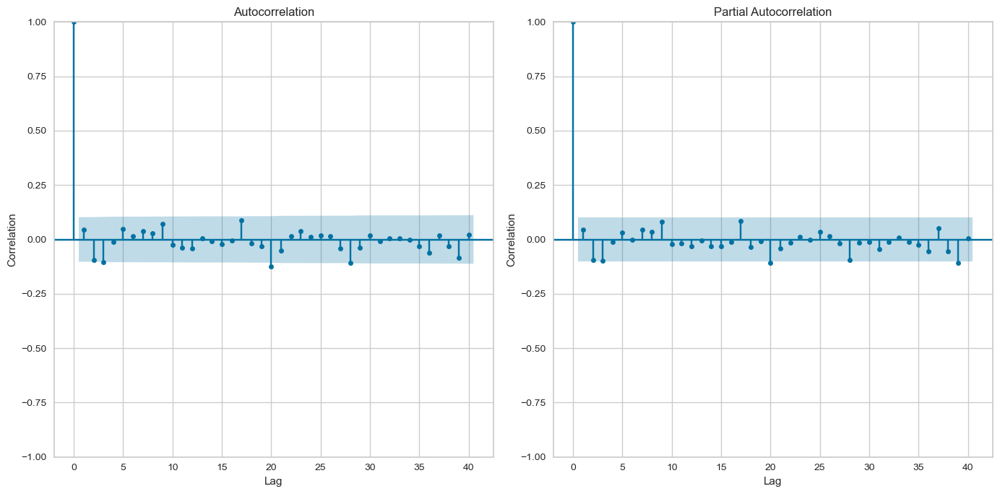

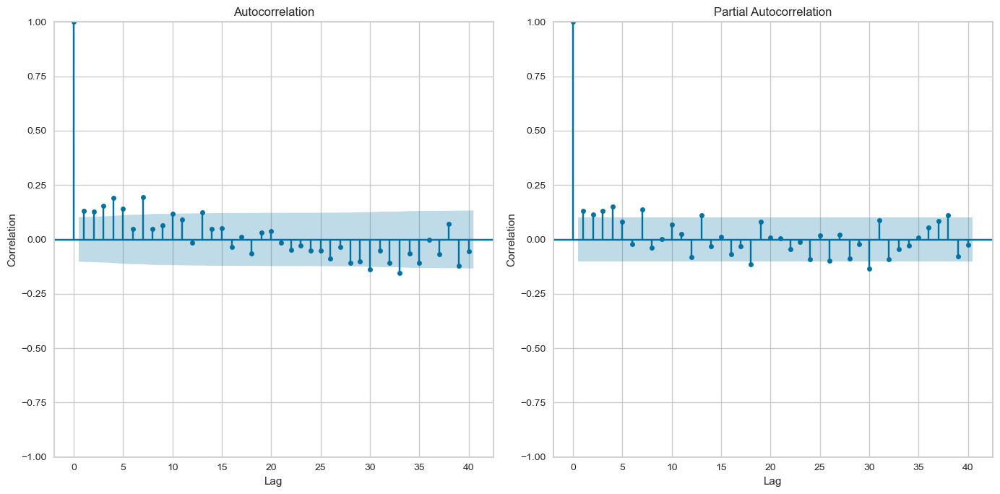

In [ ]:
lag_data = []
highest_correlation = 0
highest_correlation_lag = 0
judul = "of total_gross_amount"

for df in overall:
    series = df['total_gross_amount']

    highest_correlation_per_df = 0  
    highest_correlation_lag_per_df = 0

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 7))

    # Plot ACF on the first subplot
    plot_acf(series, ax=ax1, title='Autocorrelation', lags=40)
    ax1.set_xlabel('Lag')
    ax1.set_ylabel('Correlation')

    # Plot PACF on the second subplot
    plot_pacf(series, ax=ax2, title='Partial Autocorrelation', lags=40)
    ax2.set_xlabel('Lag')
    ax2.set_ylabel('Correlation')

    plt.tight_layout()
    plt.show()


Best model:  ARIMA(3,1,0)(0,1,2)[12]          
Total fit time: 13.917 seconds


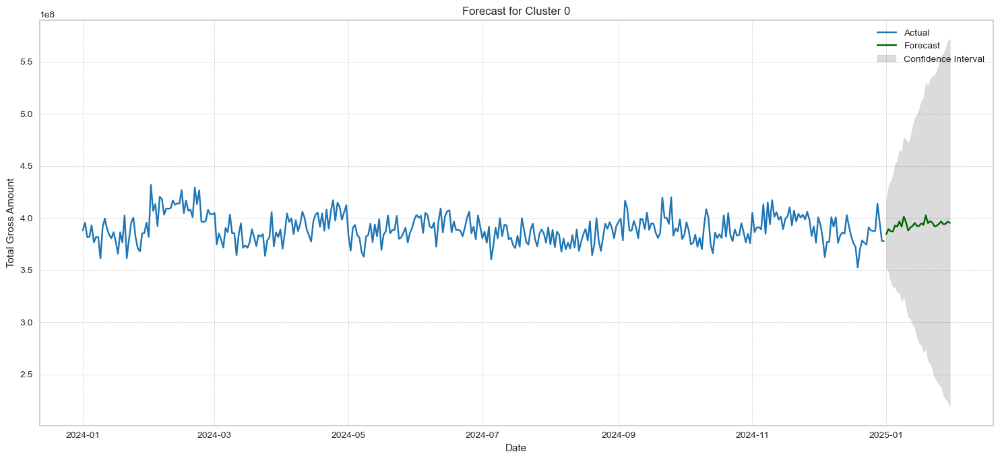


Best model:  ARIMA(0,1,1)(0,1,2)[12]          
Total fit time: 8.291 seconds


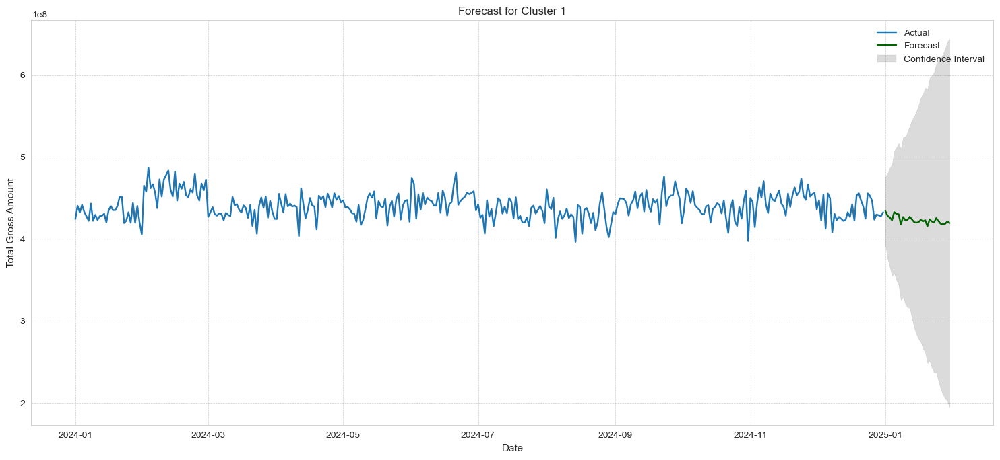


Best model:  ARIMA(0,1,1)(0,1,2)[12]          
Total fit time: 7.930 seconds


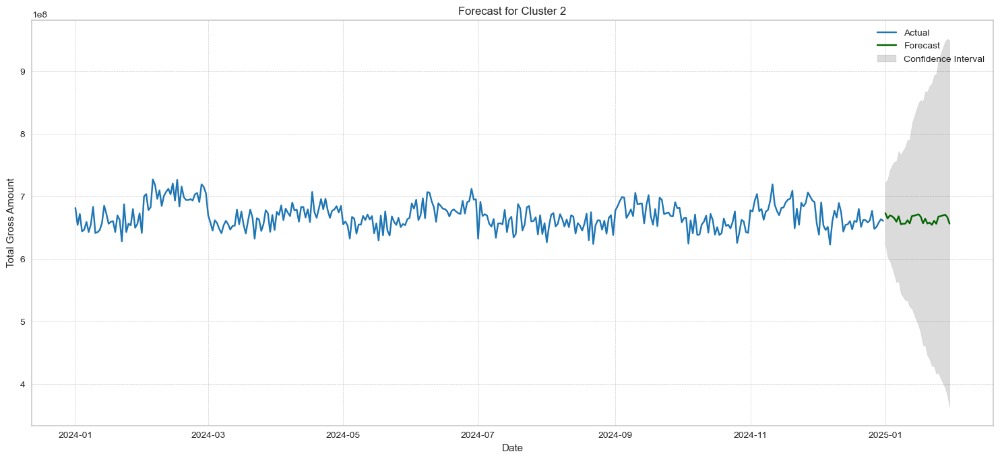


Best model:  ARIMA(1,1,2)(1,1,1)[12]          
Total fit time: 6.996 seconds


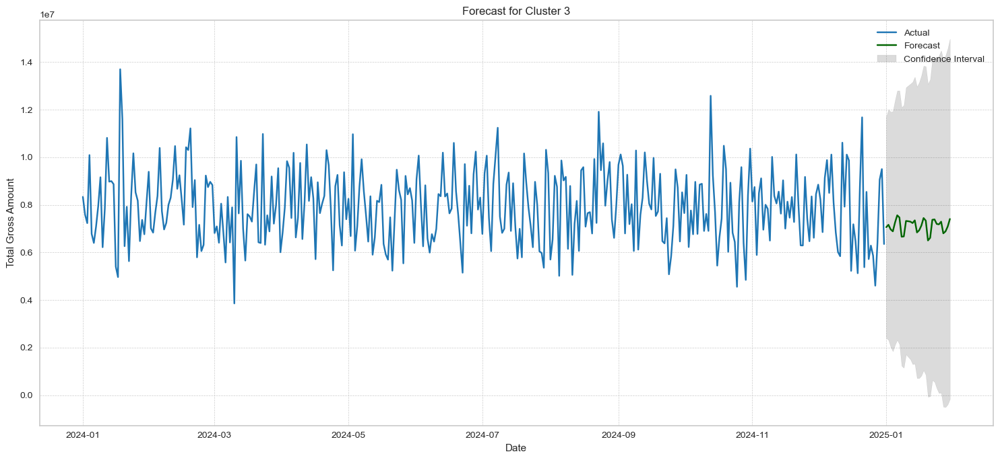


Best model:  ARIMA(0,1,1)(0,1,2)[12]          
Total fit time: 6.816 seconds


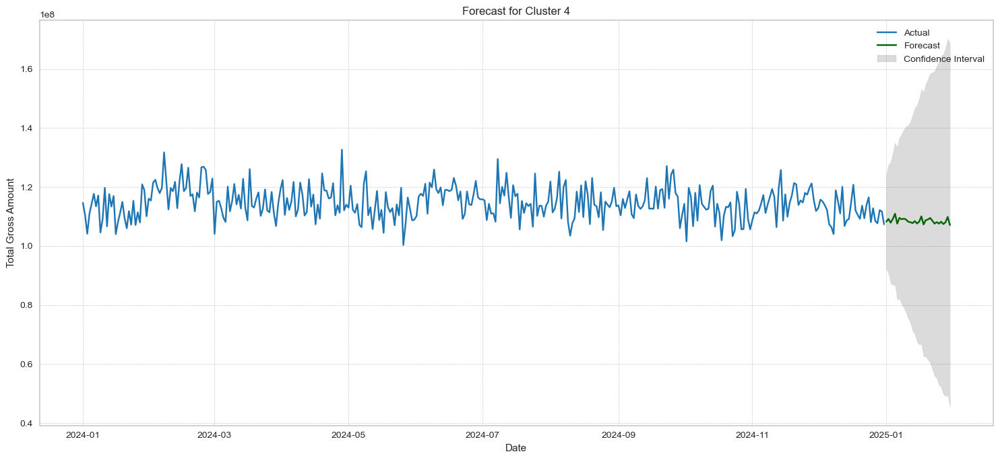

In [ ]:
import pmdarima as pm

name = ['Cluster 0', 'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4']

for i, df in zip(name, overall):
    ARIMA_model = pm.auto_arima(df['total_gross_amount'], start_p=1, start_q=1, max_p=3, max_q=3, m=12,
                             start_P=0, seasonal=True, d=1, D=1, trace=True,
                             n_jobs=-1,
                             error_action='ignore',  # don't want to know if an order does not work
                             suppress_warnings=True,  # don't want convergence warnings
                             stepwise=False, random=True, random_state=42, n_fits=25)
    
    fitted, confint = ARIMA_model.predict(n_periods=30, return_conf_int=True)  # Change to 30 for a month

    # Create date index for forecast (assuming daily data)
    future_dates = pd.date_range(df.index[-1] + pd.DateOffset(days=1), periods=30, freq='D')

    # Create time series for plotting
    fitted_series = pd.Series(fitted, index=future_dates)
    lower_series = pd.Series(confint[:, 0], index=future_dates)
    upper_series = pd.Series(confint[:, 1], index=future_dates)

    # Enhanced plot with clear labels and annotations
    plt.figure(figsize=(15, 7))
    plt.plot(df["total_gross_amount"], color='#1f76b4', label='Actual')
    plt.plot(fitted_series, color='darkgreen', label='Forecast')
    plt.fill_between(lower_series.index, lower_series, upper_series, color='k', alpha=0.15, label='Confidence Interval')

    plt.title(f"Forecast for {i}")
    plt.xlabel('Date')
    plt.ylabel('Total Gross Amount')
    plt.legend()  # Show labels in the plot

    # Grid lines for better readability
    plt.grid(True, linestyle='--', linewidth=0.5)

    plt.tight_layout()  # Adjust spacing for clarity
    plt.show()

#### **Product Section**

In [149]:
names = ['Fashion', 'FnD', 'Transportasi', 'Keperluan_Rumah_Tangga', 'Otomotif', 'Kesehatan', 'Hotel', 'Tagihan', 'Elektronik', 'Investasi', 'Top_Up_Game', 'Sewa_Motor/Mobil', 'Travel', 'Keperluan_Anak', 'Pulsa', 'Other']

assignments = {}
variable_names = []
for i in range(len(history_dfs)):
  for name in names:
    variable_name = f"history_c{i}_{name}"
    variable_names.append(variable_name)
    assignments[variable_name] = history_dfs[i][history_dfs[i]['product name'] == name]
    assignments[variable_name].sort_index(inplace=True)
    assignments[variable_name]["Quarter"] = assignments[variable_name].transaction_date.dt.quarter
    assignments[variable_name]["Month"] = assignments[variable_name].transaction_date.dt.month
    assignments[variable_name]["Week"] = assignments[variable_name].transaction_date.dt.isocalendar().week.astype("Int32")
    assignments[variable_name]["Weekday"] = assignments[variable_name].transaction_date.dt.weekday
    assignments[variable_name]["Day"] = assignments[variable_name].transaction_date.dt.day
    assignments[variable_name]["Dayofyear"] = assignments[variable_name].transaction_date.dt.dayofyear
    assignments[variable_name]['DayMonth'] = assignments[variable_name]['Day'] + assignments[variable_name]['Month']
    assignments[variable_name]['total_transaction'] = assignments[variable_name].groupby(assignments[variable_name].index)['DayMonth'].count()
    assignments[variable_name]['total_discounts'] = assignments[variable_name].groupby(assignments[variable_name].index)['discounts'].sum()
    assignments[variable_name]['total_gross_amount'] = assignments[variable_name].groupby(assignments[variable_name].index)['gross_amount'].sum()
    assignments[variable_name].drop_duplicates(subset=['transaction_date'], inplace=True)
    assignments[variable_name].drop(columns=['discounts', 'gross_amount', 'product name','cluster', 'DayMonth'], inplace=True)

In [151]:
for variable_name, df in assignments.items():  
  fig, ax = plt.subplots(figsize=(28, 7))

  df['total_gross_amount'].plot(ax=ax)

  ax.set_title(f"Total Gross Amount for {variable_name}")
  ax.set_xlabel("Month")
  ax.set_ylabel("Total Gross Amount")
  ax.grid(True)

  plt.show()

##### **ACF/PACF Test**

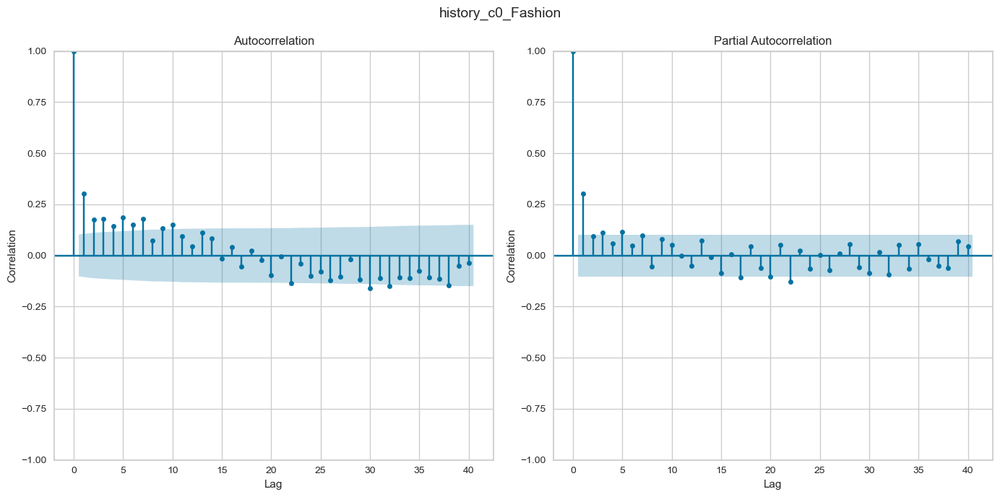

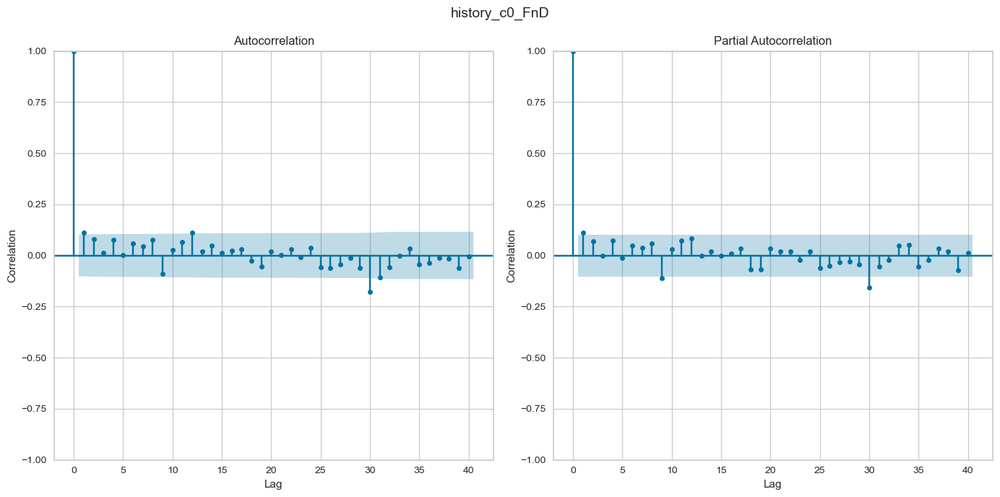

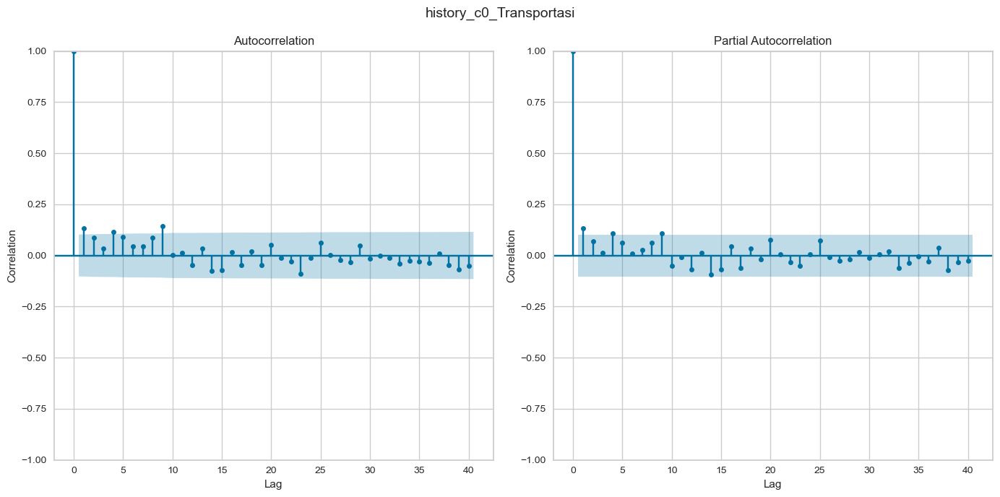

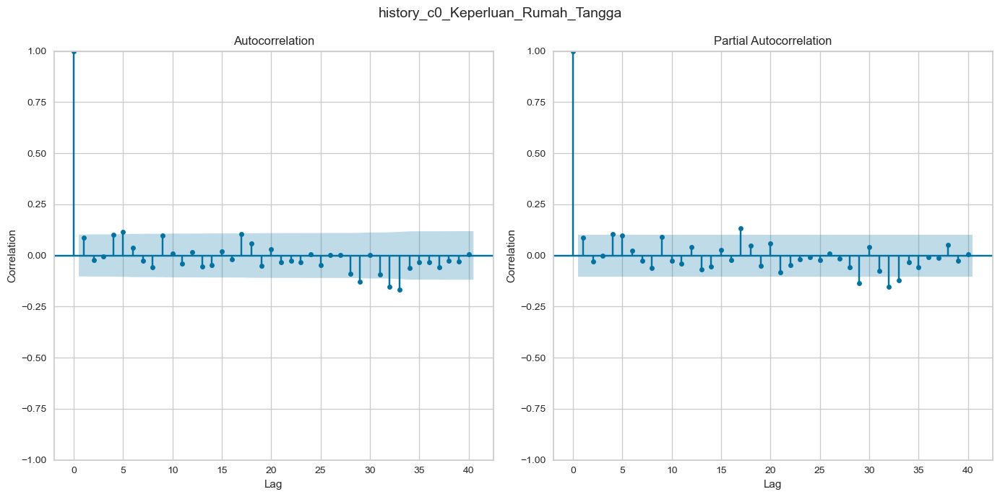

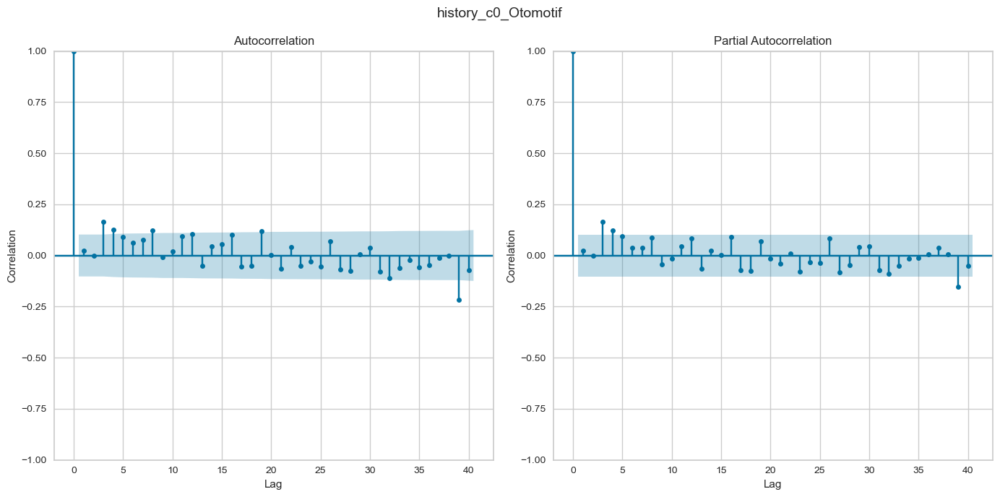

...

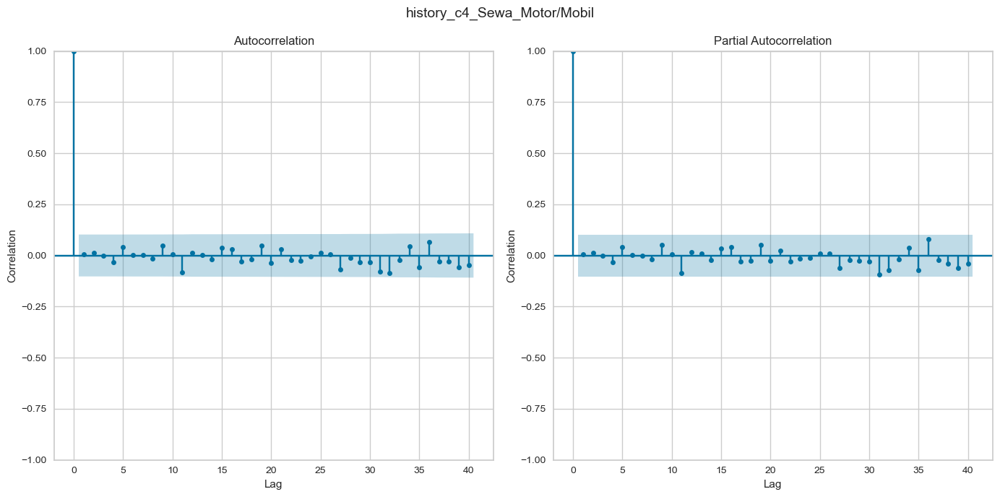

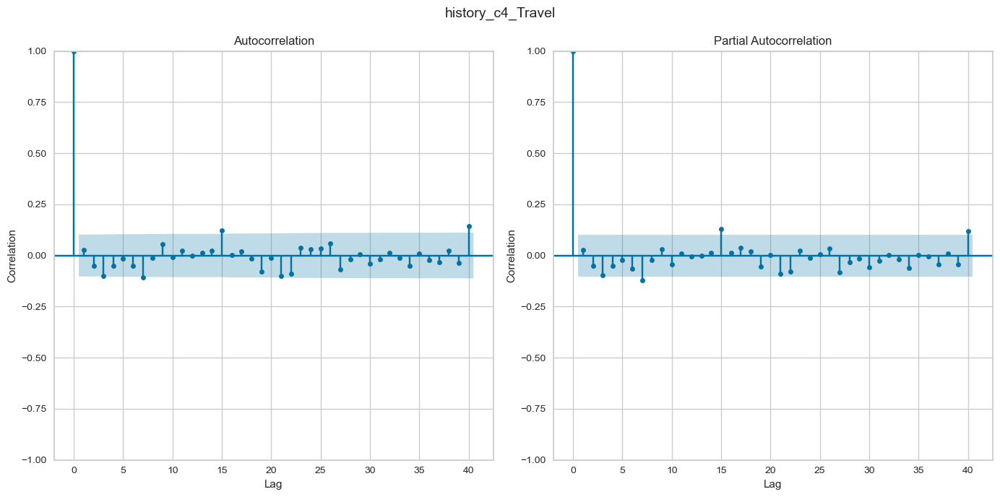

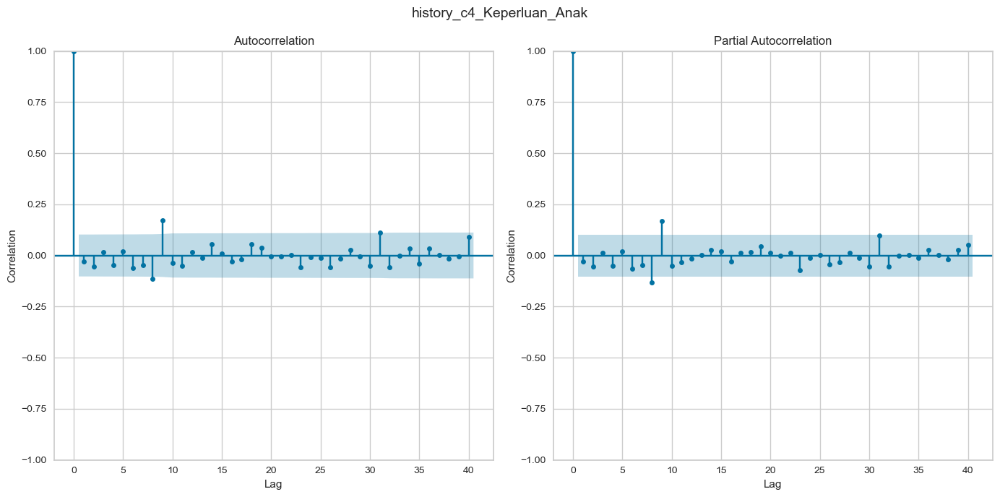

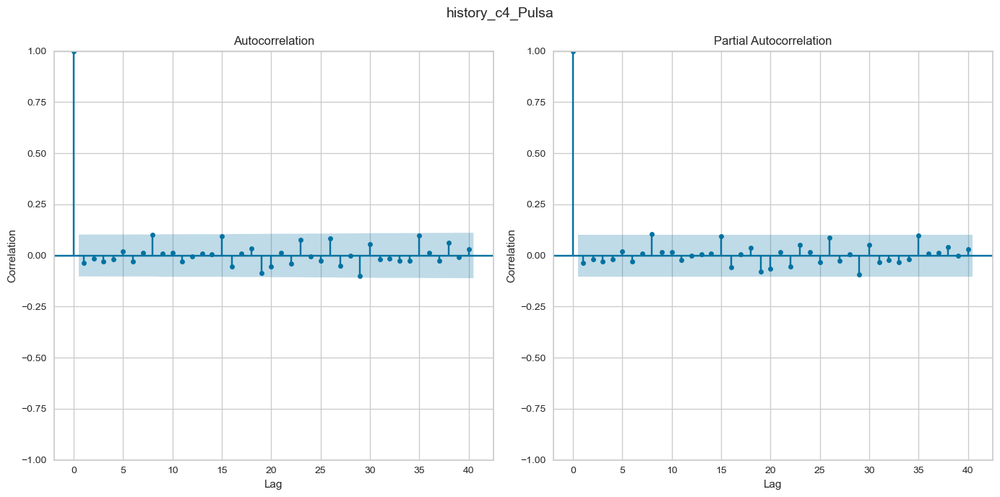

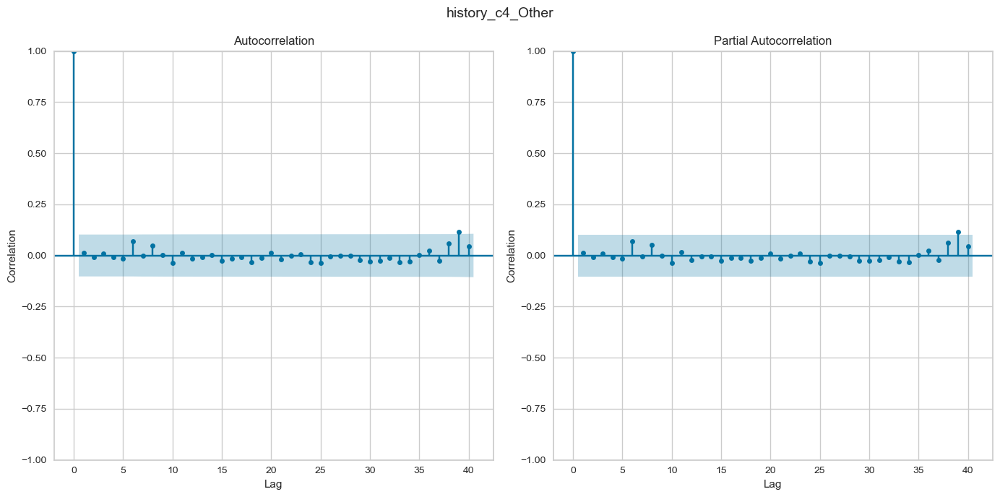

In [226]:
lag_data = []
highest_correlation = 0
highest_correlation_lag = 0
judul = "of total_gross_amount"

for variable_name, df in assignments.items():
    series = df['total_gross_amount']

    highest_correlation_per_df = 0  
    highest_correlation_lag_per_df = 0

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 7))
    fig.suptitle(f'{variable_name}', fontsize=14)  # Overall title

    # Plot ACF on the first subplot
    plot_acf(series, ax=ax1, title='Autocorrelation', lags=40)
    ax1.set_xlabel('Lag')
    ax1.set_ylabel('Correlation')

    # Plot PACF on the second subplot
    plot_pacf(series, ax=ax2, title='Partial Autocorrelation', lags=40)
    ax2.set_xlabel('Lag')
    ax2.set_ylabel('Correlation')

    plt.tight_layout()
    plt.show()

>*Dari hasil analisa ACF/PACF, terlihat bahwa lag data yang dihasilkan dari keseluruhan kolom terbilang stabil sehingga kita perlu menggunakan model ARIMA*

In [154]:
assignments_split_train = {}
assignments_split_test = {}

for variable_name, df in assignments.items():
  variable_name_split_train = f"train_set_{variable_name}"
  variable_name_split_test = f"test_set_{variable_name}"
  assignments_split_train[variable_name_split_train] = df[df['transaction_date'].dt.month < 11]
  assignments_split_test[variable_name_split_test] = df[df['transaction_date'].dt.month >= 11]
  assignments_split_train[variable_name_split_train].drop(columns=['transaction_date'], inplace=True)
  assignments_split_test[variable_name_split_test].drop(columns=['transaction_date'], inplace=True)
  assignments[variable_name].drop(columns=['transaction_date'], inplace=True)
  


Best model:  ARIMA(0,1,1)(0,1,1)[12]          
Total fit time: 14.790 seconds


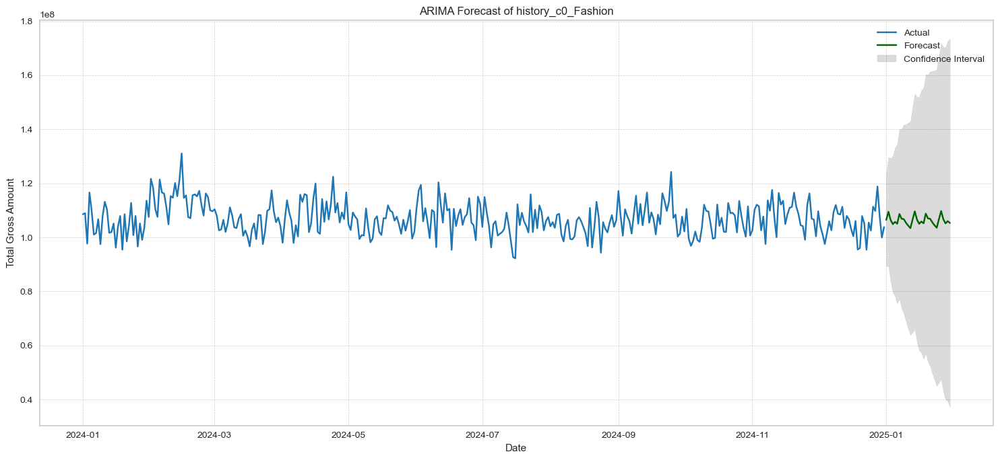


Best model:  ARIMA(2,1,2)(0,1,1)[12]          
Total fit time: 6.771 seconds


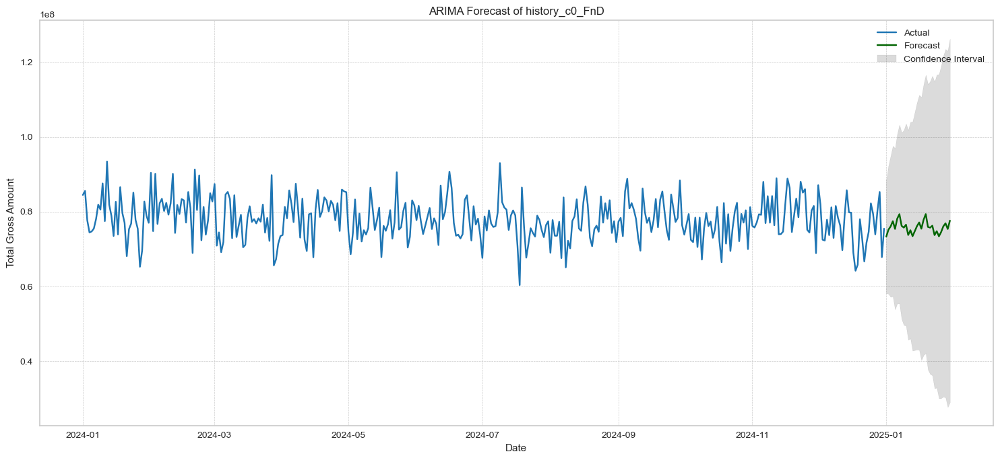


Best model:  ARIMA(1,1,2)(2,1,0)[12]          
Total fit time: 7.379 seconds


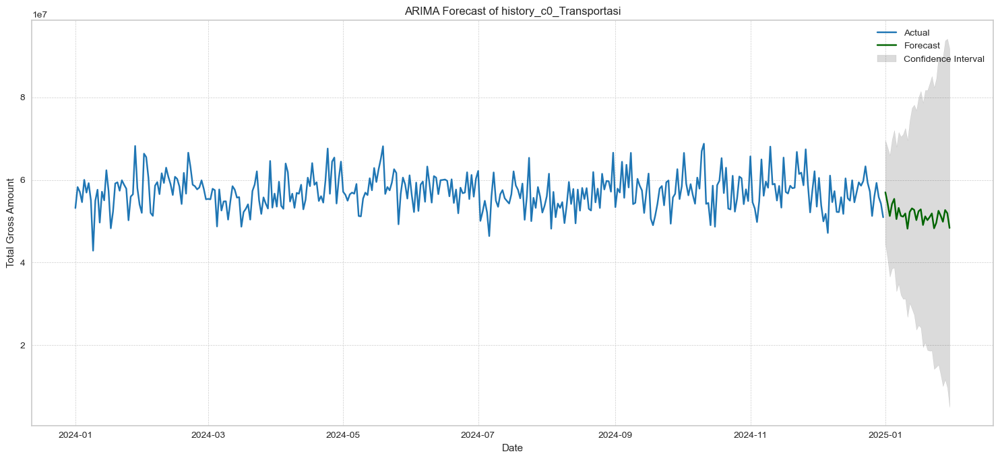


Best model:  ARIMA(0,1,1)(0,1,1)[12]          
Total fit time: 7.165 seconds


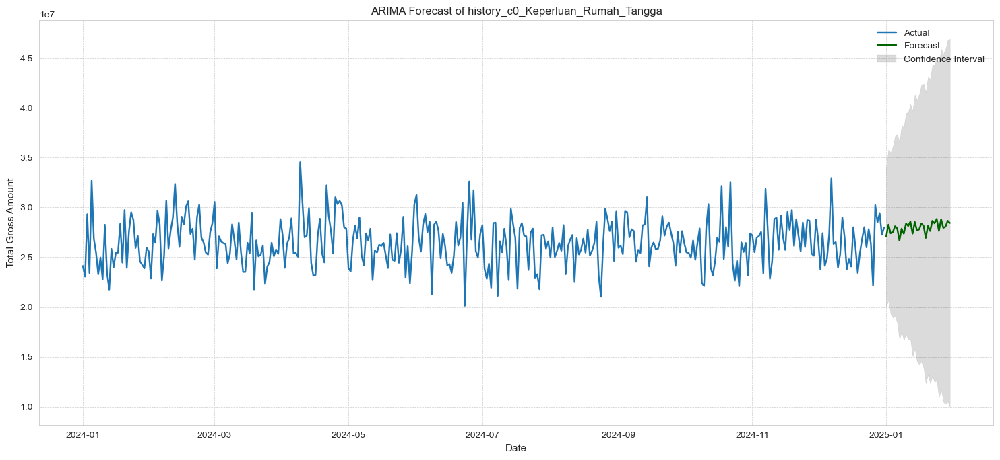


Best model:  ARIMA(2,1,1)(0,1,1)[12]          
Total fit time: 7.295 seconds


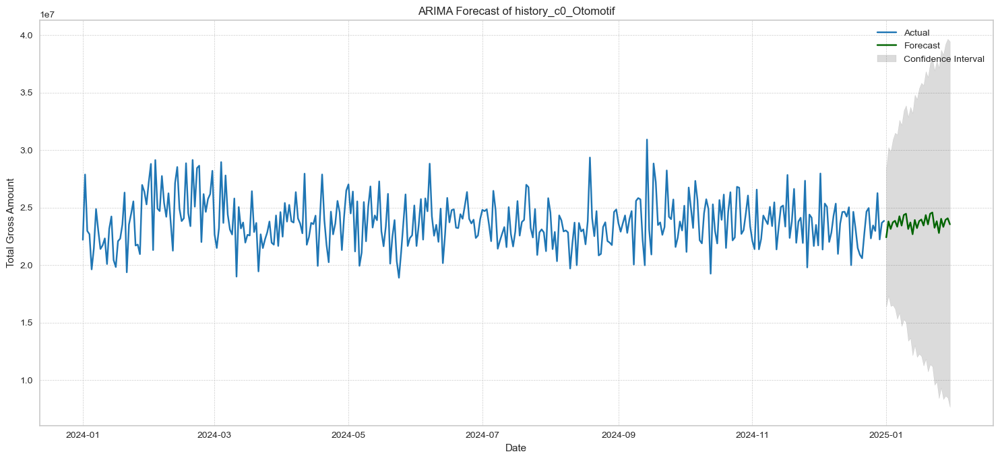


Best model:  ARIMA(0,1,2)(1,1,1)[12]          
Total fit time: 7.284 seconds


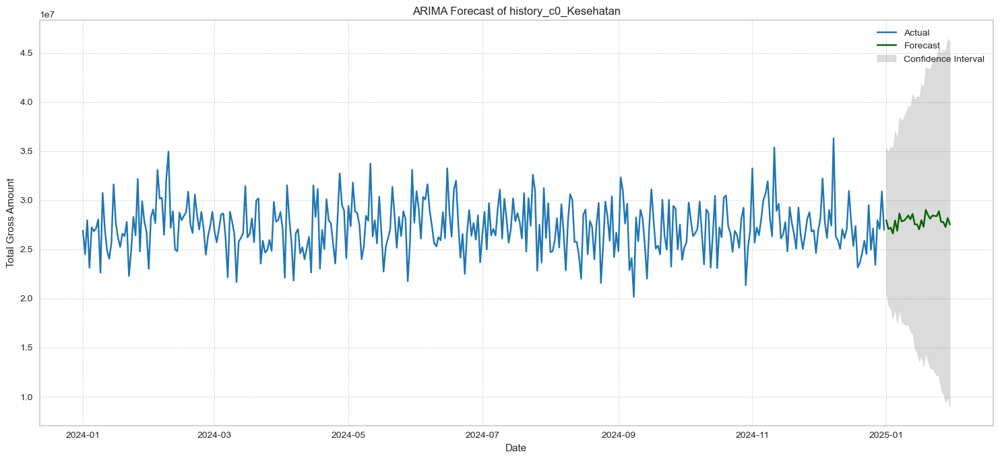


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 6.224 seconds


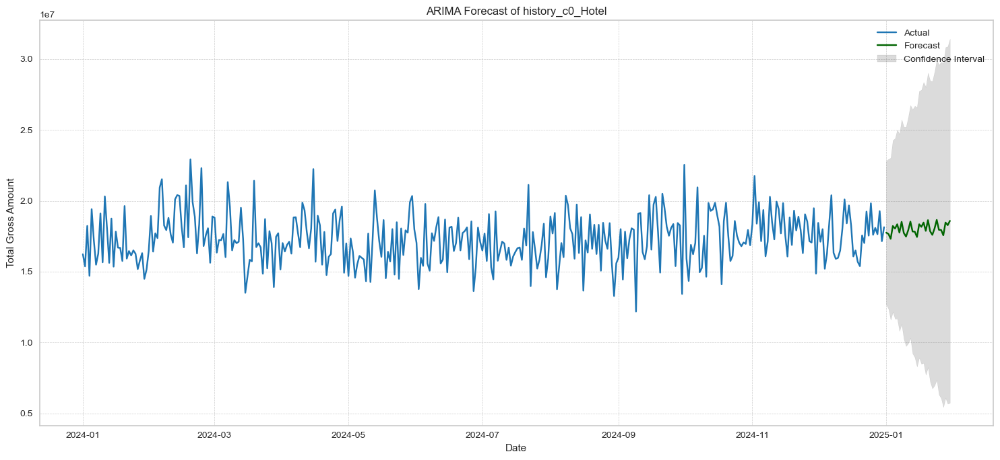


Best model:  ARIMA(2,1,2)(0,1,1)[12]          
Total fit time: 6.260 seconds


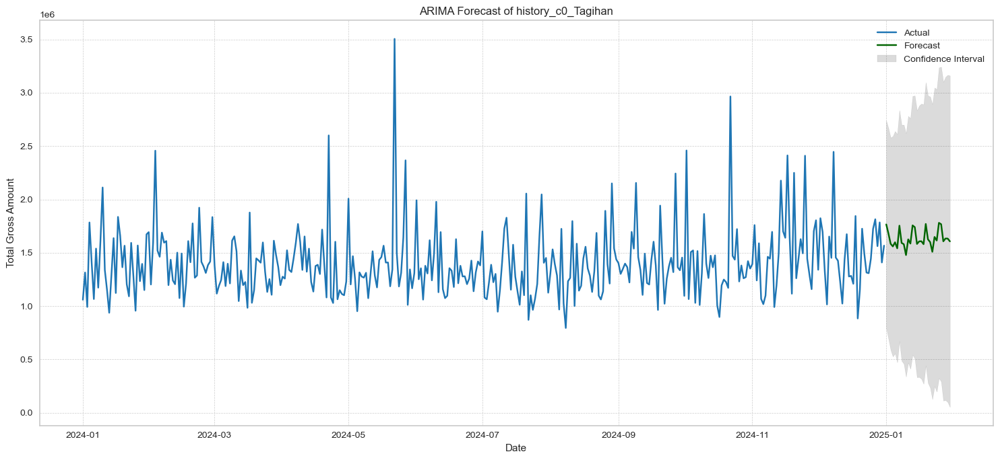


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 6.999 seconds


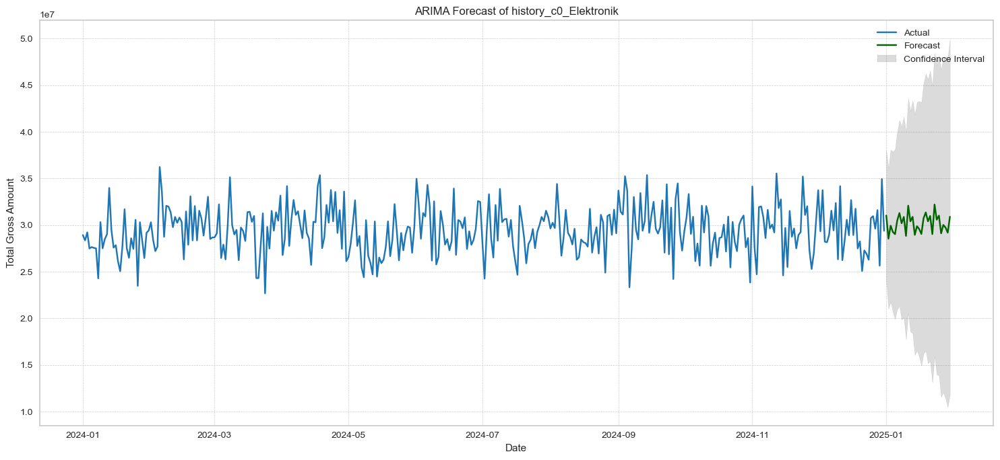


Best model:  ARIMA(1,1,2)(2,1,0)[12]          
Total fit time: 7.284 seconds


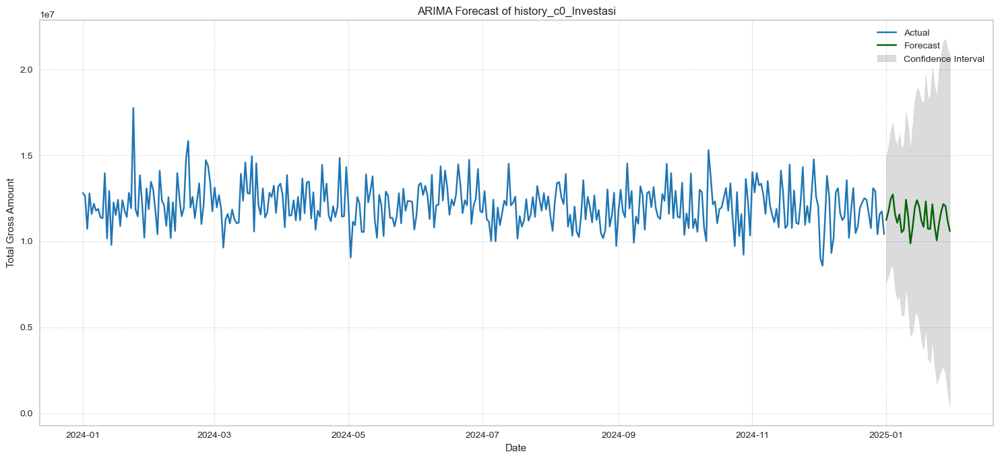


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 7.846 seconds


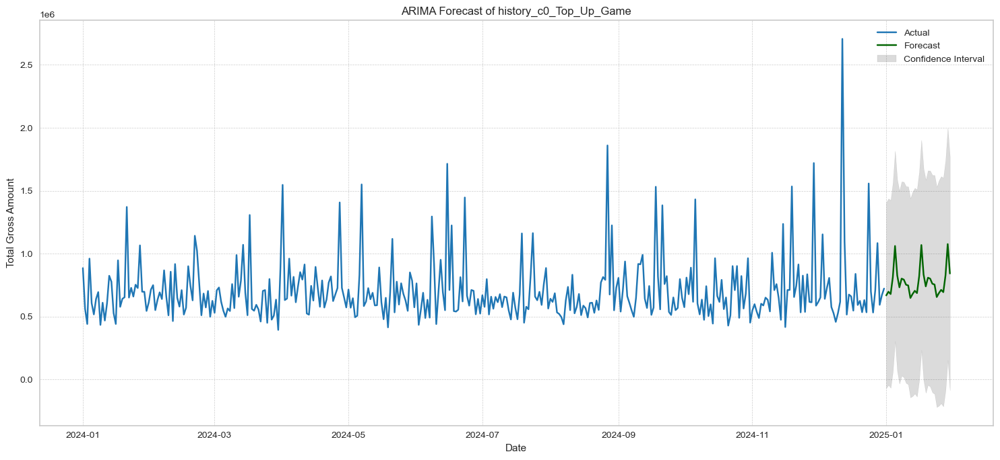


Best model:  ARIMA(1,1,2)(1,1,1)[12]          
Total fit time: 7.815 seconds


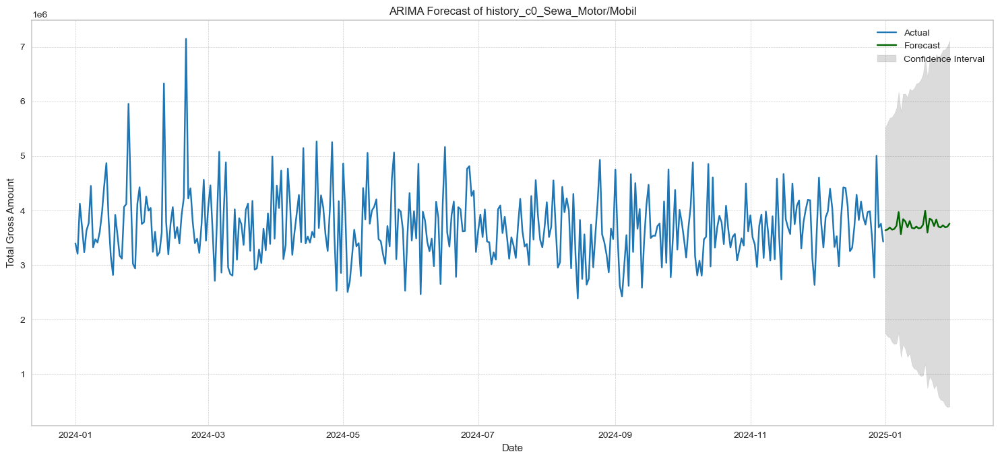


Best model:  ARIMA(1,1,2)(2,1,0)[12]          
Total fit time: 9.068 seconds


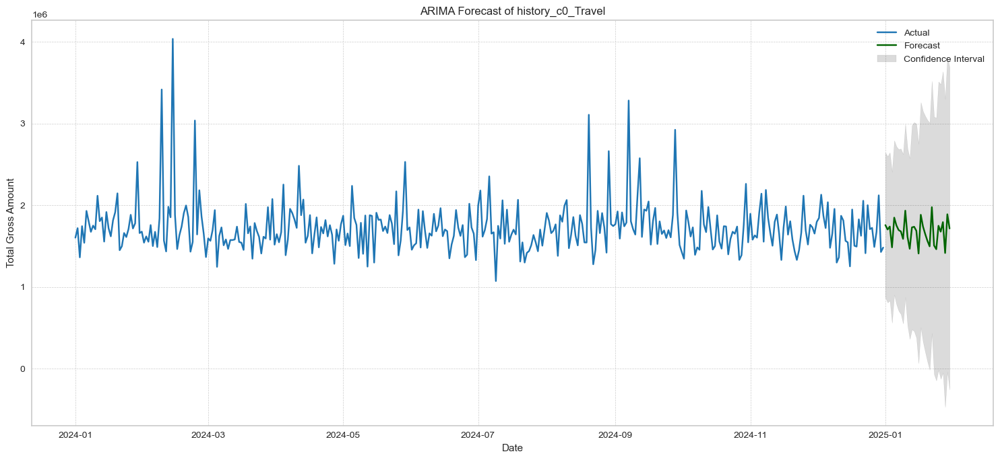


Best model:  ARIMA(1,1,2)(2,1,0)[12]          
Total fit time: 8.240 seconds


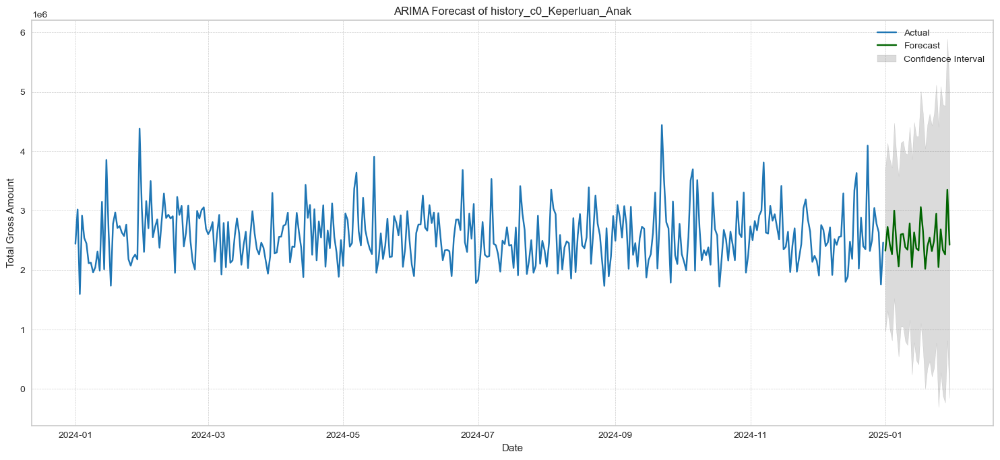


Best model:  ARIMA(0,1,1)(0,1,2)[12]          
Total fit time: 7.715 seconds


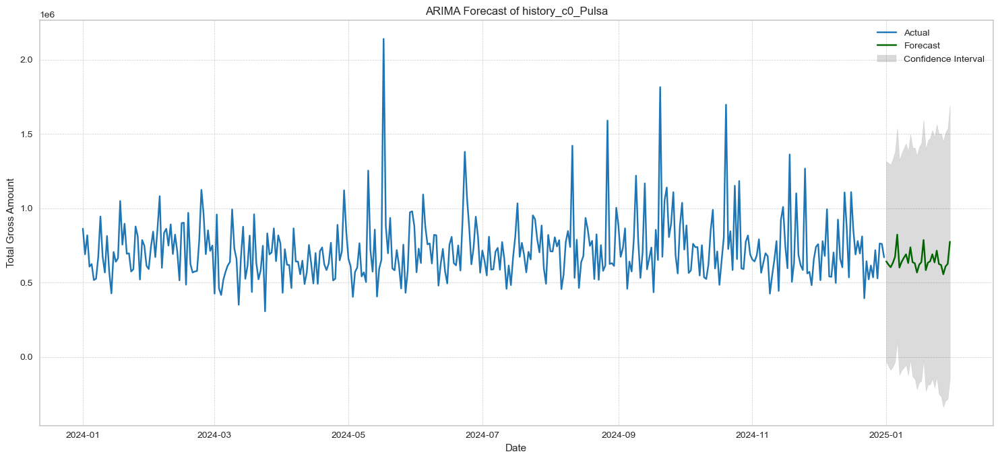


Best model:  ARIMA(0,1,1)(1,1,0)[12]          
Total fit time: 7.763 seconds


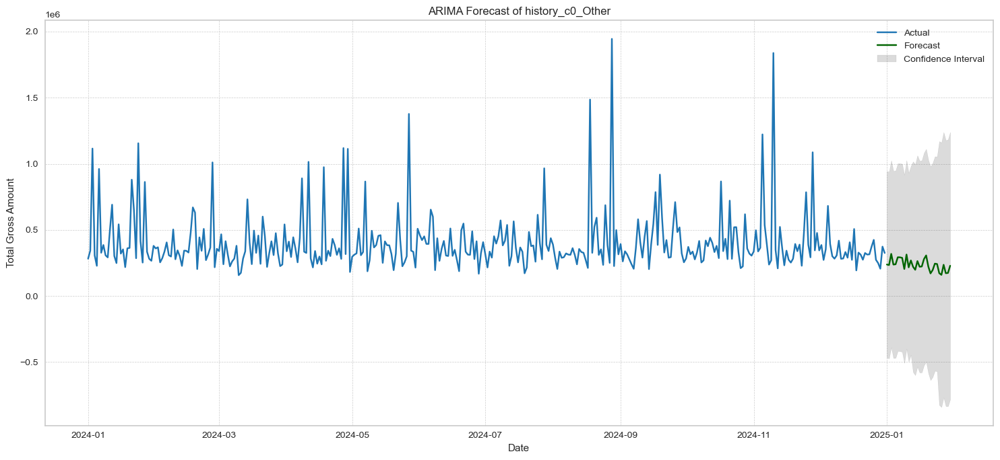


Best model:  ARIMA(2,1,2)(0,1,1)[12]          
Total fit time: 8.099 seconds


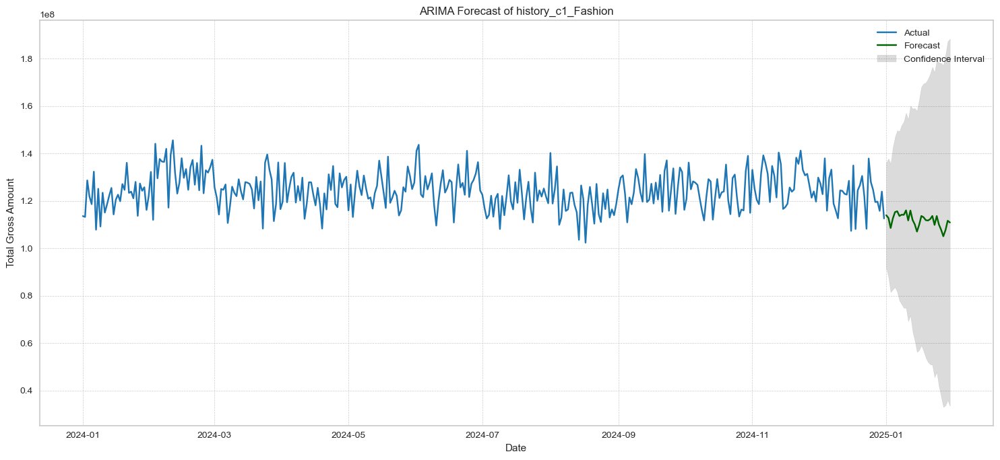


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 8.317 seconds


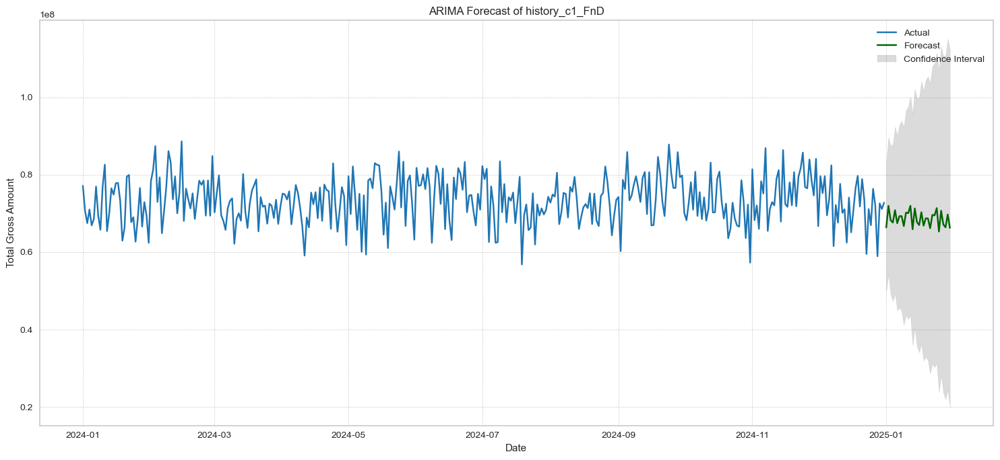


Best model:  ARIMA(1,1,2)(2,1,0)[12]          
Total fit time: 8.264 seconds


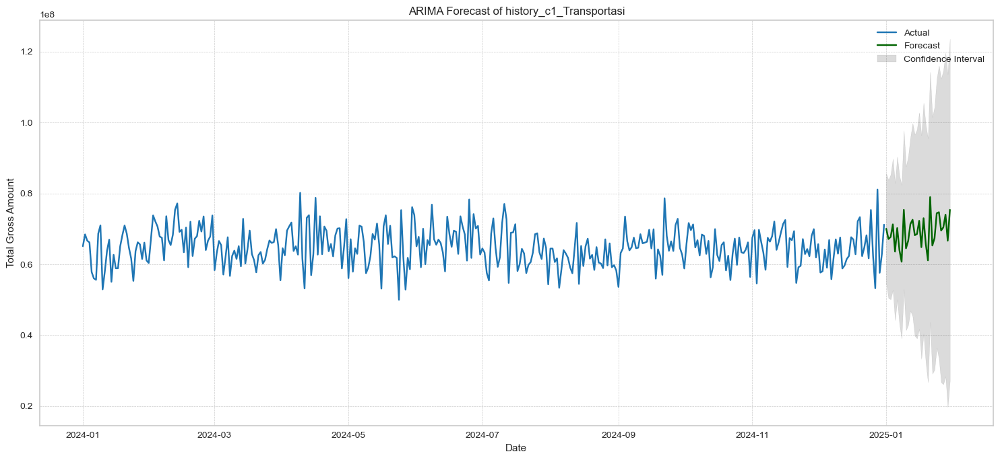


Best model:  ARIMA(2,1,2)(0,1,1)[12]          
Total fit time: 8.498 seconds


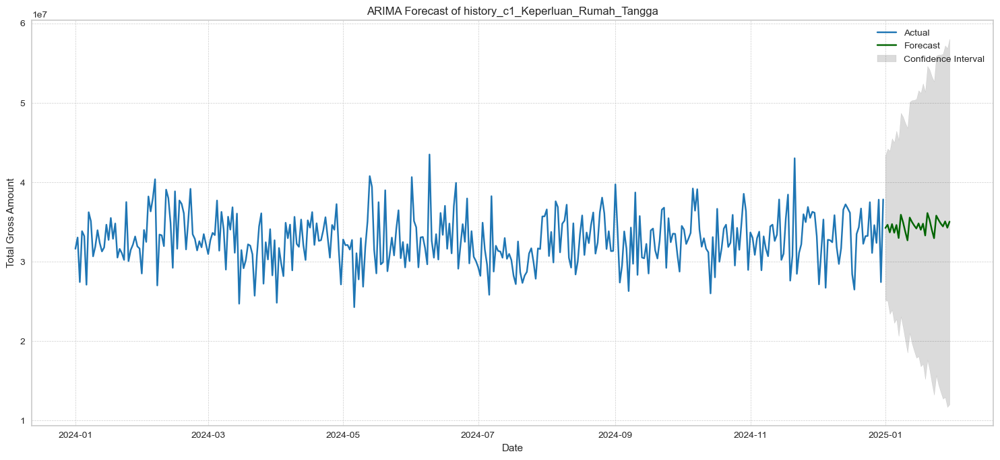


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 9.660 seconds


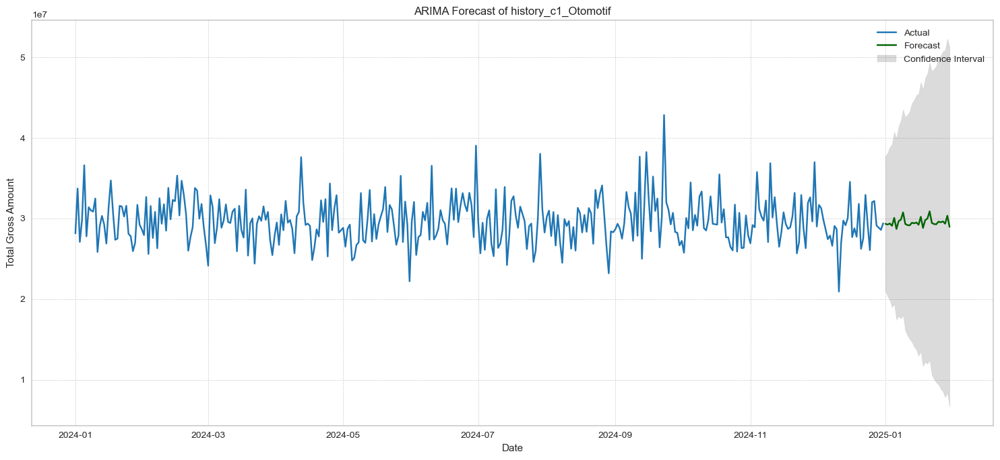


Best model:  ARIMA(0,1,1)(0,1,2)[12]          
Total fit time: 6.594 seconds


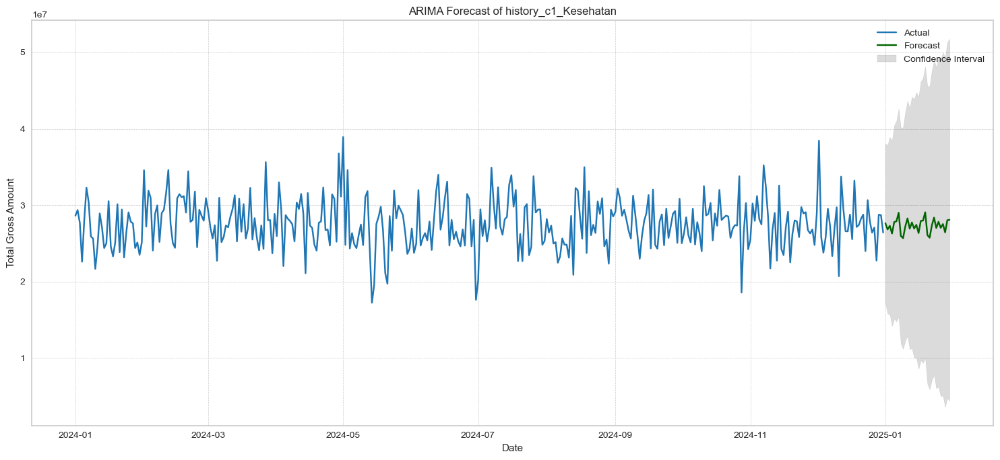


Best model:  ARIMA(1,1,2)(2,1,0)[12]          
Total fit time: 9.692 seconds


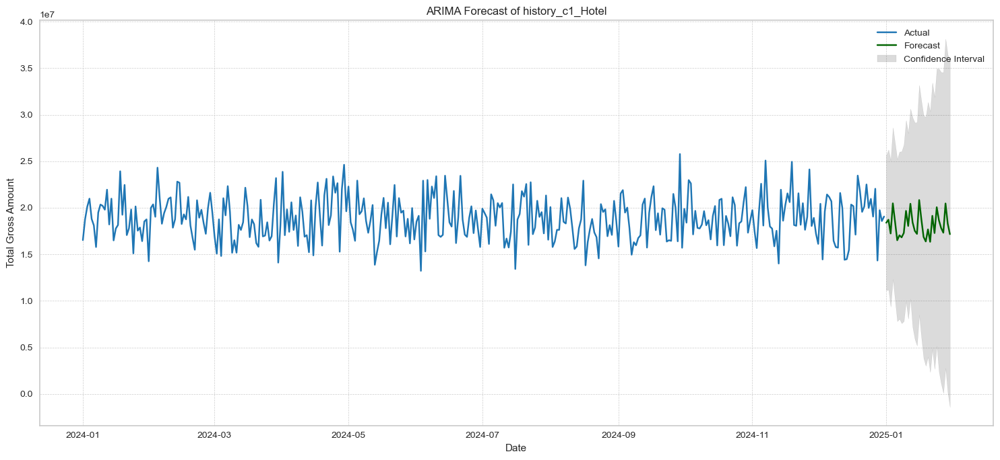


Best model:  ARIMA(1,1,2)(2,1,0)[12]          
Total fit time: 8.897 seconds


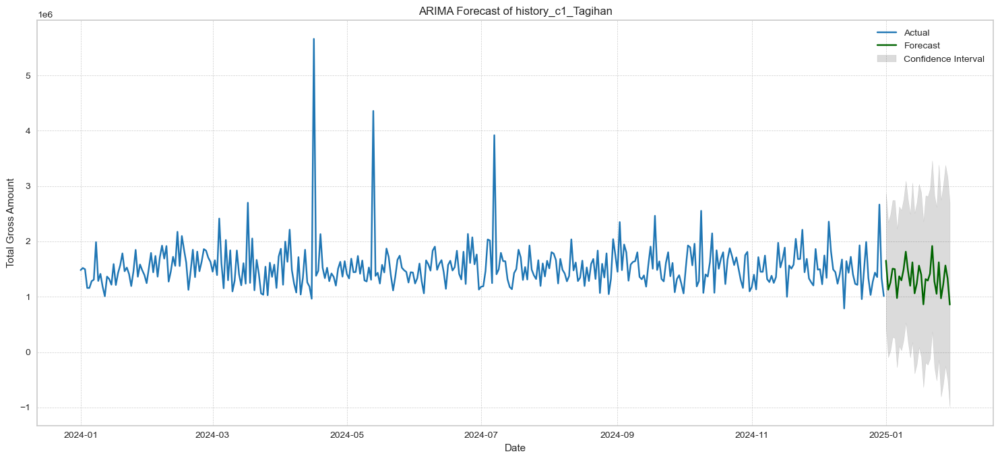


Best model:  ARIMA(0,1,3)(0,1,2)[12]          
Total fit time: 7.113 seconds


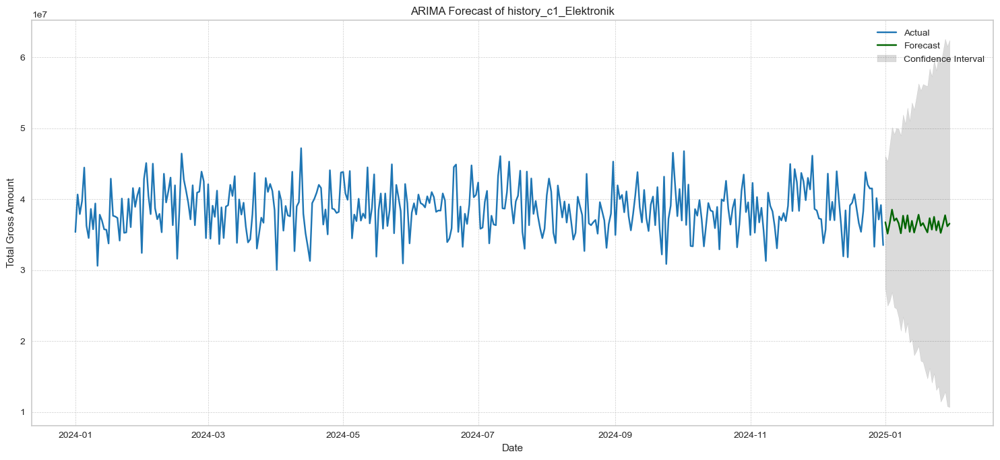


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 7.799 seconds


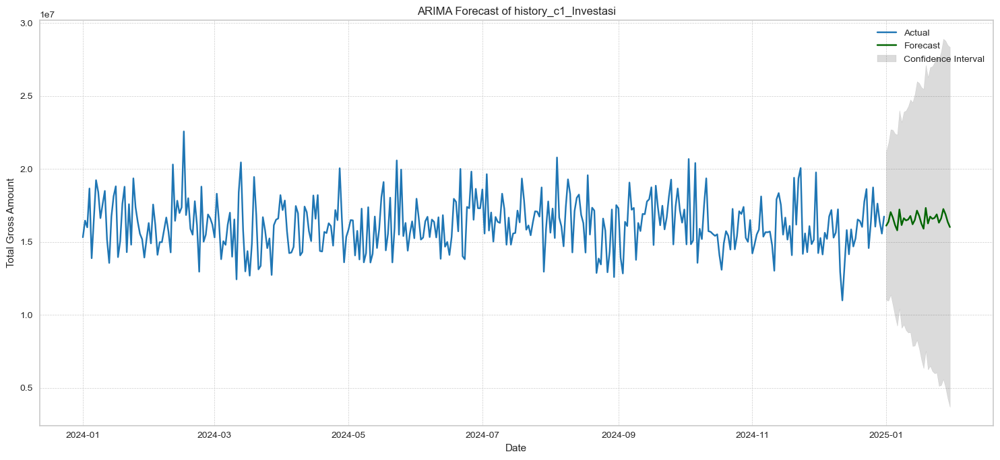


Best model:  ARIMA(1,1,2)(2,1,0)[12]          
Total fit time: 10.788 seconds


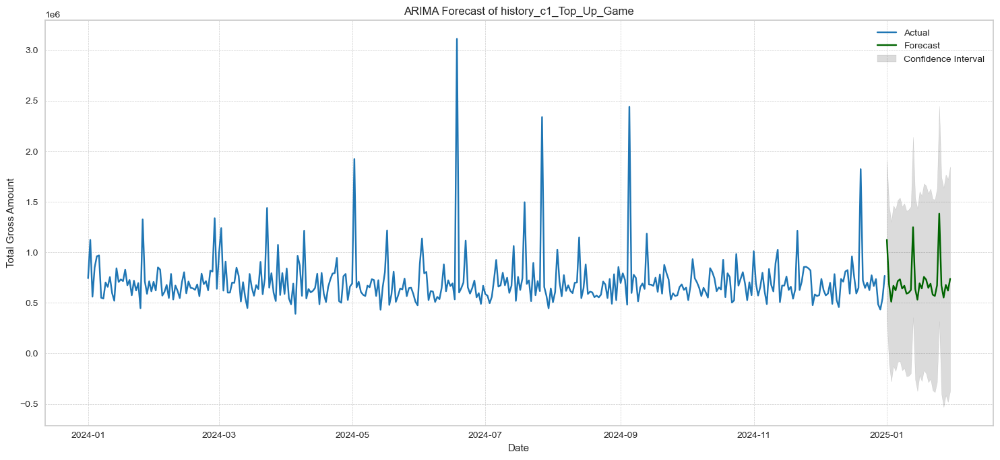


Best model:  ARIMA(0,1,2)(1,1,1)[12]          
Total fit time: 10.339 seconds


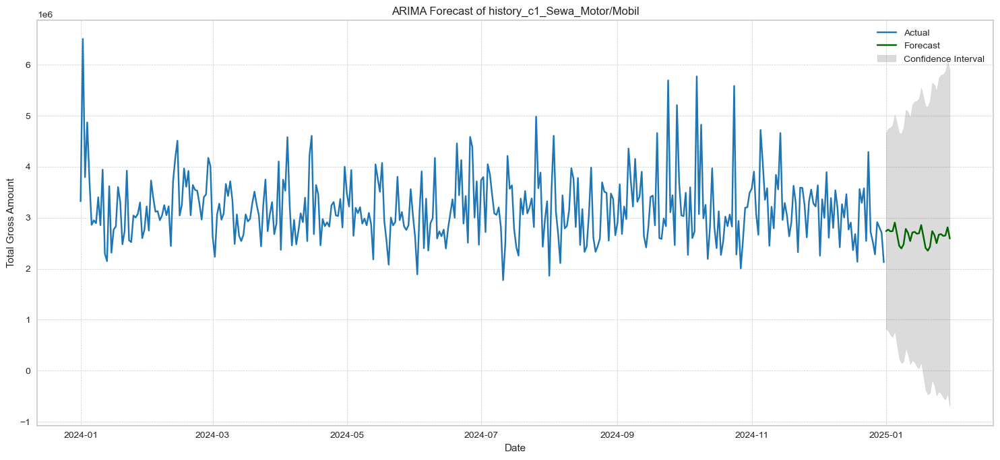


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 8.993 seconds


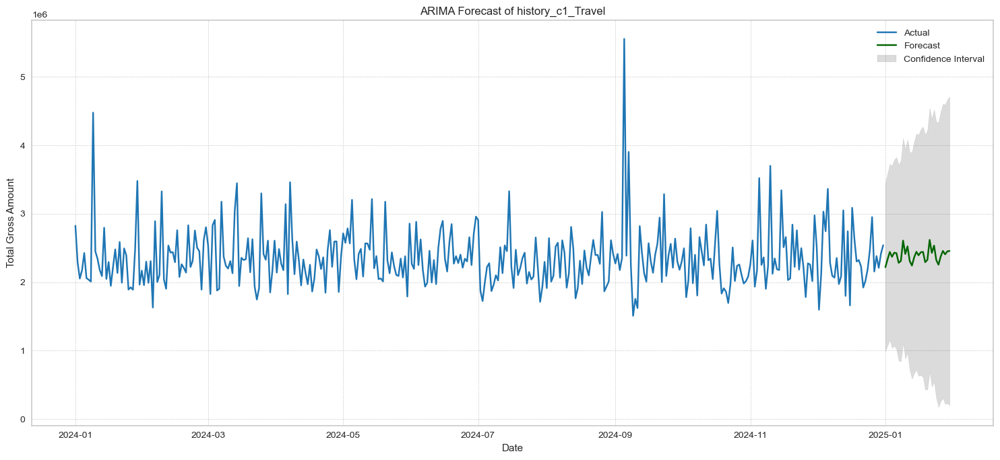


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 8.206 seconds


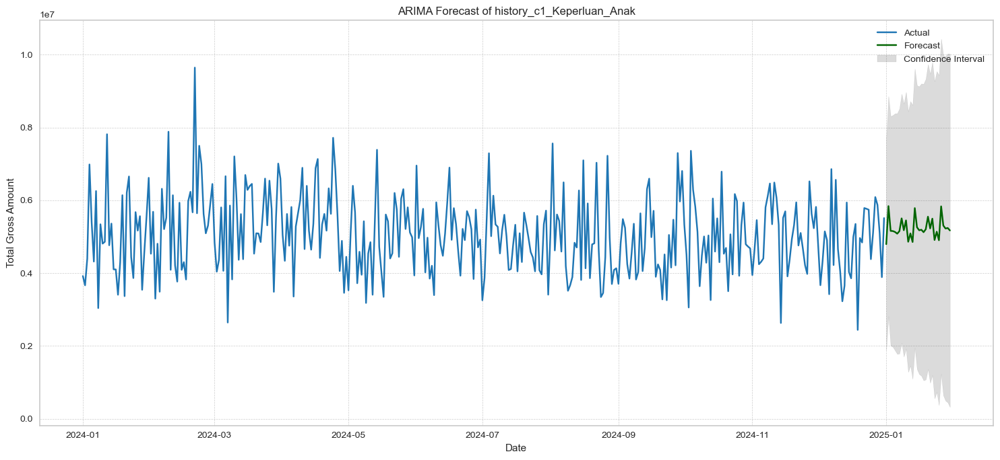


Best model:  ARIMA(0,1,1)(0,1,1)[12]          
Total fit time: 7.594 seconds


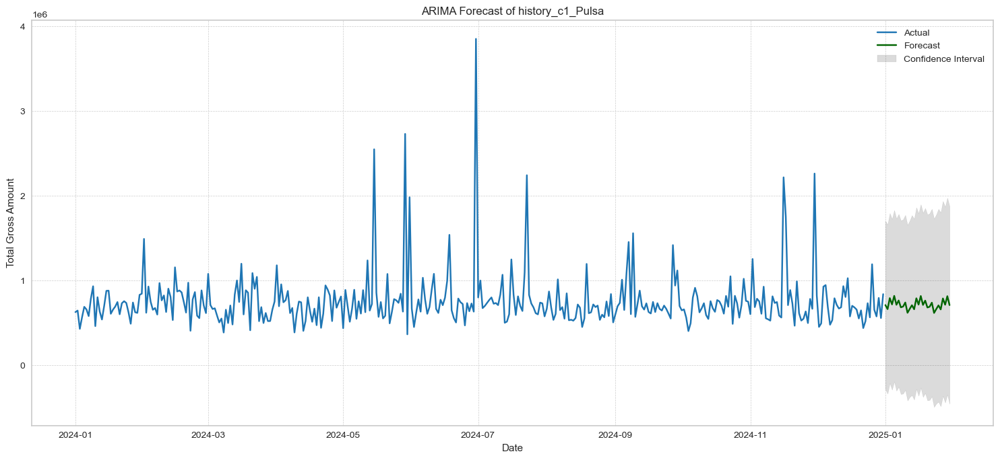


Best model:  ARIMA(0,1,3)(0,1,2)[12]          
Total fit time: 7.028 seconds


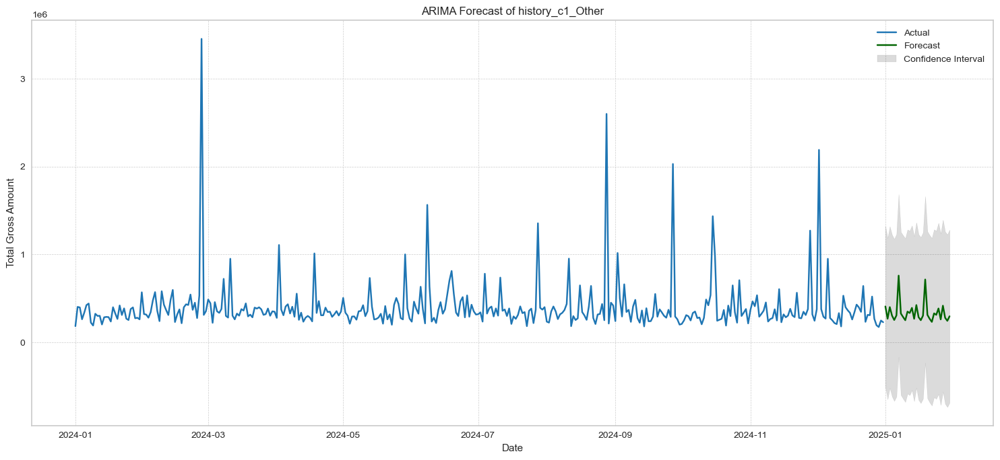


Best model:  ARIMA(0,1,3)(0,1,2)[12]          
Total fit time: 7.199 seconds


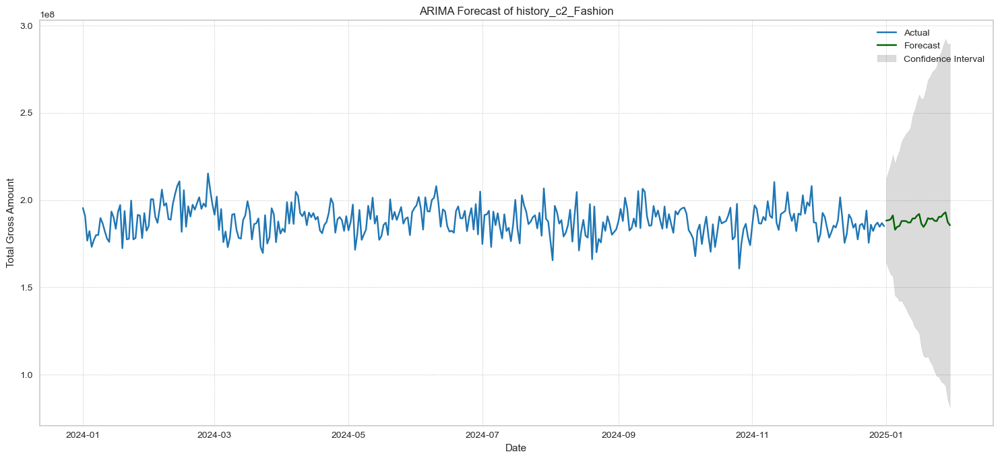


Best model:  ARIMA(1,1,2)(1,1,1)[12]          
Total fit time: 10.970 seconds


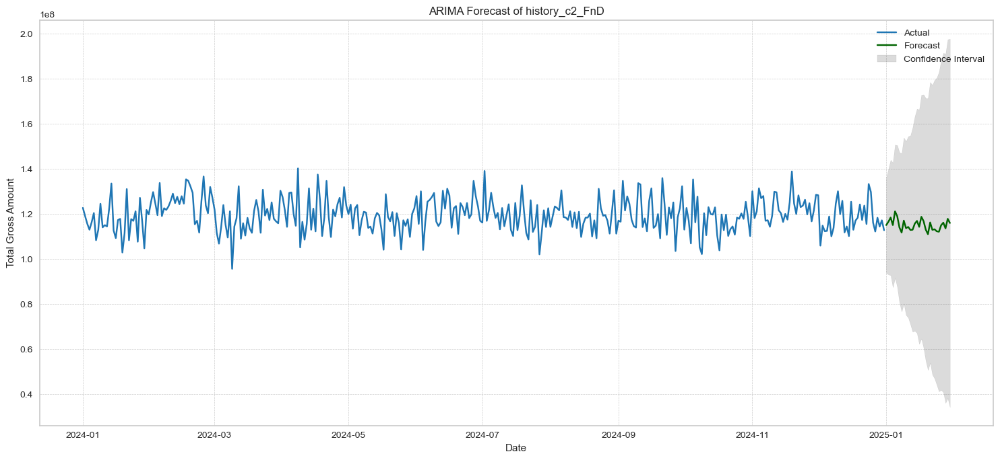


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 7.291 seconds


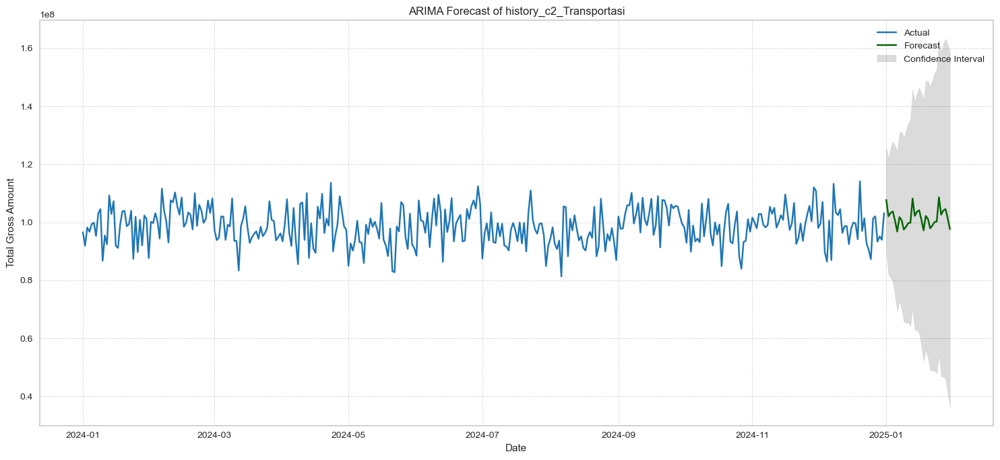


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 8.547 seconds


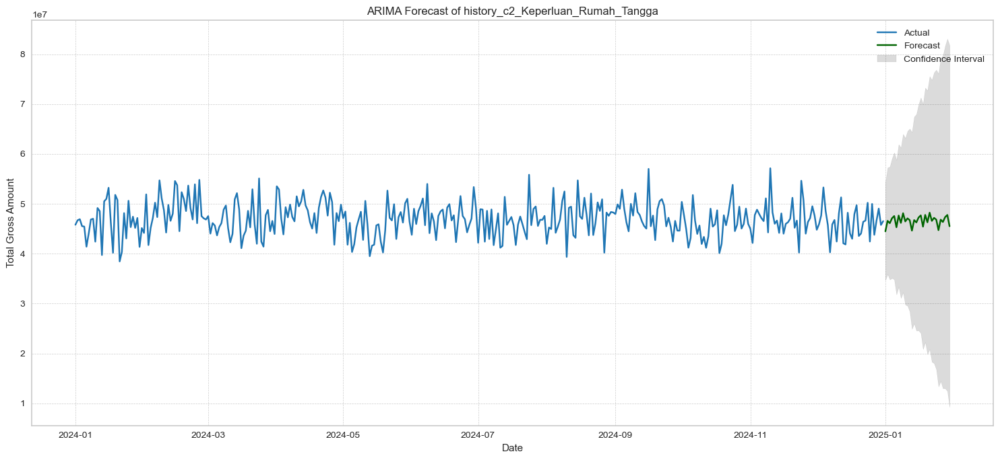


Best model:  ARIMA(1,1,2)(1,1,1)[12]          
Total fit time: 9.006 seconds


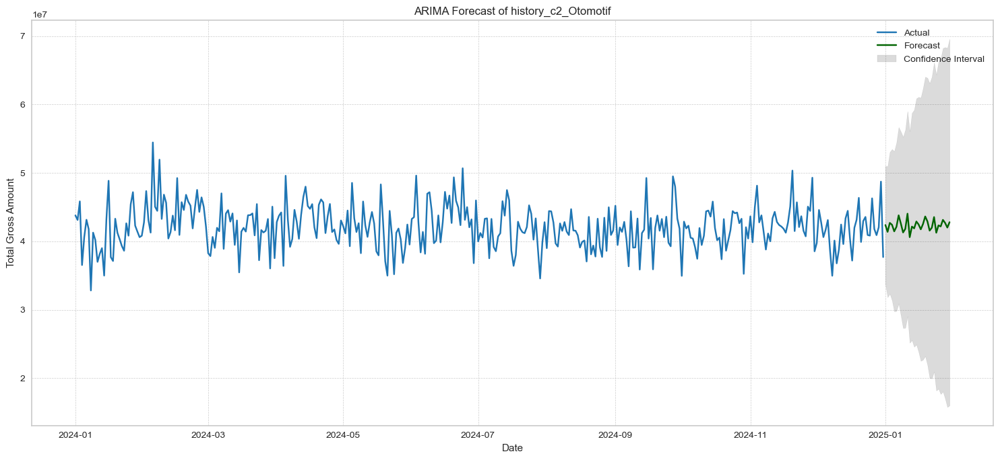


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 9.825 seconds


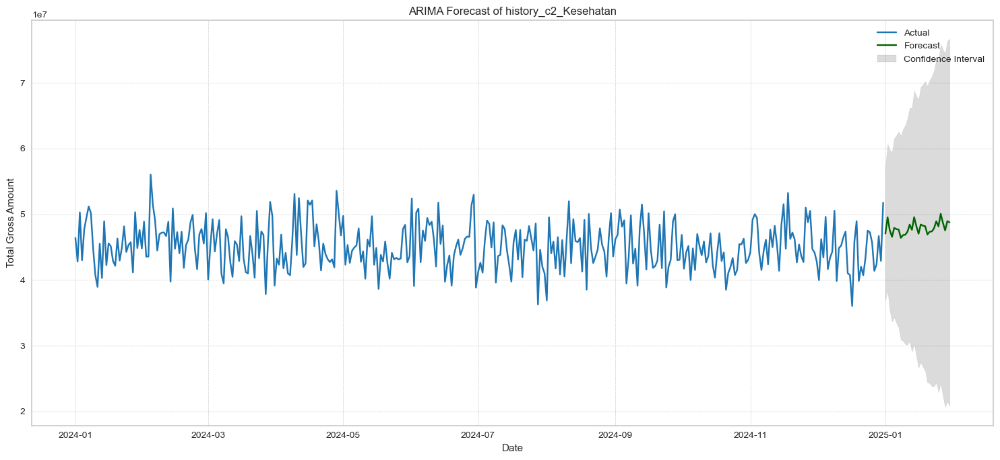


Best model:  ARIMA(1,1,2)(2,1,0)[12]          
Total fit time: 6.314 seconds


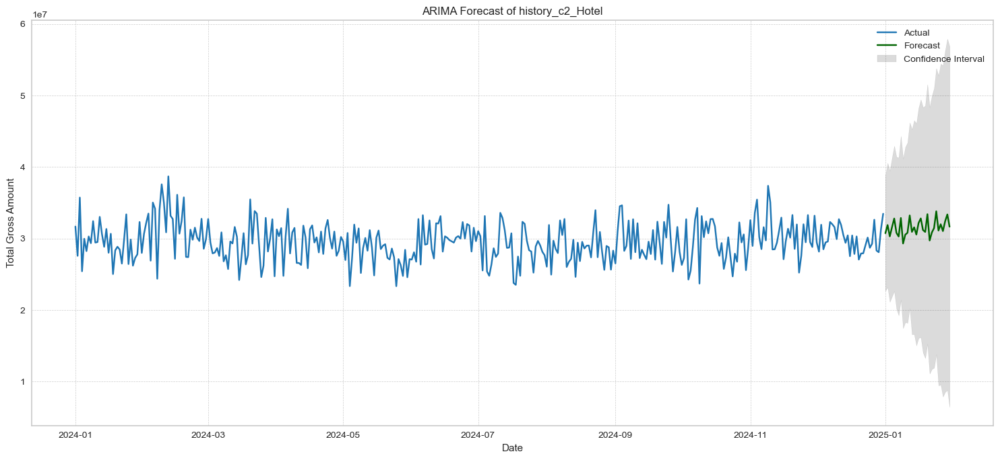


Best model:  ARIMA(0,1,1)(0,1,1)[12]          
Total fit time: 7.582 seconds


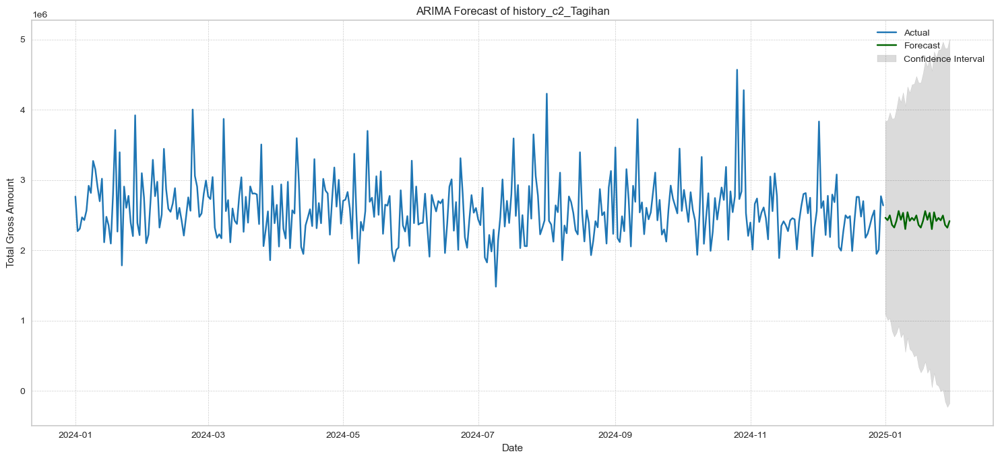


Best model:  ARIMA(2,1,2)(0,1,1)[12]          
Total fit time: 6.986 seconds


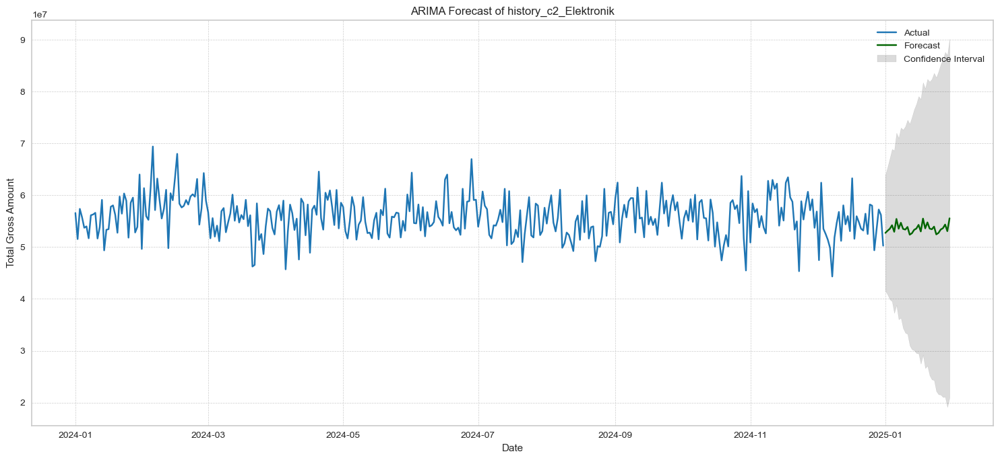


Best model:  ARIMA(0,1,2)(1,1,1)[12]          
Total fit time: 7.112 seconds


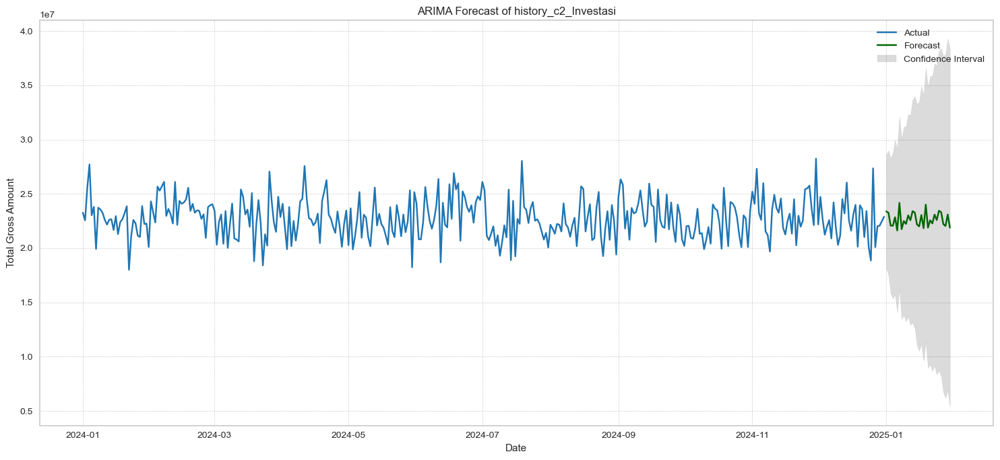


Best model:  ARIMA(1,1,2)(2,1,0)[12]          
Total fit time: 8.056 seconds


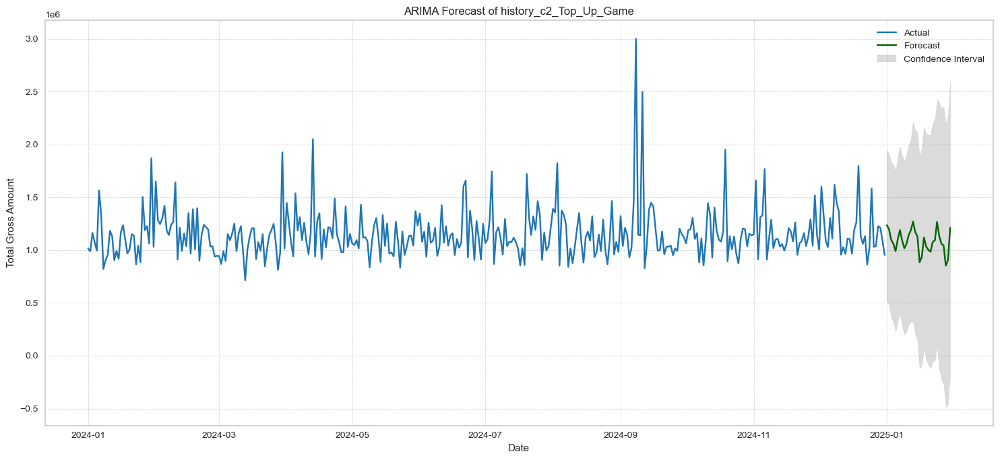


Best model:  ARIMA(2,1,2)(0,1,1)[12]          
Total fit time: 6.905 seconds


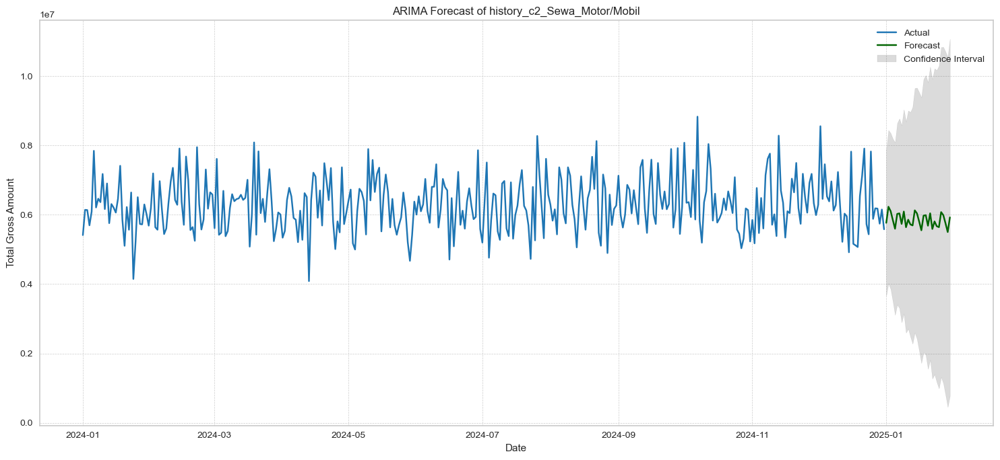


Best model:  ARIMA(2,1,2)(0,1,1)[12]          
Total fit time: 6.537 seconds


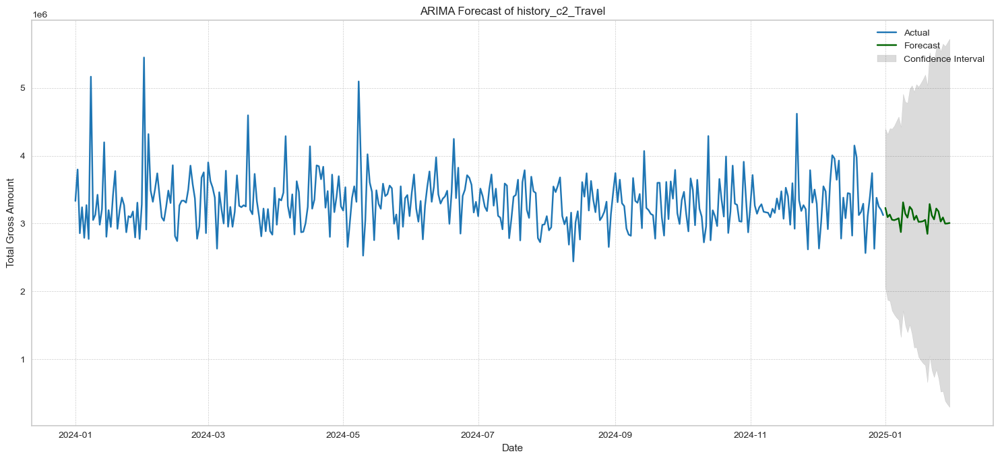


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 6.651 seconds


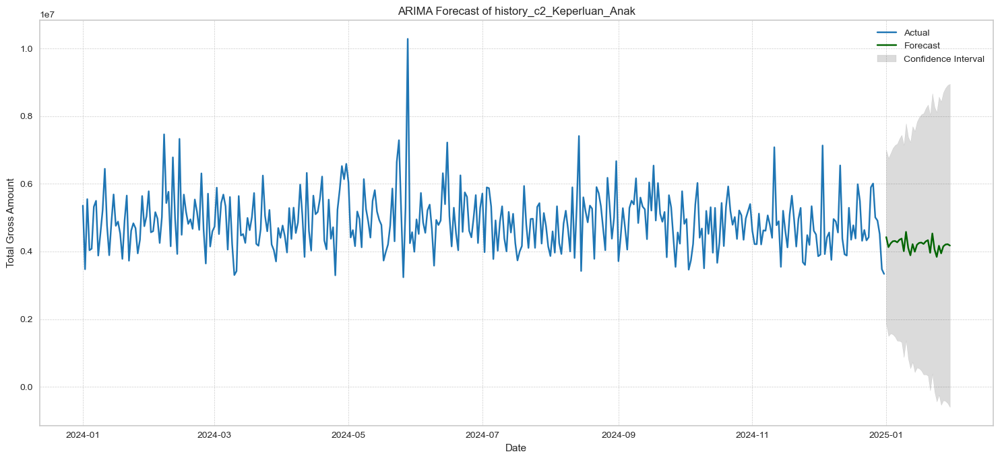


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 8.494 seconds


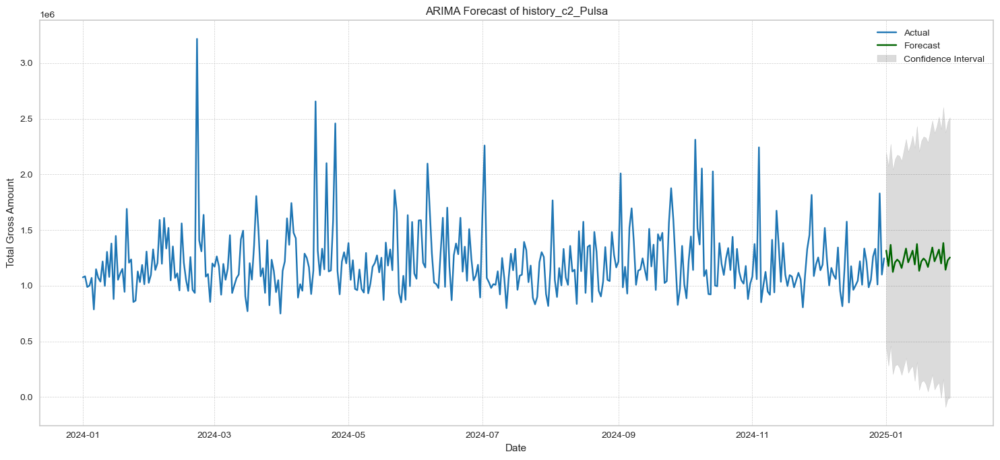


Best model:  ARIMA(0,1,1)(0,1,1)[12]          
Total fit time: 7.905 seconds


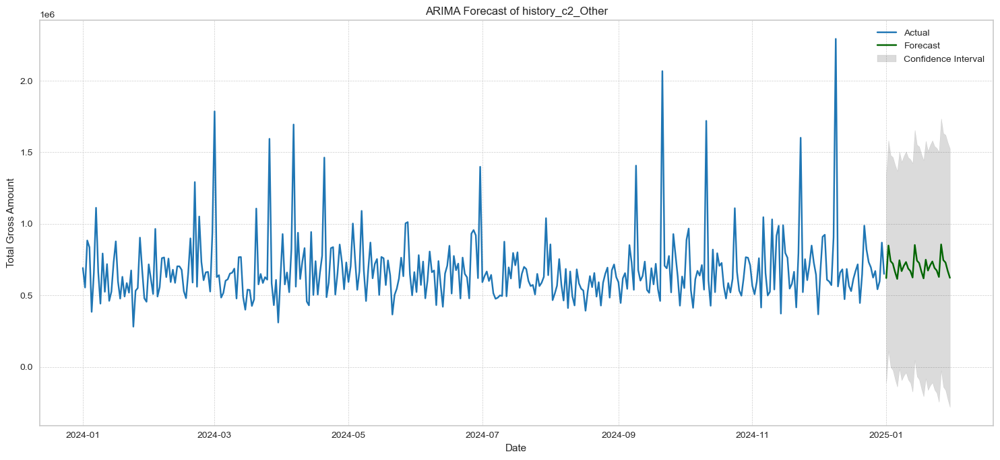


Best model:  ARIMA(2,1,1)(0,1,1)[12]          
Total fit time: 8.668 seconds


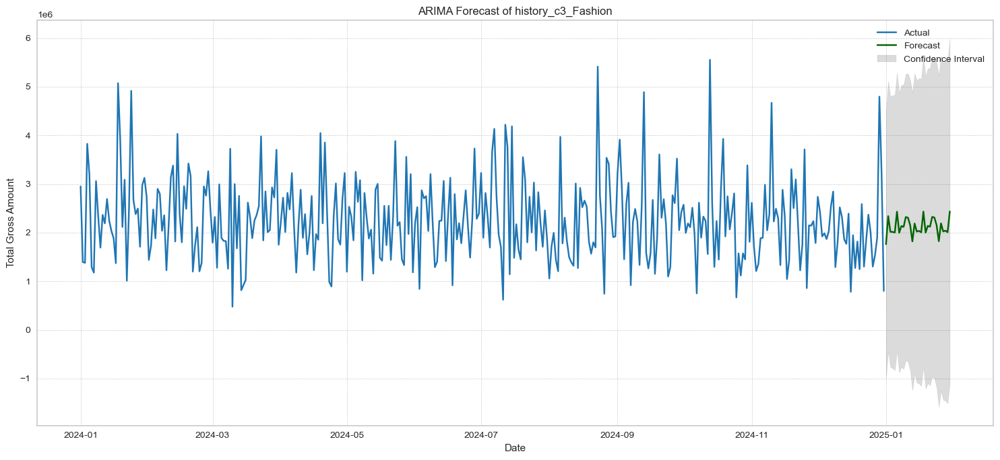


Best model:  ARIMA(0,1,3)(0,1,2)[12]          
Total fit time: 7.406 seconds


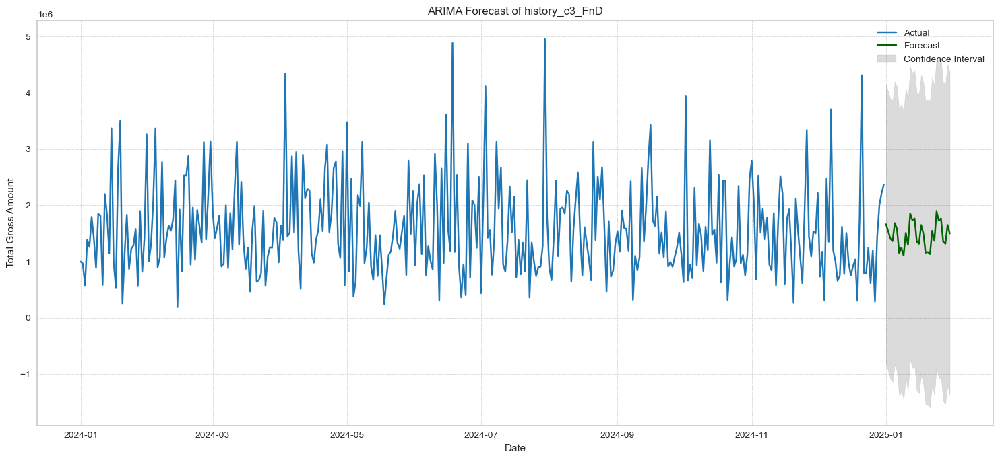


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 8.063 seconds


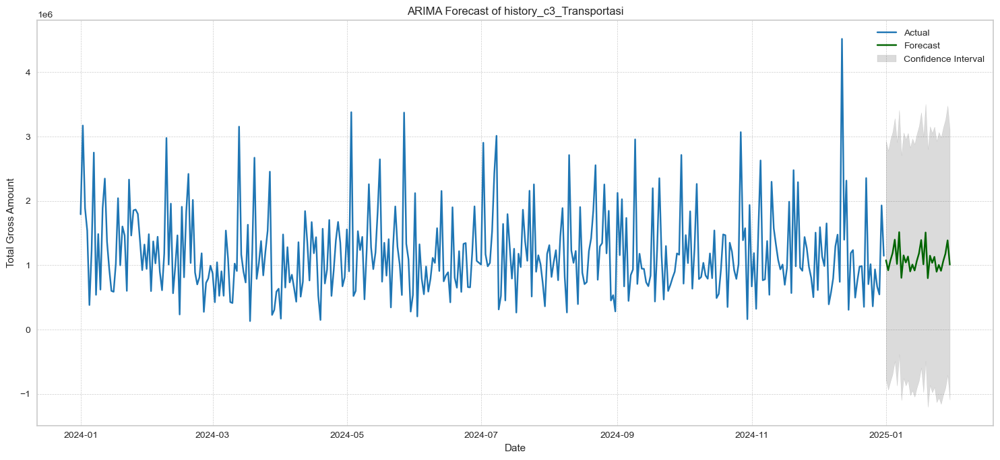


Best model:  ARIMA(0,1,3)(1,1,1)[12]          
Total fit time: 8.372 seconds


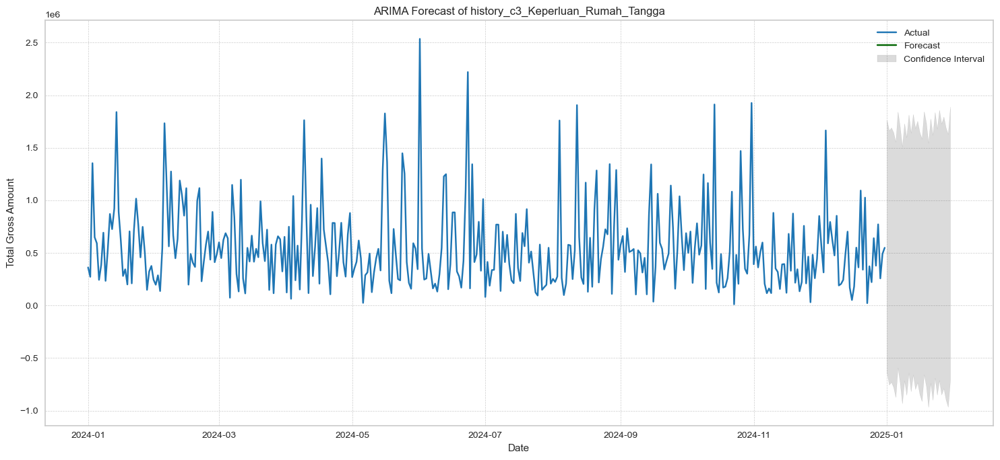


Best model:  ARIMA(1,1,2)(2,1,0)[12]          
Total fit time: 7.520 seconds


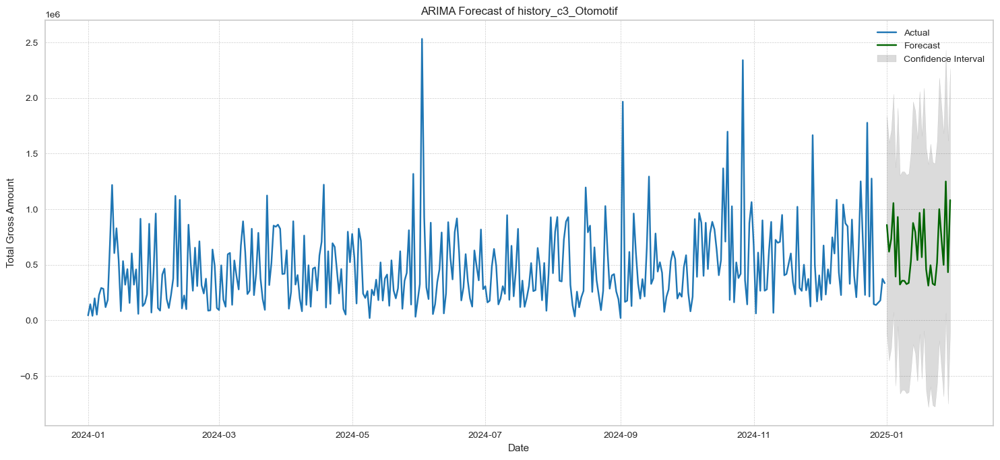


Best model:  ARIMA(1,1,2)(1,1,1)[12]          
Total fit time: 6.658 seconds


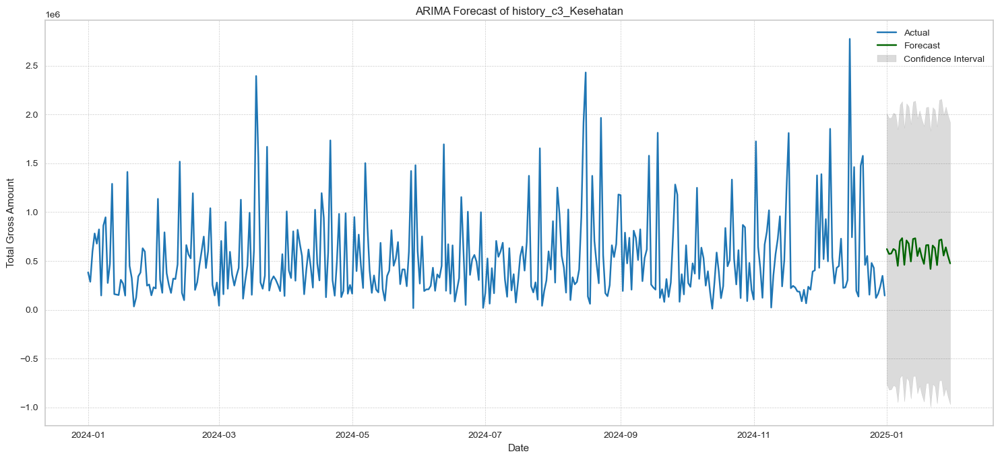


Best model:  ARIMA(2,1,1)(0,1,1)[12]          
Total fit time: 7.703 seconds


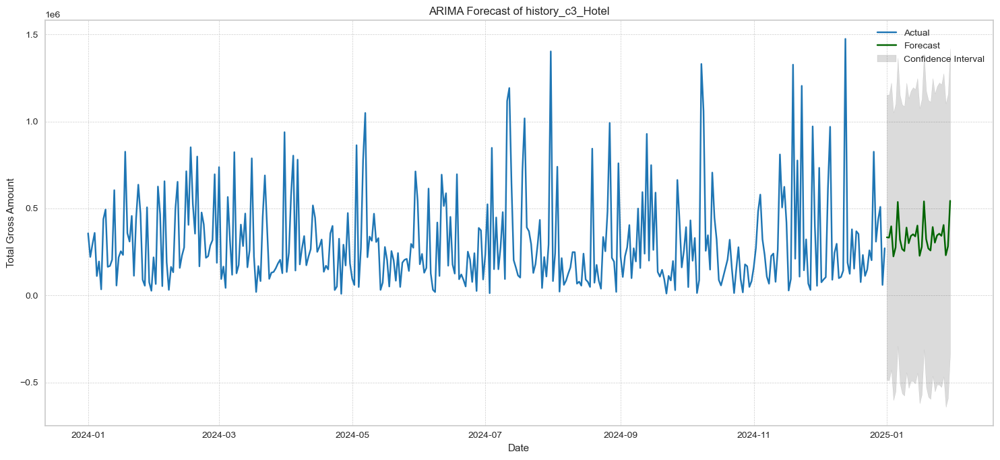


Best model:  ARIMA(2,1,2)(0,1,1)[12]          
Total fit time: 6.916 seconds


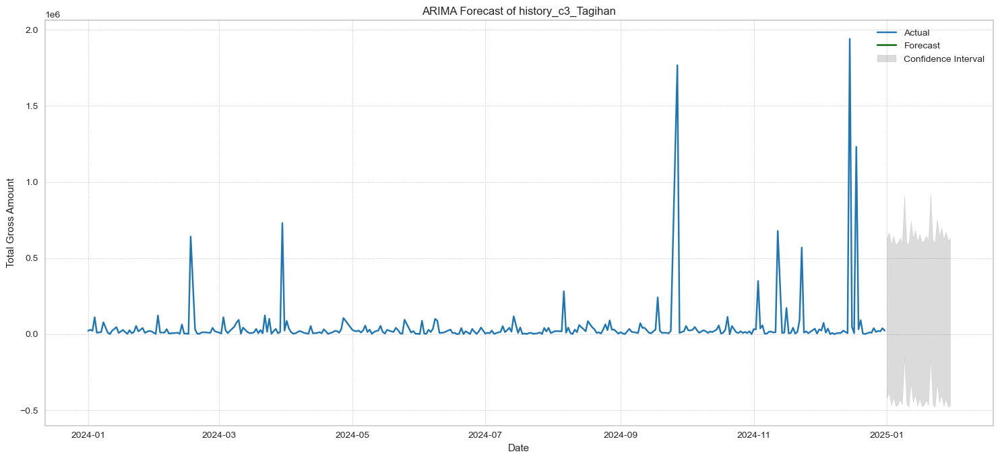


Best model:  ARIMA(0,1,1)(0,1,2)[12]          
Total fit time: 7.943 seconds


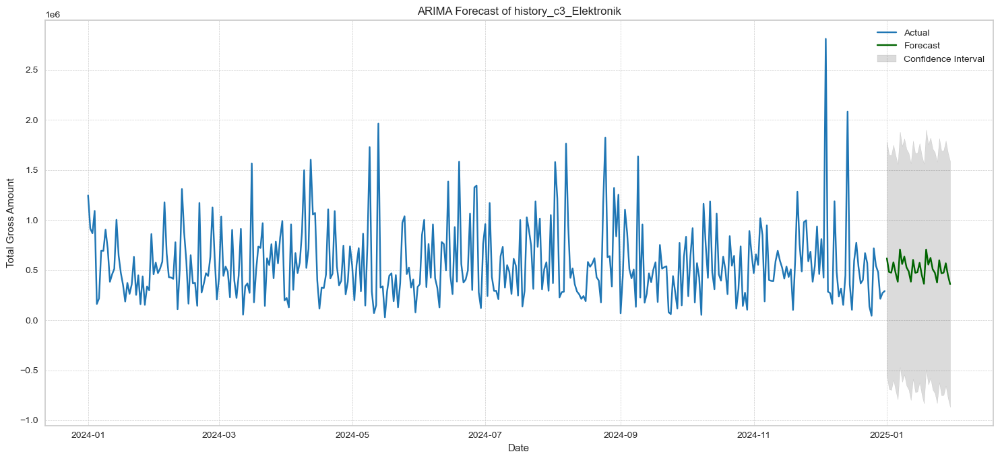


Best model:  ARIMA(2,1,2)(0,1,1)[12]          
Total fit time: 8.139 seconds


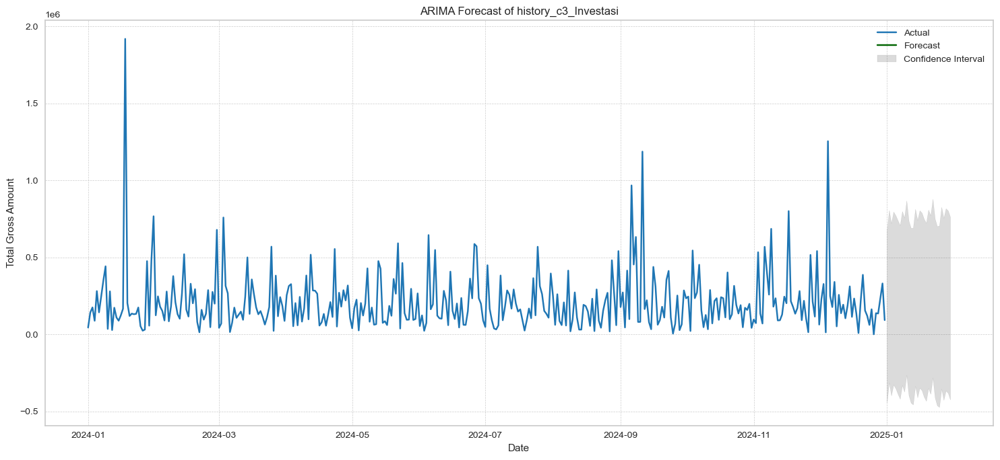


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 6.795 seconds


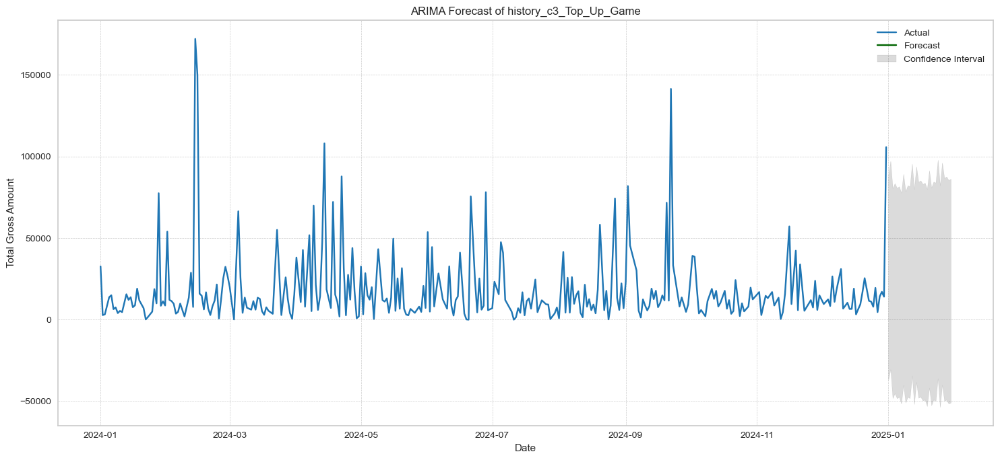


Best model:  ARIMA(0,1,2)(1,1,1)[12]          
Total fit time: 8.912 seconds


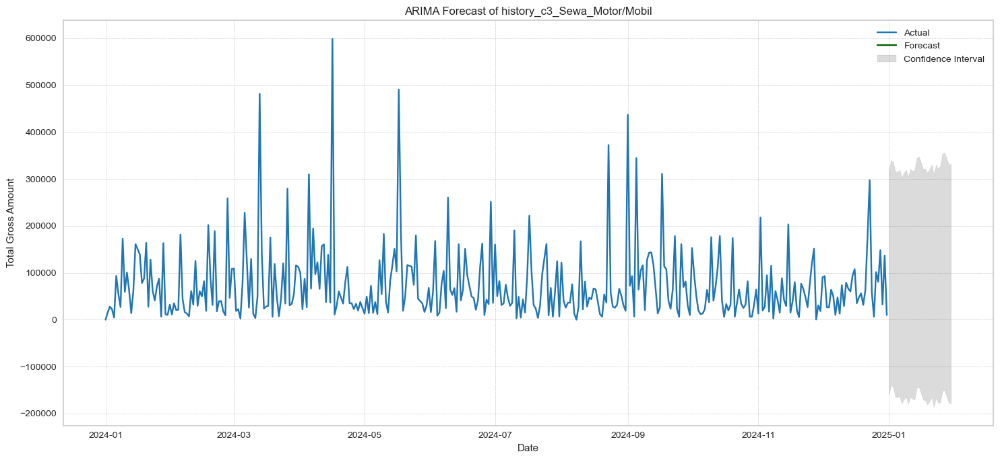


Best model:  ARIMA(2,1,2)(0,1,1)[12]          
Total fit time: 8.008 seconds


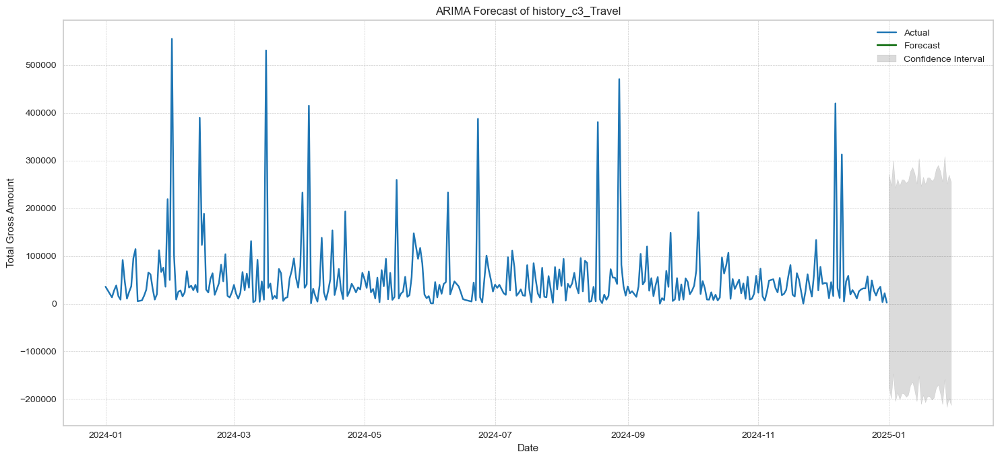


Best model:  ARIMA(2,1,2)(0,1,1)[12]          
Total fit time: 8.442 seconds


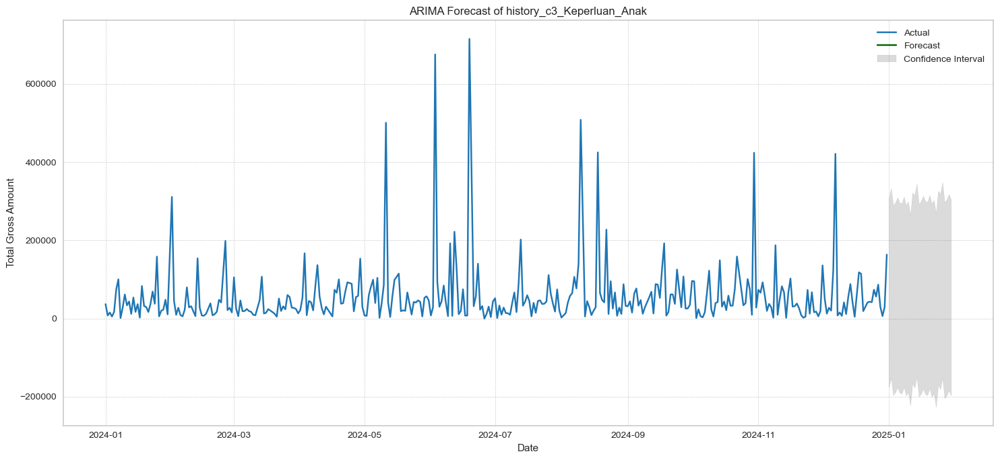


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 7.692 seconds


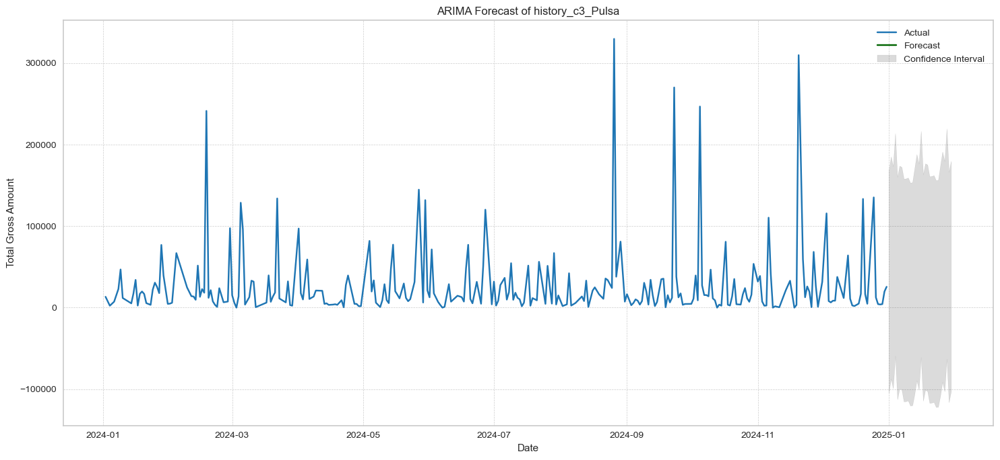


Best model:  ARIMA(0,1,3)(1,1,1)[12]          
Total fit time: 4.466 seconds


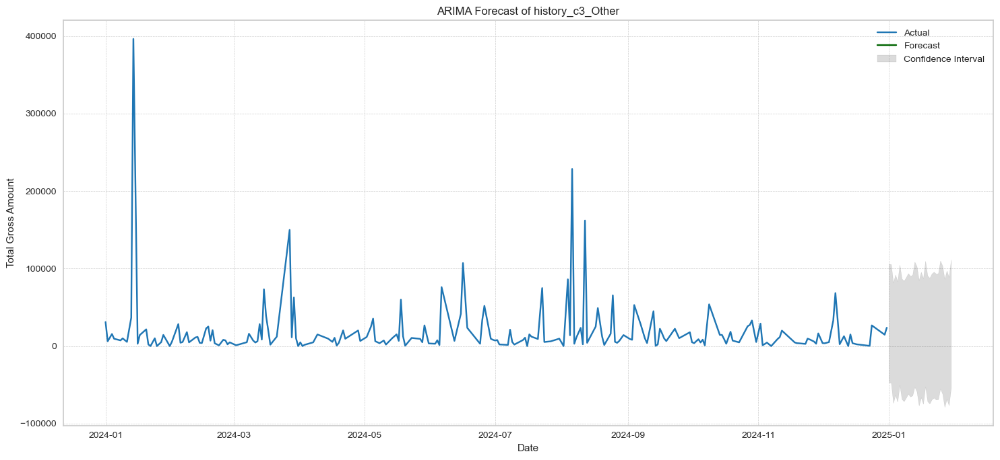


Best model:  ARIMA(1,1,2)(2,1,0)[12]          
Total fit time: 7.625 seconds


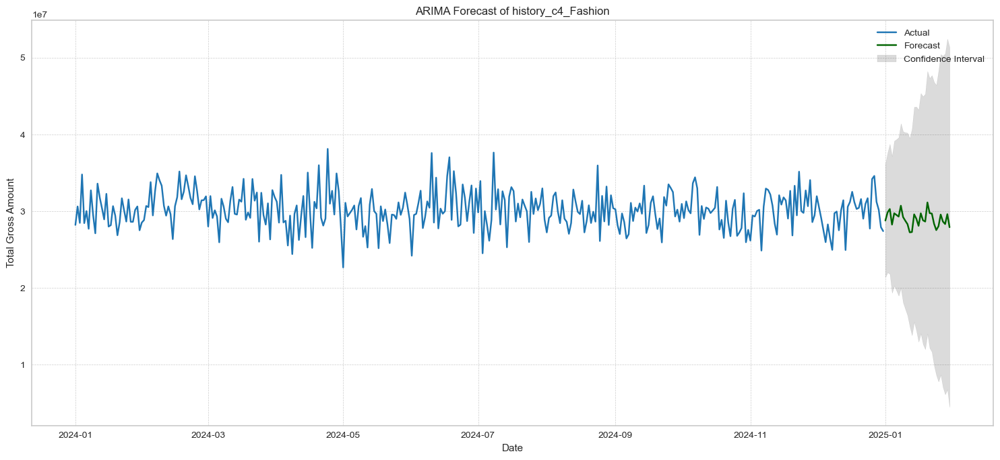


Best model:  ARIMA(0,1,1)(0,1,2)[12]          
Total fit time: 8.335 seconds


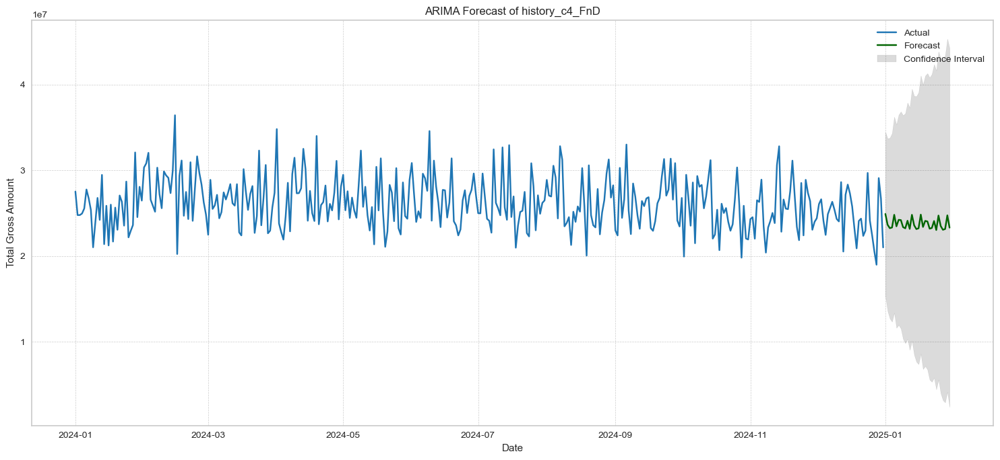


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 8.710 seconds


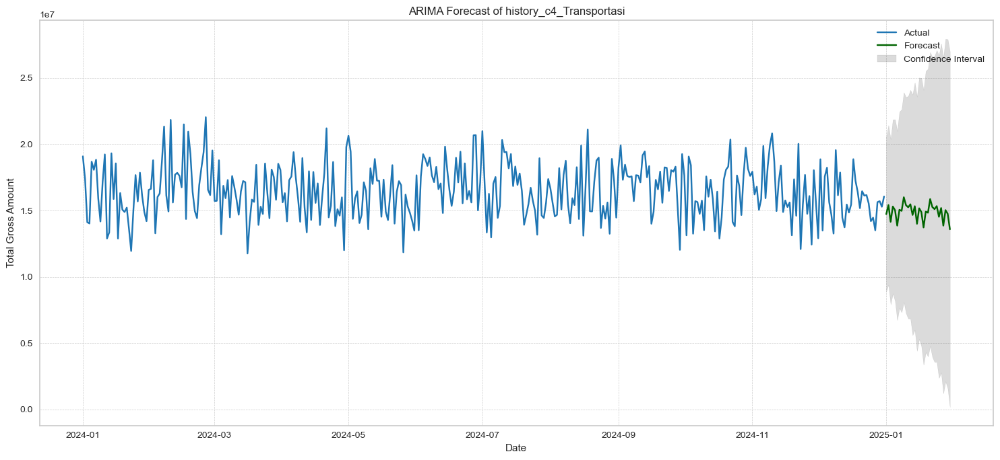


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 8.239 seconds


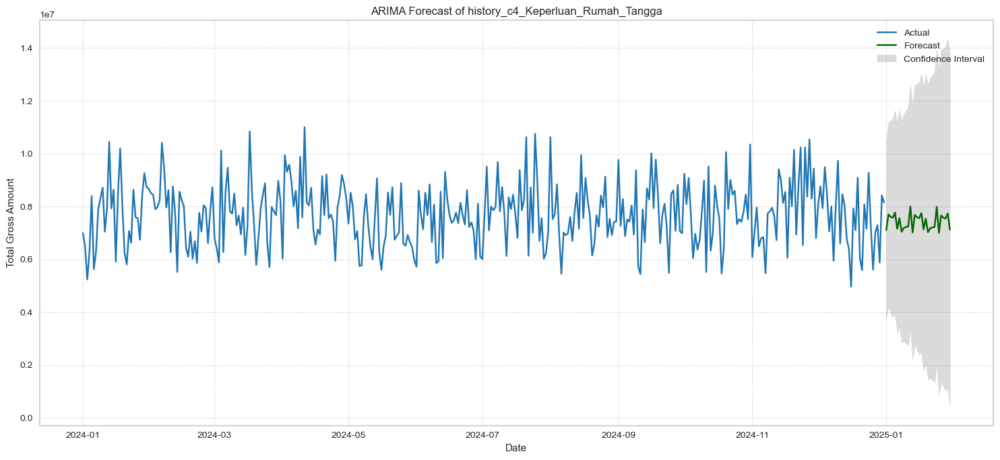


Best model:  ARIMA(0,1,1)(1,1,0)[12]          
Total fit time: 8.299 seconds


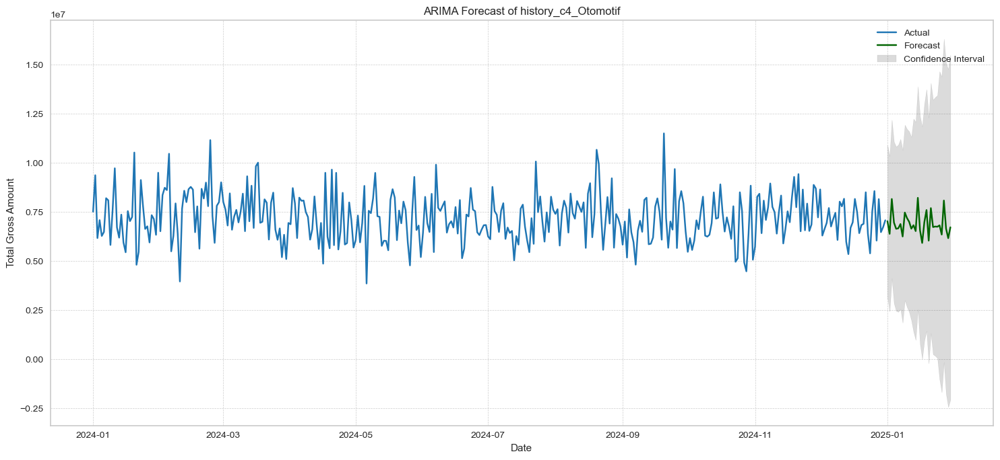


Best model:  ARIMA(0,1,3)(0,1,2)[12]          
Total fit time: 9.354 seconds


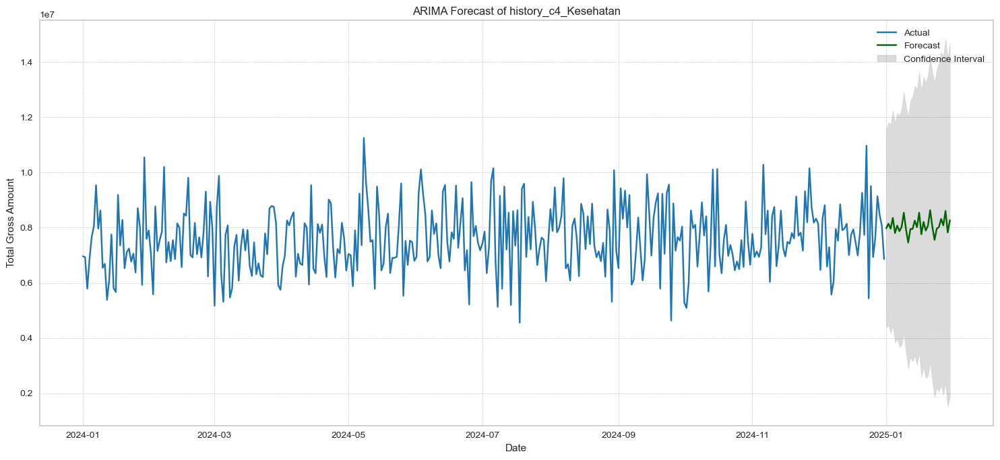


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 7.902 seconds


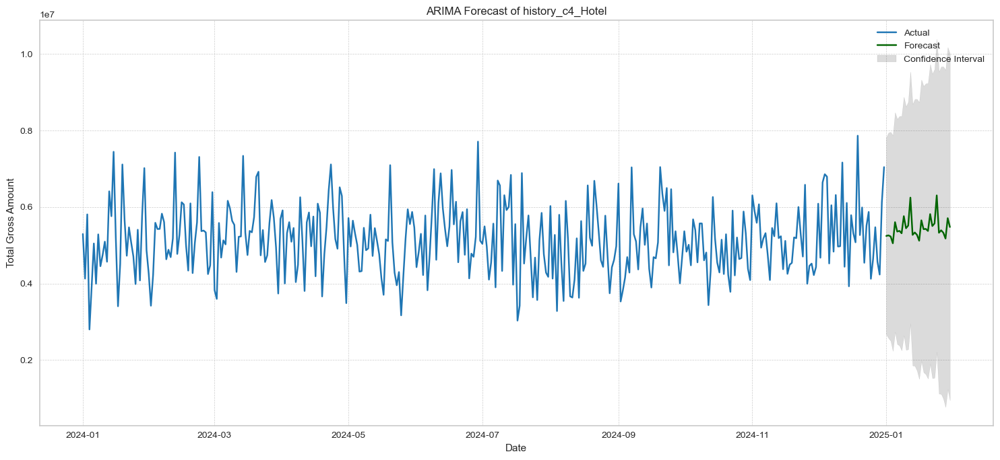


Best model:  ARIMA(2,1,2)(0,1,1)[12]          
Total fit time: 7.995 seconds


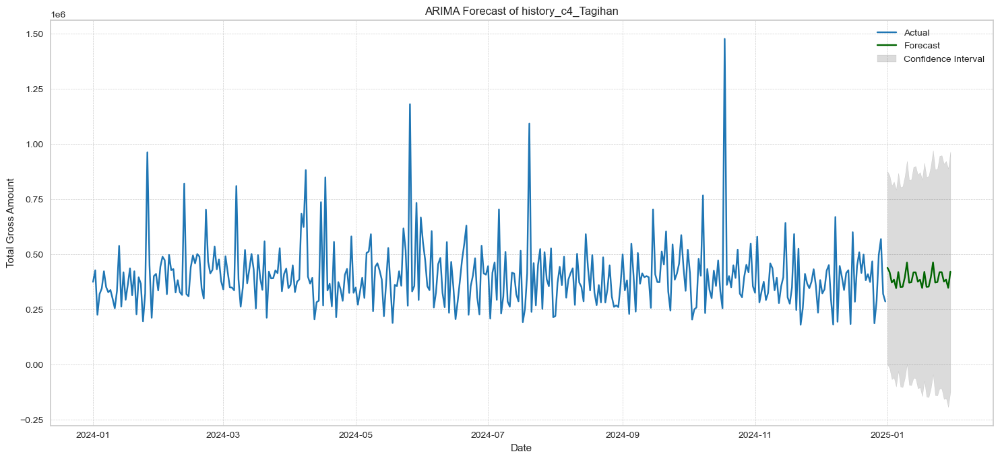


Best model:  ARIMA(1,1,2)(2,1,0)[12]          
Total fit time: 7.586 seconds


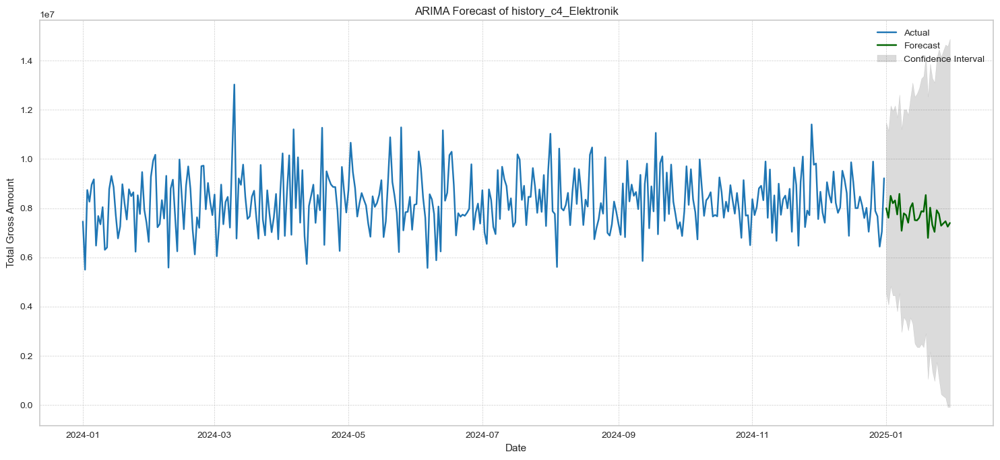


Best model:  ARIMA(0,1,2)(1,1,1)[12]          
Total fit time: 10.068 seconds


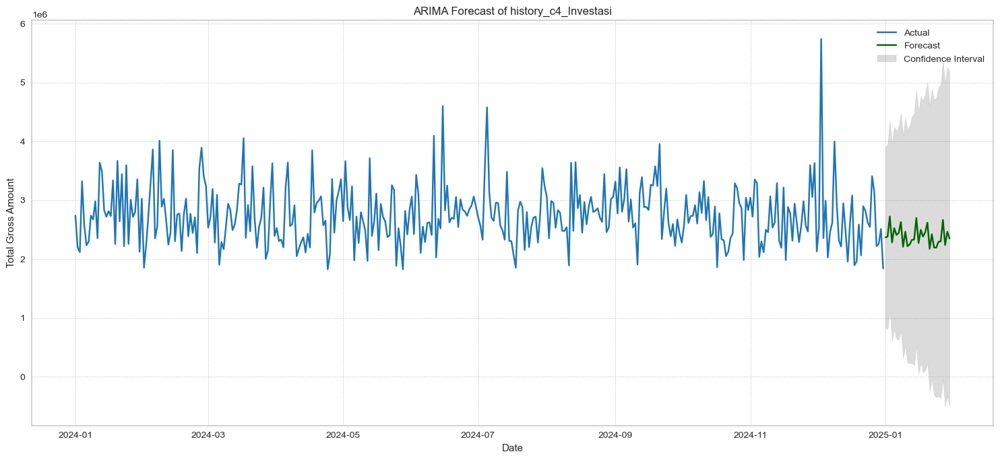


Best model:  ARIMA(1,1,2)(2,1,0)[12]          
Total fit time: 7.755 seconds


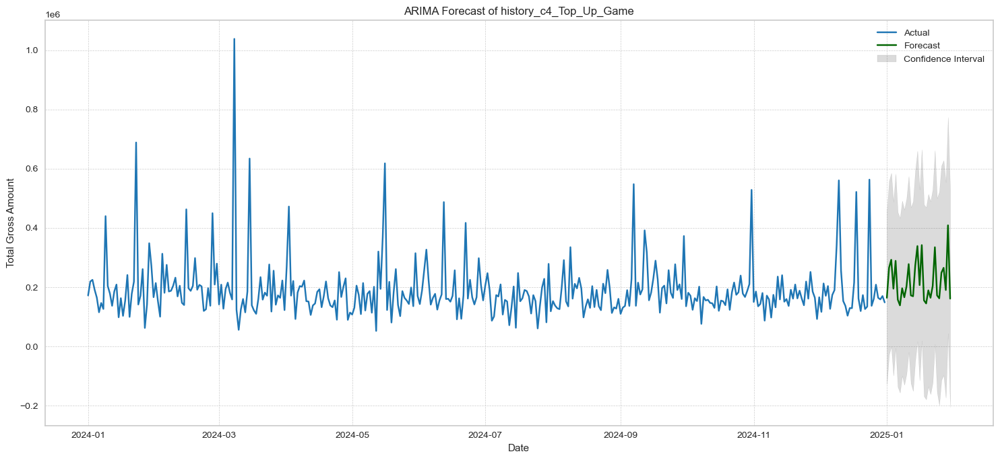


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 9.712 seconds


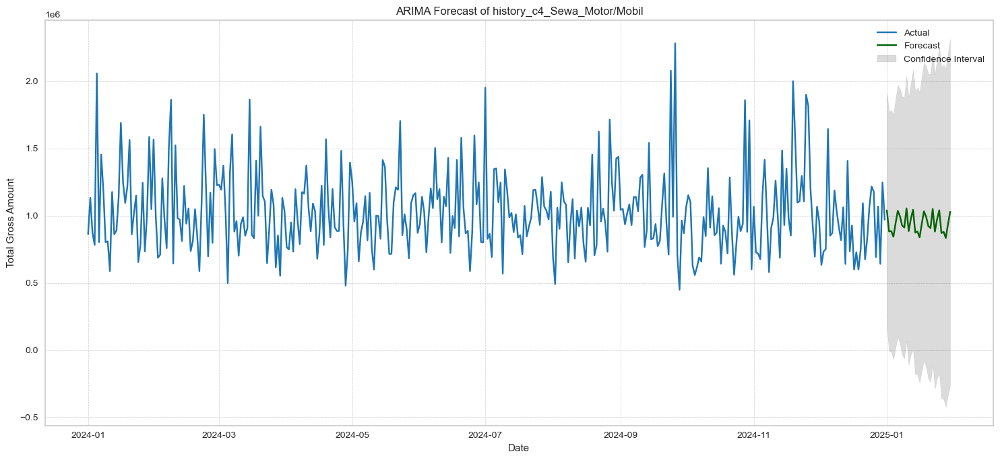


Best model:  ARIMA(0,1,3)(1,1,1)[12]          
Total fit time: 7.743 seconds


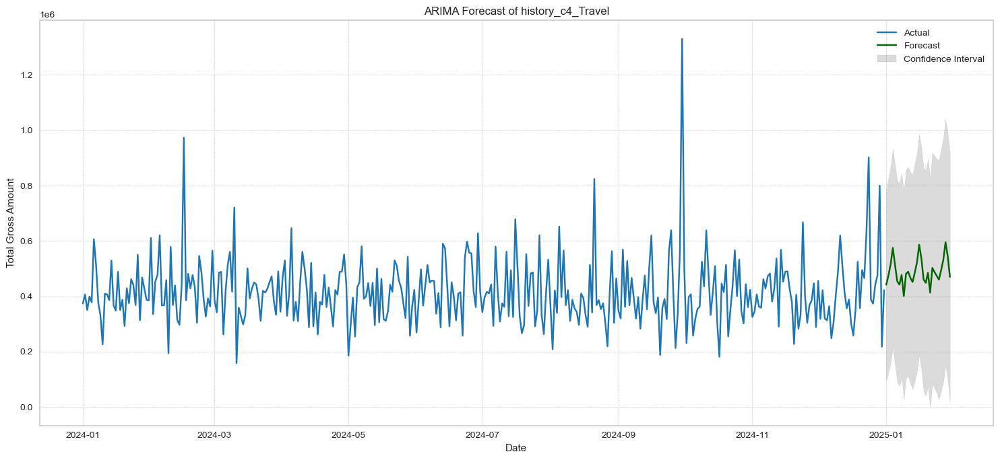


Best model:  ARIMA(1,1,3)(0,1,1)[12]          
Total fit time: 8.313 seconds


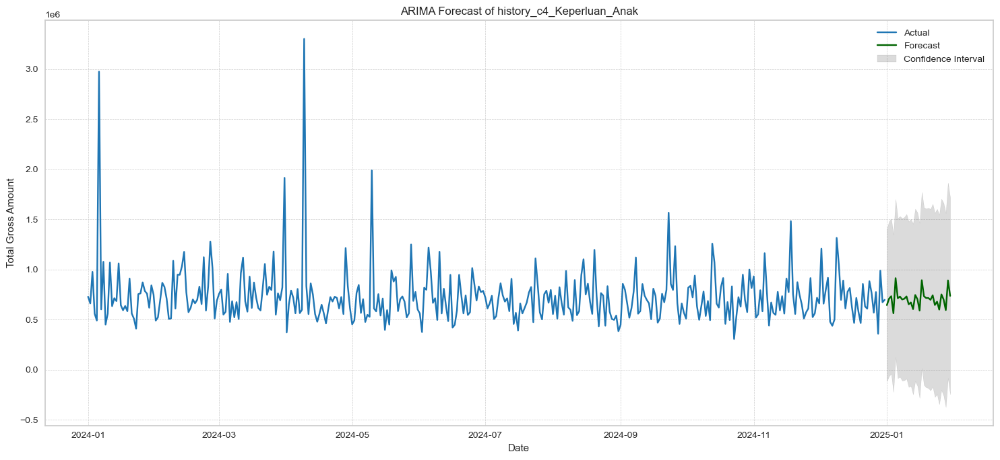


Best model:  ARIMA(0,1,3)(0,1,2)[12]          
Total fit time: 7.529 seconds


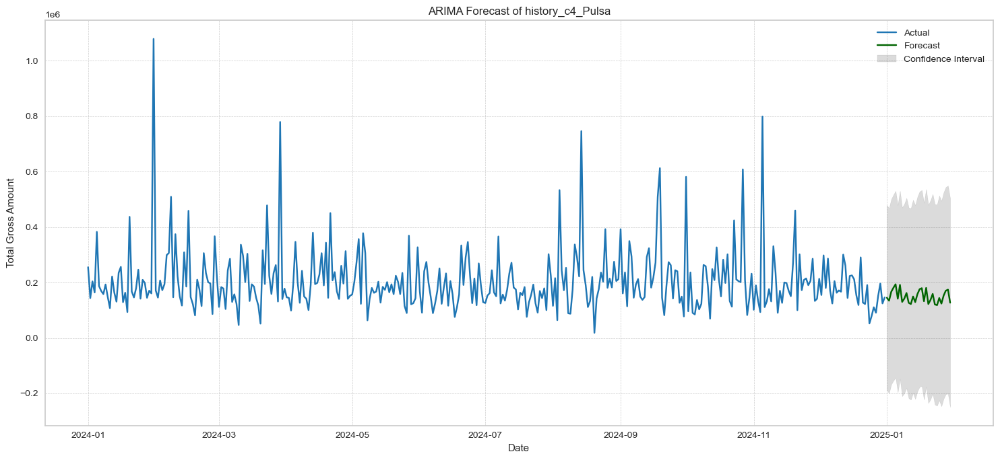


Best model:  ARIMA(0,1,1)(0,1,2)[12]          
Total fit time: 6.955 seconds


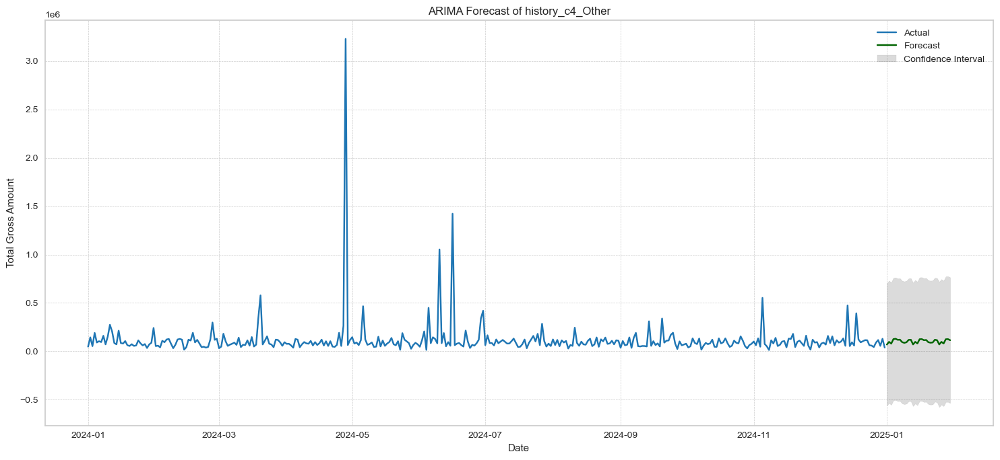

In [222]:
import pmdarima as pm

for name, df in assignments.items():
    ARIMA_model = pm.auto_arima(df['total_gross_amount'], start_p=1, start_q=1, max_p=3, max_q=3, m=12,
                             start_P=0, seasonal=True, d=1, D=1, trace=True,
                             n_jobs=-1,
                             error_action='ignore',  # don't want to know if an order does not work
                             suppress_warnings=True,  # don't want convergence warnings
                             stepwise=False, random=True, random_state=42, n_fits=25)
    
    fitted, confint = ARIMA_model.predict(n_periods=30, return_conf_int=True)  # Change to 30 for a month

    # Create date index for forecast (assuming daily data)
    future_dates = pd.date_range(df.index[-1] + pd.DateOffset(days=1), periods=30, freq='D')

    # Create time series for plotting
    fitted_series = pd.Series(fitted, index=future_dates)
    lower_series = pd.Series(confint[:, 0], index=future_dates)
    upper_series = pd.Series(confint[:, 1], index=future_dates)

    # Enhanced plot with clear labels and annotations
    plt.figure(figsize=(15, 7))
    plt.plot(df["total_gross_amount"], color='#1f76b4', label='Actual')
    plt.plot(fitted_series, color='darkgreen', label='Forecast')
    plt.fill_between(lower_series.index, lower_series, upper_series, color='k', alpha=0.15, label='Confidence Interval')

    plt.title(f"ARIMA Forecast of {name}")
    plt.xlabel('Date')
    plt.ylabel('Total Gross Amount')
    plt.legend()  # Show labels in the plot

    # Grid lines for better readability
    plt.grid(True, linestyle='--', linewidth=0.5)

    plt.tight_layout()  # Adjust spacing for clarity
    plt.show()

In [ ]:
# assignments_split_train_x = {}
# assignments_split_train_y = {}
# assignments_split_test_x = {}
# assignments_split_test_y = {}

# for (split_name_train, data_train), (split_name_test, data_test) in zip(assignments_split_train.items(), assignments_split_test.items()):
  
#   train_features_name = f"x_{split_name_train}"
#   train_target_name = f"y_{split_name_train}"
#   test_features_name = f"x_{split_name_test}"
#   test_target_name = f"y_{split_name_test}"

#   train_features, train_target = data_train, data_train.pop('total_gross_amount')
#   test_features, test_target = data_test, data_test.pop('total_gross_amount')

#   assignments_split_train_x[train_features_name] = train_features
#   assignments_split_train_y[train_target_name] = train_target
#   assignments_split_test_x[test_features_name] = test_features
#   assignments_split_test_y[test_target_name] = test_target

In [ ]:
# def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
#     n_vars = 1 if type(data) is list else data.shape[1]
#     df = pd.DataFrame(data)
#     cols, names = list(), list()
#     # input sequence (t-n, ... t-1)
#     for i in range(n_in, 0, -1):
#         cols.append(df.shift(i))
#         names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
#     # forecast sequence (t, t+1, ... t+n)
#     for i in range(0, n_out):
#         cols.append(df.shift(-i))
#         if i == 0:
#             names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
#         else:
#             names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
#     # put it all together
#     agg = pd.concat(cols, axis=1)
#     agg.columns = names
#     # drop rows with NaN values
#     if dropnan:
#         agg.dropna(inplace=True)
#     return agg

In [ ]:
# from sklearn.preprocessing import MinMaxScaler

# processed_data = {}
# processed_data_a = {}

# for variable_name, df in assignments.items():
#   df.reset_index(drop=True, inplace=True)
  
#   # Extract values from the DataFrame
#   date_trans = df['transaction_date']
#   value = df.drop(columns=['transaction_date'])

#   values = value.values

#   # Ensure all data is float
#   values = values.astype('float32')

#   # Normalize features
#   to_scale = values.copy()
#   scaler = MinMaxScaler(feature_range=(0, 1))
#   scaled = scaler.fit_transform(to_scale)

#   # Frame as supervised learning (assuming series_to_supervised is your custom function)
#   reframed = series_to_supervised(scaled, 1, 1)
#   reframed_a = series_to_supervised(scaled, 31, 1)

#   date_trans.reset_index(drop=True, inplace=True)
#   reframed['transaction_date'] = date_trans
#   reframed_a['transaction_date'] = date_trans

#   reframed.drop(reframed.columns[9:18], axis=1, inplace=True)

#   processed_data[variable_name] = reframed
#   processed_data_a[variable_name] = reframed_a


In [ ]:
# assignments_split_train = {}
# assignments_split_test = {}

# for variable_name, df in processed_data.items():
#   variable_name_split_train = f"train_set_{variable_name}"
#   variable_name_split_test = f"test_set_{variable_name}"
#   assignments_split_train[variable_name_split_train] = df[df['transaction_date'].dt.month < 11]
#   assignments_split_test[variable_name_split_test] = df[df['transaction_date'].dt.month >= 11]
#   assignments_split_train[variable_name_split_train].drop(columns=['transaction_date'], inplace=True)
#   assignments_split_test[variable_name_split_test].drop(columns=['transaction_date'], inplace=True)
  

In [ ]:
# assignments_split_train_x = {}
# assignments_split_train_y = {}
# assignments_split_train_x_cnn = {}
# assignments_split_test_x_cnn = {}
# assignments_split_test_x = {}
# assignments_split_test_y = {}

# for (split_name_train, data_train), (split_name_test, data_test) in zip(assignments_split_train.items(), assignments_split_test.items()):
#   data_train = data_train.values
#   data_test = data_test.values
  
#   train_features_name = f"x_{split_name_train}"
#   train_target_name = f"y_{split_name_train}"
#   test_features_name = f"x_{split_name_test}"
#   test_target_name = f"y_{split_name_test}"

#   # Separate features and target from data
#   train_features, train_target = data_train[:, :-1], data_train[:, -1]
#   test_features, test_target = data_test[:, :-1], data_test[:, -1]

#   assignments_split_train_x[train_features_name] = train_features
#   assignments_split_train_y[train_target_name] = train_target
#   assignments_split_test_x[test_features_name] = test_features
#   assignments_split_test_y[test_target_name] = test_target

#   # Reshape for LSTM (optional, comment out if not needed)
#   assignments_split_train_x[train_features_name] = assignments_split_train_x[train_features_name].reshape((assignments_split_train_x[train_features_name].shape[0], 1, assignments_split_train_x[train_features_name].shape[1]))
#   assignments_split_test_x[test_features_name] = assignments_split_test_x[test_features_name].reshape((assignments_split_test_x[test_features_name].shape[0], 1, assignments_split_test_x[test_features_name].shape[1]))

#   # for CNN
#   assignments_split_train_x_cnn[train_features_name] = train_features.reshape((train_features.shape[0], train_features.shape[1], 1))
#   assignments_split_test_x_cnn[test_features_name] = test_features.reshape((test_features.shape[0], test_features.shape[1], 1))

In [ ]:
# def predict_out_of_sample(model, test_features, n_steps):
#   # Create a list to store predictions
#   predictions = [None for _ in range(n_steps)]

#   # Get the first n steps from test features (assuming n_steps is the lookback window)
#   first_n_steps = test_features[:n_steps]

#   # Make predictions in a loop
#   for i in range(n_steps, n_steps + len(test_features)):
#     # Reshape the current window for prediction (fix the error)
#     current_window = first_n_steps[i-n_steps:i].reshape((1, 1, current_window.shape[1]))
#     # Predict using the model
#     prediction = model.predict(current_window)[0][0]
#     # Append prediction to the list
#     predictions.append(prediction)
#     # Shift the window by 1 step (add new prediction and remove the oldest one)
#     first_n_steps = np.append(first_n_steps[1:], prediction)
  
#   return np.array(predictions)


In [ ]:
# from sklearn.metrics import mean_squared_error

# assignments_fit_train = {}

# for (train_features_name, train_features), (train_target_name, train_target), (test_features_name, test_features), (test_target_name, test_target) in zip(assignments_split_train_x.items(), assignments_split_train_y.items(), assignments_split_test_x.items(), assignments_split_test_y.items()):
#   model = Sequential()
#   model.add(LSTM(20, input_shape=(train_features.shape[1], train_features.shape[2])))
#   model.add(Dense(1))
#   model.compile(loss='mse', optimizer='adam')

#   early_stopping = EarlyStopping(monitor='val_loss', patience=10, verbose=1, mode='min', restore_best_weights= True)  # Monitor validation loss

#   # Train the model with EarlyStopping
#   history = model.fit(train_features, train_target, epochs=500, batch_size=25, validation_data=(test_features, test_target), verbose=2, shuffle=False, callbacks=[early_stopping])

#   model_title = f'Split:_{train_features_name}_-_Target:_{train_target_name}'
#   assignments_fit_train[model_title] = history
  
#   yhat = model.predict(test_features)
#   # oot = model.predict(future)
#   test_features = test_features.reshape((test_features.shape[0], test_features.shape[2]))

#   n_steps = test_features.shape[1]  # Assuming the lookback window is the last n elements
#   out_of_sample_predictions = predict_out_of_sample(model, test_features[-n_steps:], n_steps)
#   # out_of_sample_predictions = predict_out_of_sample(model, test_features, 31)

#   # # Prepare data for visualization (assuming test_target and out-of-sample_predictions have the same length)
#   # ground_truth = test_target[-31:]
#   predicted_values = out_of_sample_predictions

#   values = test_features.copy()

#   # Ensure all data is float
#   values = values.astype('float32')

#   # Normalize features
#   to_scale = values.copy()
#   scaler = MinMaxScaler(feature_range=(0, 1))
#   scaler.fit_transform(to_scale)

#   # Invert scaling for forecast and actual values
#   inv_yhat = np.concatenate((yhat, test_features[:, 1:]), axis=1)  # Assuming test_X is available within the loop
#   inv_yhat = scaler.inverse_transform(inv_yhat)
#   inv_yhat = inv_yhat[:, 0]

#   test_target = test_target.reshape((len(test_target), 1))
#   inv_y = np.concatenate((test_target, test_features[:, 1:]), axis=1)
#   inv_y = scaler.inverse_transform(inv_y)
#   inv_y = inv_y[:, 0]

#   # Calculate RMSE
#   rmse = np.sqrt(mean_squared_error(inv_y, inv_yhat))

#   # Create a figure with 2 subplots (1 row, 2 columns) with adjusted size
#   fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 6))  # Set figure size

#   # Plot training and validation loss on the first subplot
#   ax1.plot(history.history['loss'], label='train')
#   ax1.plot(history.history['val_loss'], label='test')
#   ax1.set_title('Training and Validation Loss')
#   ax1.legend()

#   # Make predictions and plot on the second subplot
#   # ax2.plot(ground_truth, label="Actual")
#   ax2.plot(predicted_values, label="Predicted (Out-of-Sample)")
#   ax2.plot(test_target, label="original")
#   ax2.plot(yhat, label="predict")

#   # Display RMSE (choose your preference)
#   ax2.set_title(f'Actual vs Predicted Values LSTM {test_target_name}')  # Option 1: Title with RMSE
#   ax2.text(0.9, 0.05, f'RMSE: {rmse:.4f}', ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.5), fontsize=10)  

#   ax2.legend()

#   # Adjust layout to prevent overlapping elements
#   plt.subplots_adjust(left=0.05, right=0.95, wspace=0.1)  # Adjust spacing between subplots

#   plt.show()

In [ ]:
# from tensorflow.keras.layers import Conv1D, MaxPooling1D, Flatten, Dense

# assignments_fit_train_cnn = {}

# for (train_features_name, train_features), (train_target_name, train_target), (test_features_name, test_features), (test_target_name, test_target) in zip(assignments_split_train_x_cnn.items(), assignments_split_train_y.items(), assignments_split_test_x_cnn.items(), assignments_split_test_y.items()):

#   # Define CNN model
#   model_cnn = Sequential()
#   model_cnn.add(Conv1D(filters=64, kernel_size=2, activation='relu', input_shape=(train_features.shape[1], train_features.shape[2])))
#   model_cnn.add(MaxPooling1D(pool_size=2))
#   model_cnn.add(Flatten())  # Flatten for dense layers
#   model_cnn.add(Dense(32, activation='relu'))
#   model_cnn.add(Dense(1))
#   model_cnn.compile(loss='mse', optimizer='adam')

#   early_stopping = EarlyStopping(monitor='val_loss', patience=10, verbose=1, mode='min', restore_best_weights= True)  # Monitor validation loss

#   # Train the model with EarlyStopping
#   history_cnn = model_cnn.fit(train_features, train_target, epochs=100, batch_size=25, validation_data=(test_features, test_target), verbose=0, callbacks=[early_stopping])

#   # Store model history
#   model_title_cnn = f'Split:_{train_features_name}_-_Target:_{train_target_name}'
#   assignments_fit_train_cnn[model_title_cnn] = history_cnn

#   # Create plots
#   fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 6))  # Set figure size

#   # Plot training and validation loss
#   ax1.plot(history_cnn.history['loss'], label='train')
#   ax1.plot(history_cnn.history['val_loss'], label='test')
#   ax1.set_title('Training and Validation Loss')
#   ax1.legend()

#   # Make predictions and plot
#   yhat = model_cnn.predict(test_features)
#   test_features_reshaped = test_features.reshape((test_features.shape[0], test_features.shape[1] * test_features.shape[2]))  # Assuming desired shape
#   ax2.plot(test_target, label="original")
#   ax2.plot(yhat, label="predict")

#   # Calculate RMSE
#   rmse = np.sqrt(mean_squared_error(test_target, yhat))

#   # Display RMSE (choose your preference)
#   ax2.set_title(f'Actual vs Predicted Values CNN {test_target_name}')  # Option 1: Title with RMSE
#   ax2.text(0.9, 0.05, f'RMSE: {rmse:.4f}', ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.5), fontsize=10)  

#   ax2.legend()

#   # Adjust layout to prevent overlapping elements
#   plt.subplots_adjust(left=0.05, right=0.95, wspace=0.1)  # Adjust spacing between subplots

#   plt.show()